## shNfkb1-lane1
7/18/23 - Data generated from shNfkb1 single hairpin experiments; included hairpin library; data submitted by Jason/Carleigh/Hannah on 2/2/2023
Run on 2 lanes but partially clogged on lane 1 so '3' lanes (lane1, lane1_rerun, lane2)
Analyze global run on cellranger v6 data and create h5_ad files for further analysis

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib

from solo import hashsolo
import anndata

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.22.4 scipy==1.9.0 pandas==1.4.3 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.9.11 pynndescent==0.5.7


In [3]:
results_file = 'write/allmice_lane1.h5ad'  # the file that will store the analysis results

Read in the count matrix into an [`AnnData`](https://anndata.readthedocs.io/en/latest/anndata.AnnData.html) object, which holds many slots for annotations and different representations of the data. It also comes with its own HDF5 file format: `.h5ad`.

In [4]:
adata = sc.read_10x_h5('data_library/filtered_feature_bc_matrix_lane1.h5', gex_only=False)

reading data_library/filtered_feature_bc_matrix_lane1.h5
 (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [5]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [6]:
samples = list(adata[:,adata.var['feature_types']=='Antibody Capture'].var.index)

In [7]:
print(samples)

['AT1939_B0301_Renilla', 'AT1940_B0302_Renilla', 'AT1944_B0303_2117', 'AT1129_B0304_2117', 'AT1606_B0305_Renilla', 'AT1831_B0306_2117', 'AT1607_B0307_Renilla', 'BA1525_B0308_2118', 'BA1526_B0309_2118', 'AV1189_B0310_2118']


In [8]:
# Now filter out barcodes
hashadata = adata[:,samples]
adata = adata[:,[y for y in adata.var_names if y not in samples]]

In [9]:
hashadata.var

,gene_ids,feature_types,genome
AT1939_B0301_Renilla,AT1939_B0301_Renilla,Antibody Capture,
AT1940_B0302_Renilla,AT1940_B0302_Renilla,Antibody Capture,
AT1944_B0303_2117,AT1944_B0303_2117,Antibody Capture,
AT1129_B0304_2117,AT1129_B0304_2117,Antibody Capture,
AT1606_B0305_Renilla,AT1606_B0305_Renilla,Antibody Capture,
AT1831_B0306_2117,AT1831_B0306_2117,Antibody Capture,
AT1607_B0307_Renilla,AT1607_B0307_Renilla,Antibody Capture,
BA1525_B0308_2118,BA1525_B0308_2118,Antibody Capture,
BA1526_B0309_2118,BA1526_B0309_2118,Antibody Capture,
AV1189_B0310_2118,AV1189_B0310_2118,Antibody Capture,


## Preprocessing

Show those genes that yield the highest fraction of counts in each single cell, across all cells.

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


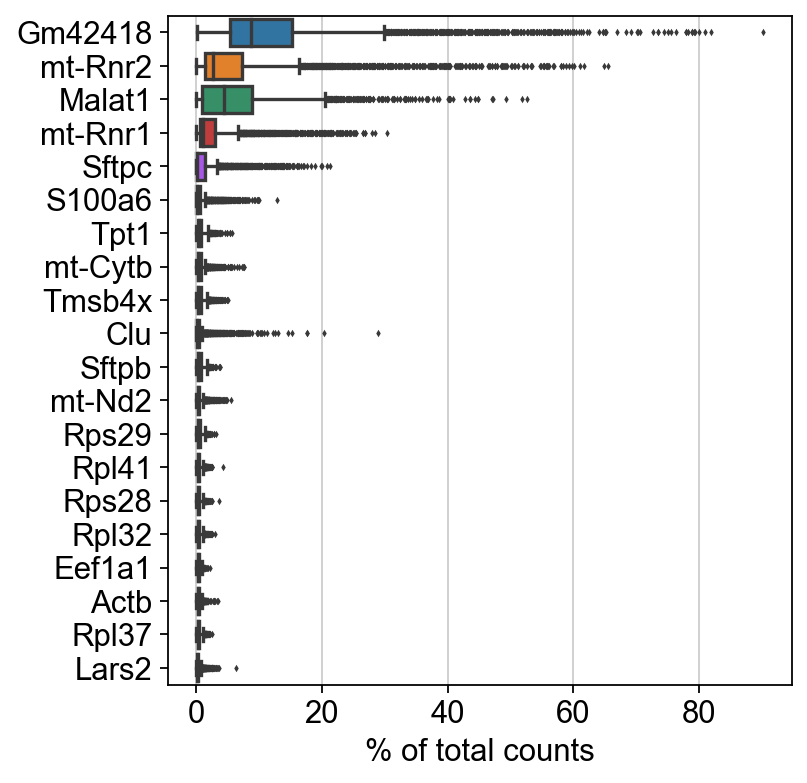

In [10]:
sc.pl.highest_expr_genes(adata, n_top=20, )

Basic filtering:

In [11]:
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)
#sc.pp.filter_cells(adata, min_counts=1500)

filtered out 132 cells that have less than 300 genes expressed
filtered out 30737 genes that are detected in less than 3 cells


Let's assemble some information about mitochondrial genes, which are important for quality control.

Citing from "Simple Single Cell" workflows [(Lun, McCarthy & Marioni, 2017)](https://master.bioconductor.org/packages/release/workflows/html/simpleSingleCell.html#examining-gene-level-metrics):

> High proportions are indicative of poor-quality cells (Islam et al. 2014; Ilicic et al. 2016), possibly because of loss of cytoplasmic RNA from perforated cells. The reasoning is that mitochondria are larger than individual transcript molecules and less likely to escape through tears in the cell membrane.

With `pp.calculate_qc_metrics`, we can compute many metrics very efficiently.

In [12]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

A violin plot of some of the computed quality measures:

* the number of genes expressed in the count matrix
* the total counts per cell
* the percentage of counts in mitochondrial genes

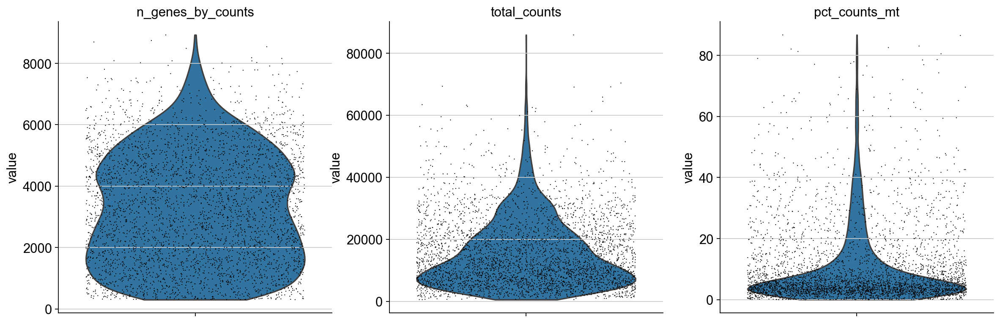

In [13]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

(array([   9.,   18.,   45.,  109.,  286.,  748., 1944.,  651.,   55.,
          12.]),
 array([0.63998945, 0.67231934, 0.70464922, 0.73697911, 0.769309  ,
        0.80163888, 0.83396877, 0.86629865, 0.89862854, 0.93095843,
        0.96328831]),
 <BarContainer object of 10 artists>)

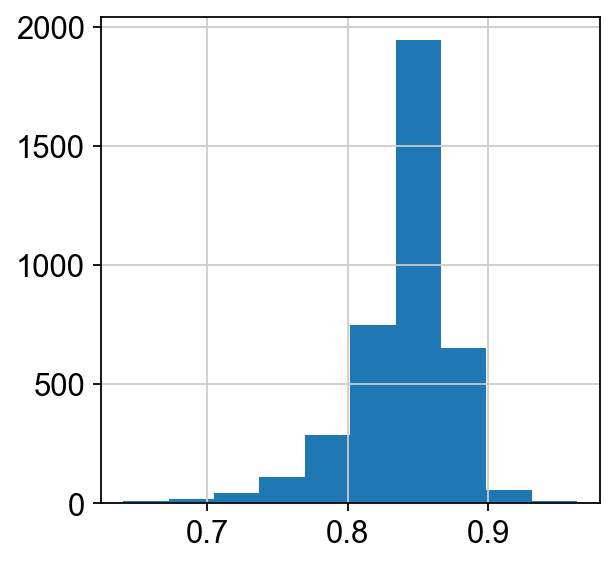

In [14]:
adata.obs["log10GenesPerUMI"] = adata.obs['n_genes_by_counts'].apply(math.log10) / adata.obs['total_counts'].apply(math.log10)
matplotlib.pyplot.hist(adata.obs["log10GenesPerUMI"])

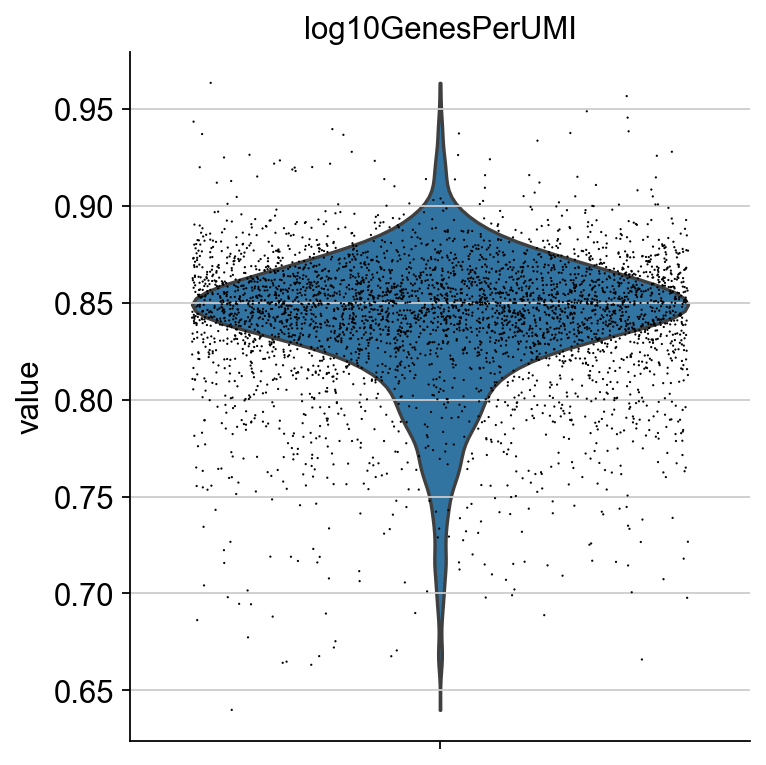

In [15]:
sc.pl.violin(adata, ['log10GenesPerUMI'],
             jitter=0.4, multi_panel=True, rotation=90)
#99% seems like a good Human pct count cutoff

Keep singlets, remove cells that have too many mouse reads, or mitochondrial genes expressed or too many total counts:

In [16]:
#Filter by Log10GenesPerUMI
adata = adata[adata.obs.log10GenesPerUMI >= 0.8,:]

In [17]:
#adata = adata[adata.obs.n_genes_by_counts < 2500, :]
adata = adata[adata.obs.pct_counts_mt <= 10, :]

In [18]:
hashadata = hashadata[hashadata.obs.index.isin(adata.obs.index), :]

In [19]:
hashadata.var_names

Index(['AT1939_B0301_Renilla', 'AT1940_B0302_Renilla', 'AT1944_B0303_2117',
       'AT1129_B0304_2117', 'AT1606_B0305_Renilla', 'AT1831_B0306_2117',
       'AT1607_B0307_Renilla', 'BA1525_B0308_2118', 'BA1526_B0309_2118',
       'AV1189_B0310_2118'],
      dtype='object')

In [20]:
hashadata.write_h5ad("write/hashes_lane1.h5ad",force_dense=True, compression='gzip')
cell_hashing_data = anndata.read("write/hashes_lane1.h5ad")
hashsolo.hashsolo(cell_hashing_data) #parameter is by default n-2 (doesn't work if only 2 barcodes, so set to 1)

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/anndata/_io/h5ad.py:46: FutureWarning: The `force_dense` argument is deprecated. Use `as_dense` instead.
  warn(
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


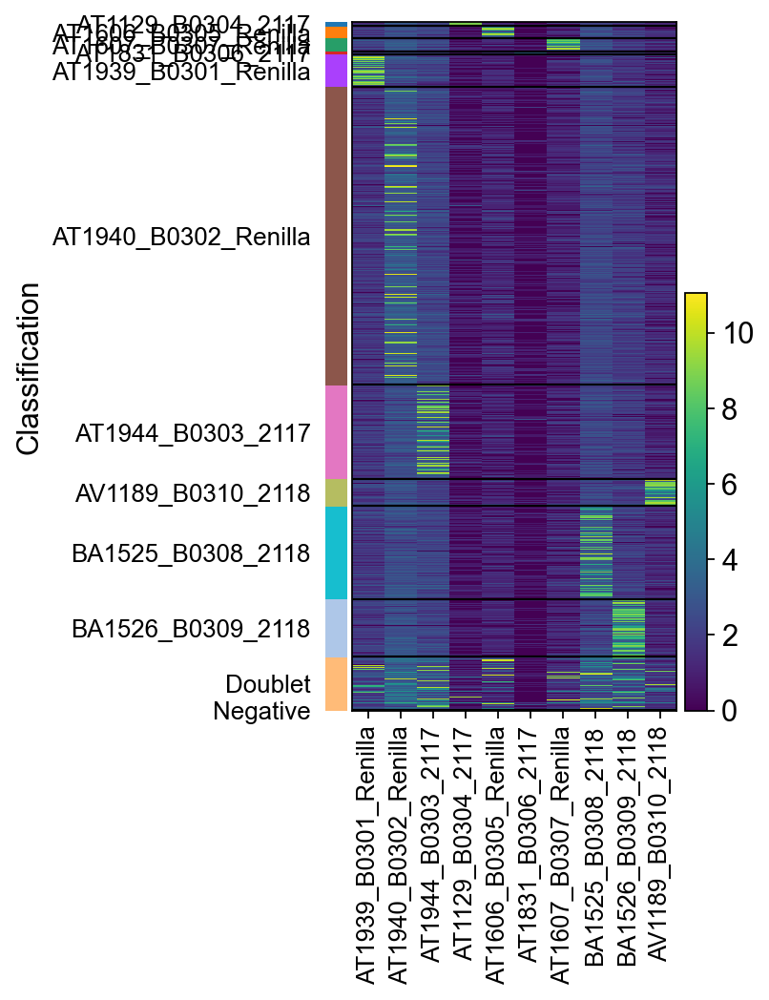

In [21]:
sc.pl.heatmap(cell_hashing_data, samples,groupby="Classification",log=True)

In [22]:
hashCounts = pd.DataFrame(hashadata.X.todense(), columns=hashadata.var_names, index=adata.obs.index)

In [23]:
hashDisc = hashCounts.describe([.1,.2,.3,.4,.5,.6,.7,.8,.9,0.99,0.999])
hashDisc

,AT1939_B0301_Renilla,AT1940_B0302_Renilla,AT1944_B0303_2117,AT1129_B0304_2117,AT1606_B0305_Renilla,AT1831_B0306_2117,AT1607_B0307_Renilla,BA1525_B0308_2118,BA1526_B0309_2118,AV1189_B0310_2118
count,2534.000000,2534.000000,2534.000000,2534.000000,2534.000000,2534.000000,2534.000000,2534.000000,2534.000000,2534.000000
mean,310.739532,769.043823,792.801086,56.837807,179.201263,20.192976,140.840179,302.771912,346.395813,186.904495
std,2136.650635,4120.510742,3901.989014,762.960022,1958.237671,459.685272,1364.486328,1973.105225,1657.309082,1440.957764
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10%,2.000000,8.000000,4.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2.000000,0.000000
20%,3.000000,11.000000,6.000000,0.000000,1.000000,0.000000,1.000000,6.000000,3.000000,1.000000
30%,4.000000,13.000000,7.000000,0.000000,1.000000,0.000000,1.000000,8.000000,4.000000,2.000000
40%,4.000000,15.000000,9.000000,1.000000,2.000000,0.000000,2.000000,9.000000,5.000000,2.000000
50%,5.000000,17.000000,10.000000,1.000000,2.000000,0.000000,2.000000,10.000000,6.000000,3.000000
60%,6.000000,19.000000,12.000000,1.000000,3.000000,0.000000,3.000000,12.000000,7.000000,3.000000


In [24]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(hashDisc.loc["90%",hashName])
    hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
hashIDs

AT1939_B0301_Renilla
13.0
AT1940_B0302_Renilla
51.0
AT1944_B0303_2117
35.70000000000027
AT1129_B0304_2117
3.0
AT1606_B0305_Renilla
6.0
AT1831_B0306_2117
2.0
AT1607_B0307_Renilla
6.0
BA1525_B0308_2118
28.0
BA1526_B0309_2118
25.0
AV1189_B0310_2118
8.0


,AT1939_B0301_Renilla,AT1940_B0302_Renilla,AT1944_B0303_2117,AT1129_B0304_2117,AT1606_B0305_Renilla,AT1831_B0306_2117,AT1607_B0307_Renilla,BA1525_B0308_2118,BA1526_B0309_2118,AV1189_B0310_2118
AAACGAAAGTAATTGG-1,False,False,False,False,False,False,False,False,False,False
AAACGAAAGTGTACCT-1,False,False,False,False,False,False,False,True,False,False
AAACGAAGTATCGCTA-1,False,False,False,False,False,False,False,False,False,False
AAACGAAGTCACGACC-1,False,True,False,False,True,False,False,False,False,True
AAACGCTCACCGTGAC-1,False,False,False,False,False,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...
TTTGGAGTCTTGATTC-1,True,True,False,False,False,False,False,False,False,False
TTTGGTTAGAGCATAT-1,False,False,False,False,False,True,False,False,False,False
TTTGGTTGTGACAACG-1,False,False,False,False,True,False,False,False,False,False
TTTGGTTGTTCTTCAT-1,False,False,False,False,False,False,False,False,False,False


In [25]:
classification = np.empty(len(adata), dtype="object")
i = 0
for cellBar, hashBool in hashIDs.iterrows():
    #print(i)
    #print(hashBool)
    #print(hashBool.values)
    #print(sum(hashBool))
    numHashes = sum(hashBool)
    if (numHashes == 1):
        classif = hashID[hashBool.values].values[0]
    elif (numHashes > 1):
        classif = "doublet"
    else:
        classif = "negative"
    classification[i] = classif
    i = i + 1
    #break

In [26]:
from matplotlib import pyplot as plt

In [27]:
hashCounts

,AT1939_B0301_Renilla,AT1940_B0302_Renilla,AT1944_B0303_2117,AT1129_B0304_2117,AT1606_B0305_Renilla,AT1831_B0306_2117,AT1607_B0307_Renilla,BA1525_B0308_2118,BA1526_B0309_2118,AV1189_B0310_2118
AAACGAAAGTAATTGG-1,4.0,12.0,11.0,1.0,1.0,2.0,5.0,12.0,11.0,0.0
AAACGAAAGTGTACCT-1,4.0,13.0,17.0,1.0,1.0,0.0,2.0,5057.0,6.0,8.0
AAACGAAGTATCGCTA-1,9.0,15.0,10.0,1.0,0.0,1.0,1.0,4.0,4.0,0.0
AAACGAAGTCACGACC-1,8.0,80.0,20.0,3.0,14295.0,1.0,6.0,25.0,12.0,9.0
AAACGCTCACCGTGAC-1,9.0,35.0,8.0,0.0,3.0,2.0,6.0,32.0,9.0,5.0
...,...,...,...,...,...,...,...,...,...,...
TTTGGAGTCTTGATTC-1,14.0,21025.0,5.0,0.0,5.0,0.0,6.0,11.0,6.0,8.0
TTTGGTTAGAGCATAT-1,4.0,25.0,9.0,0.0,2.0,5.0,3.0,6.0,4.0,2.0
TTTGGTTGTGACAACG-1,9.0,22.0,15.0,0.0,10.0,1.0,1.0,5.0,4.0,3.0
TTTGGTTGTTCTTCAT-1,8.0,21.0,8.0,0.0,5.0,0.0,1.0,8.0,1.0,0.0


In [28]:
plt.rcParams['figure.figsize'] = (4,4)

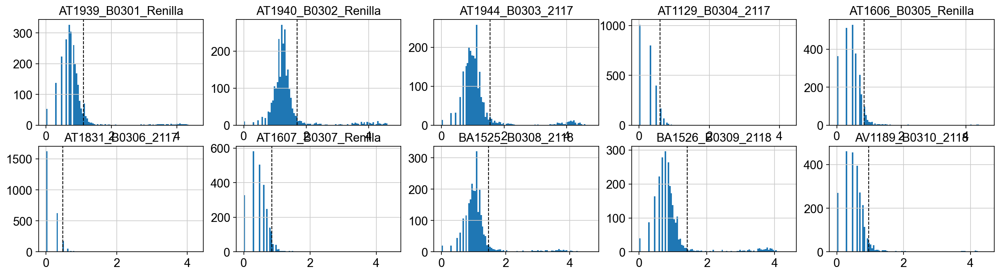

In [29]:
fig, axs = plt.subplots(2,5, figsize =(20, 5))

for i, hashName in enumerate(hashadata.var_names):
    hashCounts2 = np.log10(hashCounts[hashName]+1)
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].hist(hashCounts2, bins = 100)
    axs[i//5,i%5].axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)

#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

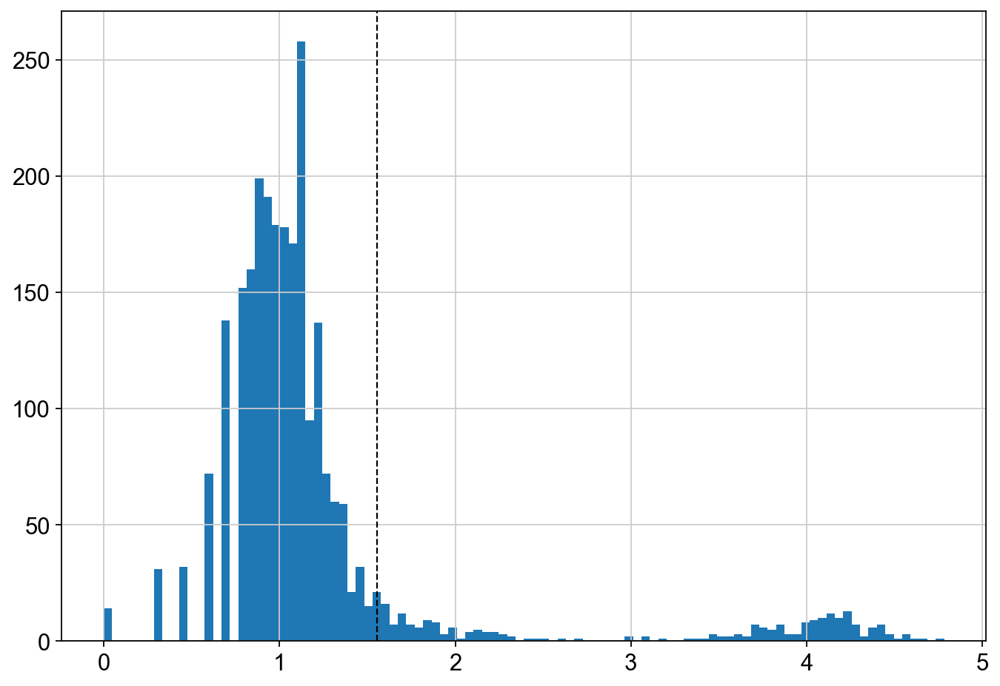

In [30]:
hashName= "AT1944_B0303_2117"
hash301 = np.log10(hashCounts[hashName]+1)

fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(hash301, bins = 100)
ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
plt.show()

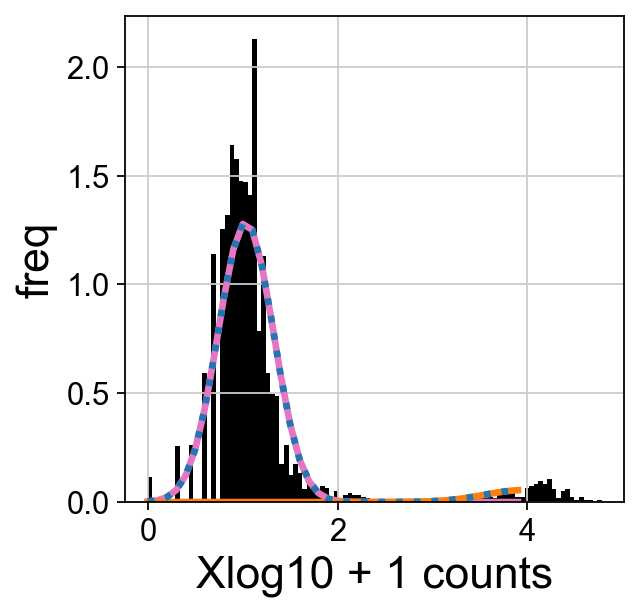

In [31]:
# import libraries (some are for cosmetics)
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter, AutoMinorLocator)
from scipy.stats import norm
from sklearn.mixture import GaussianMixture as GMM
import matplotlib as mpl

x = np.array(hash301).reshape(-1, 1)

# create GMM model object
gmm = GMM(n_components = 2, random_state=10, covariance_type = 'full', n_init=5, weights_init=[0.9,0.1], means_init=[[2],[4]])

# find useful parameters
fitGMM = gmm.fit(x)
mean = fitGMM.means_  
covs  = fitGMM.covariances_
weights = fitGMM.weights_

# create necessary things to plot
x_axis = np.arange(0, 4, 0.1)
y_axis0 = norm.pdf(x_axis, float(mean[0][0]), np.sqrt(float(covs[0][0][0])))*weights[0] # 1st gaussian
y_axis1 = norm.pdf(x_axis, float(mean[1][0]), np.sqrt(float(covs[1][0][0])))*weights[1] # 2nd gaussian

ax = fig.add_subplot(1,2,2)
# Plot 2
plt.hist(x, density=True, color='black', bins=100)
plt.plot(x_axis, y_axis0, lw=3, c='C6')
plt.plot(x_axis, y_axis1, lw=3, c='C1')
plt.plot(x_axis, y_axis0+y_axis1, lw=3, c='C0', ls=':')
#plt.xlim(0, 4, 0.1)
#plt.ylim(0.0, 2.0)
plt.xlabel(r"Xlog10 + 1 counts", fontsize=20)
plt.ylabel(r"freq", fontsize=20)

#plt.subplots_adjust(wspace=0.3)
plt.show()
plt.close('all')

fig, axs = plt.subplots(2,5, figsize =(20, 5))
dfHashBoundry = pd.DataFrame(np.zeros(len(hashadata.var_names)),hashadata.var_names, columns=["boundry"])
gmm = GMM(n_components = 2, random_state=10, covariance_type = 'full', n_init=5, means_init=[[0.5],[3]])
binEx = np.arange(0,50,5/1000).reshape(-1,1)

for i, hashName in enumerate(hashadata.var_names):
    hashCount = np.array(np.log2(hashCounts[hashName]+1)).reshape(-1, 1)
    fitGMM = gmm.fit(hashCount)
    mean = fitGMM.means_  
    covs  = fitGMM.covariances_
    weights = fitGMM.weights_

    fitGmmBound = fitGMM.predict(binEx)
    hashBoundary = False # look for where the transition starts
    if fitGmmBound[0] == 0:
        if np.where(fitGmmBound == 1)[0].size == 0:
            #set hashBoundry to naiveBoundry if there is no second Gaussian
            hashBoundry = np.log2(int(hashDisc.loc["99%",hashName])+1)
        else:
            hashBoundry = binEx[np.where(fitGmmBound == 1)[0][0]][0]
    else:
        count = False
        for x in range(0,len(fitGmmBound)):
            if not count and fitGmmBound[x] != 0:
                continue
            elif fitGmmBound[x] == 0:
                count = x
            elif count and fitGmmBound[x] == 1:
                hashBoundry = binEx[x][0]
                break
    naiveBoundry = np.log2(int(hashDisc.loc["99%",hashName])+1)
    
    dfHashBoundry.loc[hashName] = hashBoundry
    
    x_axis = np.arange(0, 5, 0.1)
    y_axis0 = norm.pdf(x_axis, float(mean[0][0]), np.sqrt(float(covs[0][0][0])))*weights[0] # 1st gaussian
    y_axis1 = norm.pdf(x_axis, float(mean[1][0]), np.sqrt(float(covs[1][0][0])))*weights[1] # 2nd gaussian

    # Plot 2
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].axvline(hashBoundry, c='C2', linestyle='dashed', linewidth=1)  #green #test making it stricter
    axs[i//5,i%5].axvline(naiveBoundry, c='C3', linestyle='dashed', linewidth=1) #red

    axs[i//5,i%5].hist(hashCount, density=True, color='black', bins=100)        
    axs[i//5,i%5].plot(x_axis, y_axis0, lw=3, c='C6')                            #pink
    axs[i//5,i%5].plot(x_axis, y_axis1, lw=3, c='C1')                            #orange
    axs[i//5,i%5].plot(x_axis, y_axis0+y_axis1, lw=3, c='C0', ls=':')            #dotted blue
    
plt.tight_layout(pad=1.0)
#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

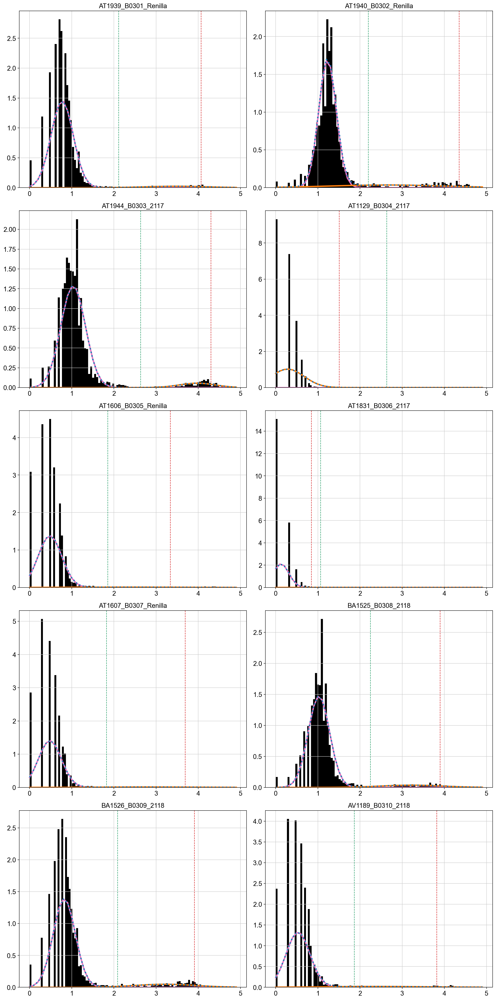

In [32]:
import pdb

fig, axs = plt.subplots(5,2, figsize =(15, 30))
dfHashBoundry = pd.DataFrame(np.zeros(len(hashadata.var_names)),hashadata.var_names, columns=["boundry"])
#gmm = GMM(n_components = 2, random_state=10, covariance_type = 'full', n_init=5, means_init=[[0.1],[4]])
binEx = np.arange(0,5,5/1000).reshape(-1,1)

for i, hashName in enumerate(hashadata.var_names):
    hashCount = np.array(np.log10(hashCounts[hashName]+1)).reshape(-1, 1)
    gmm = GMM(n_components = 2, random_state=10, covariance_type = 'full', n_init=5, weights_init=[0.9,0.1], means_init=[[2],[4]])
    fitGMM = gmm.fit(hashCount)
    mean = fitGMM.means_  
    covs  = fitGMM.covariances_
    weights = fitGMM.weights_

    fitGmmBound = fitGMM.predict(binEx)
    hashBoundary = False # look for where the transition starts
    if fitGmmBound[0] == 0:
        if np.where(fitGmmBound == 1)[0].size == 0:
            #set hashBoundry to naiveBoundry if there is no second Gaussian
            hashBoundry = np.log10(int(hashDisc.loc["99%",hashName])+1)
        else:
            #hashBoundry = binEx[np.where(fitGmmBound == 1)[0][0]][0]            
            hashBoundry = binEx[(np.where(fitGMM.predict_proba(binEx)[:,1] > .99) and np.where(fitGMM.predict_proba(binEx)[:,0] < 1e-3))[0][0]][0]
            #print(np.where(fitGMM.predict_proba(binEx)[:,1] > .99)[0][0])
           
    else:
        count = False
        for x in range(0,len(fitGmmBound)):
            if not count and fitGmmBound[x] != 0:
                continue
            elif fitGmmBound[x] == 0:
                count = x
            elif count and fitGmmBound[x] == 1 and fitGMM.predict_proba(binEx)[x][1] > .99 and fitGMM.predict_proba(binEx)[x][0] < 1e-3:
                hashBoundry = binEx[x][0]
                #pdb.set_trace()
                break
    naiveBoundry = np.log10(int(hashDisc.loc["99%",hashName])+1)
    
    dfHashBoundry.loc[hashName] = hashBoundry
    
    x_axis = np.arange(0, 5, 0.1)
    y_axis0 = norm.pdf(x_axis, float(mean[0][0]), np.sqrt(float(covs[0][0][0])))*weights[0] # 1st gaussian
    y_axis1 = norm.pdf(x_axis, float(mean[1][0]), np.sqrt(float(covs[1][0][0])))*weights[1] # 2nd gaussian

    # Plot 2
    axs[i//2,i%2].set_title(hashName)
    axs[i//2,i%2].axvline(hashBoundry, c='C2', linestyle='dashed', linewidth=1)  #green #test making it stricter
    axs[i//2,i%2].axvline(naiveBoundry, c='C3', linestyle='dashed', linewidth=1) #red
    axs[i//2,i%2].hist(hashCount, density=True, color='black', bins=100)        
    axs[i//2,i%2].plot(x_axis, y_axis0, lw=3, c='C6')                            #pink
    axs[i//2,i%2].plot(x_axis, y_axis1, lw=3, c='C1')                            #orange
    axs[i//2,i%2].plot(x_axis, y_axis0+y_axis1, lw=3, c='C0', ls=':')            #dotted blue
    
plt.tight_layout(pad=1.0)
#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

In [33]:
#dfHashBoundry += 0.1
dfHashBoundry

,boundry
AT1939_B0301_Renilla,2.110
AT1940_B0302_Renilla,2.195
AT1944_B0303_2117,2.635
AT1129_B0304_2117,2.635
AT1606_B0305_Renilla,1.855
AT1831_B0306_2117,1.065
AT1607_B0307_Renilla,1.825
BA1525_B0308_2118,2.245
BA1526_B0309_2118,2.085
AV1189_B0310_2118,1.865


In [34]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(dfHashBoundry.loc[hashName].values[0])
    hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
#hashIDs.loc[:,'AT1129_B0304_2117'] = False
#hashIDs.loc[:,'AT1606_B0305_Renilla'] = False
#hashIDs.loc[:,'AT1831_B0306_2117'] = False
#hashIDs.loc[:,'AT1607_B0307_Renilla'] = False
#hashIDs.loc[:,'AV1189_B0310_2118'] = False
hashIDs

AT1939_B0301_Renilla
2.11
AT1940_B0302_Renilla
2.195
AT1944_B0303_2117
2.6350000000000002
AT1129_B0304_2117
2.6350000000000002
AT1606_B0305_Renilla
1.855
AT1831_B0306_2117
1.065
AT1607_B0307_Renilla
1.825
BA1525_B0308_2118
2.245
BA1526_B0309_2118
2.085
AV1189_B0310_2118
1.865


,AT1939_B0301_Renilla,AT1940_B0302_Renilla,AT1944_B0303_2117,AT1129_B0304_2117,AT1606_B0305_Renilla,AT1831_B0306_2117,AT1607_B0307_Renilla,BA1525_B0308_2118,BA1526_B0309_2118,AV1189_B0310_2118
AAACGAAAGTAATTGG-1,False,False,False,False,False,False,False,False,False,False
AAACGAAAGTGTACCT-1,False,False,False,False,False,False,False,True,False,False
AAACGAAGTATCGCTA-1,False,False,False,False,False,False,False,False,False,False
AAACGAAGTCACGACC-1,False,False,False,False,True,False,False,False,False,False
AAACGCTCACCGTGAC-1,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...
TTTGGAGTCTTGATTC-1,False,True,False,False,False,False,False,False,False,False
TTTGGTTAGAGCATAT-1,False,False,False,False,False,False,False,False,False,False
TTTGGTTGTGACAACG-1,False,False,False,False,False,False,False,False,False,False
TTTGGTTGTTCTTCAT-1,False,False,False,False,False,False,False,False,False,False


In [35]:
classification = np.empty(len(adata), dtype="object")
i = 0
for cellBar, hashBool in hashIDs.iterrows():
    #print(i)
    #print(hashBool)
    #print(hashBool.values)
    #print(sum(hashBool))
    numHashes = sum(hashBool)
    if (numHashes == 1):
        classif = hashID[hashBool.values].values[0]
    elif (numHashes > 1):
        classif = "doublet"
    else:
        classif = "negative"
    classification[i] = classif
    i = i + 1
    #break

In [36]:
adata.obs["Classification"] = classification
hashadata.obs["Classification"] = classification
adata.obs["Classification"].value_counts()

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/4135005838.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["Classification"] = classification


negative                1625
BA1526_B0309_2118        163
AT1940_B0302_Renilla     157
AT1944_B0303_2117        134
BA1525_B0308_2118        126
AT1939_B0301_Renilla      89
AV1189_B0310_2118         74
doublet                   55
AT1607_B0307_Renilla      44
AT1606_B0305_Renilla      38
AT1129_B0304_2117         16
AT1831_B0306_2117         13
Name: Classification, dtype: int64

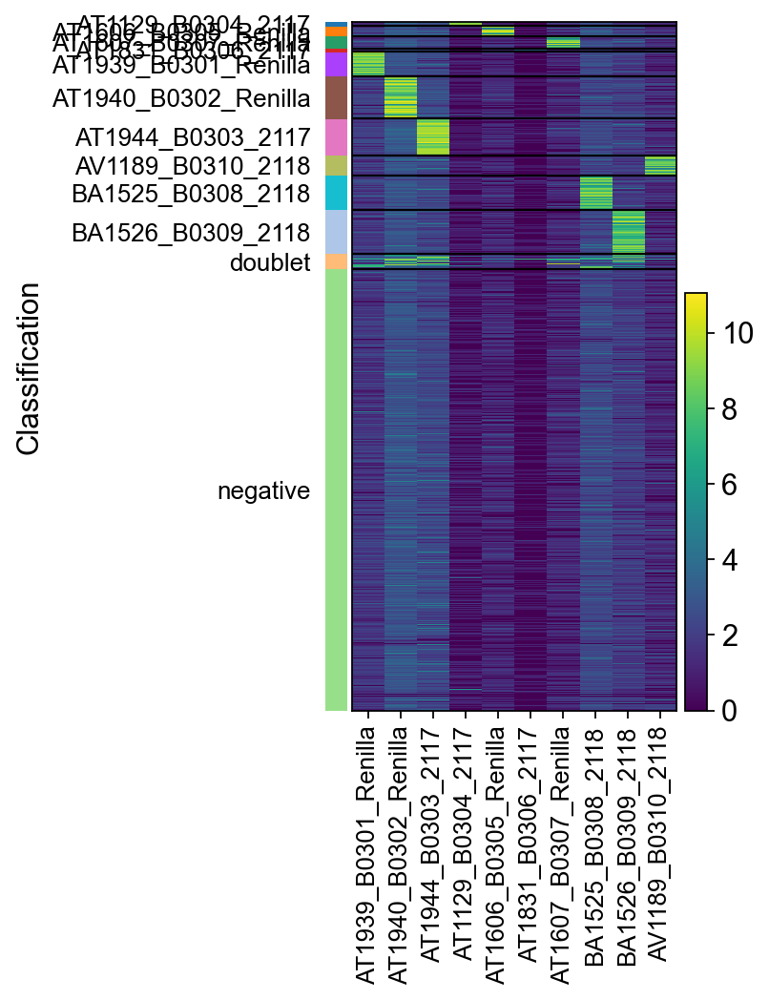

In [37]:
#output visulaization of hashing
sc.pl.heatmap(hashadata, hashadata.var_names, groupby="Classification", log=True)#, save = f"_{figName}_hash.png")

(array([2.482e+03, 1.900e+01, 4.000e+00, 1.400e+01, 2.000e+00, 4.000e+00,
        1.000e+00, 4.000e+00, 3.000e+00, 1.000e+00]),
 array([ 0. ,  4.6,  9.2, 13.8, 18.4, 23. , 27.6, 32.2, 36.8, 41.4, 46. ],
       dtype=float32),
 <BarContainer object of 10 artists>)

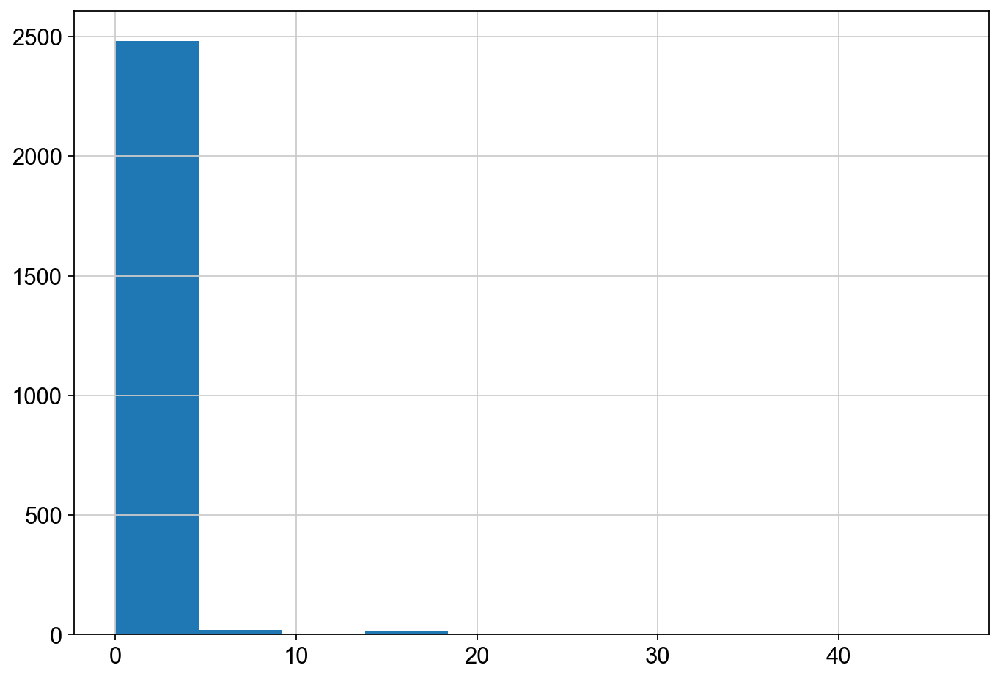

In [38]:
#Remove any cell with shRenilla counts
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata.X[:,adata.var.index.isin(['shRenilla'])].toarray())
#ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
#adata.obs['shRenilla'] = 0

#adata.obs['shRenilla'][adata.X[:,adata.var.index.isin(['shRenilla'])] >0] #= adata.X[:,adata.var.index.isin(['shRenilla'])]

In [39]:
adata.obs['Renilla'] = adata.X[:,adata.var.index.isin(['shRenilla'])].toarray()

(array([2.507e+03, 1.000e+01, 5.000e+00, 3.000e+00, 4.000e+00, 1.000e+00,
        2.000e+00, 0.000e+00, 0.000e+00, 2.000e+00]),
 array([ 0. ,  3.8,  7.6, 11.4, 15.2, 19. , 22.8, 26.6, 30.4, 34.2, 38. ],
       dtype=float32),
 <BarContainer object of 10 artists>)

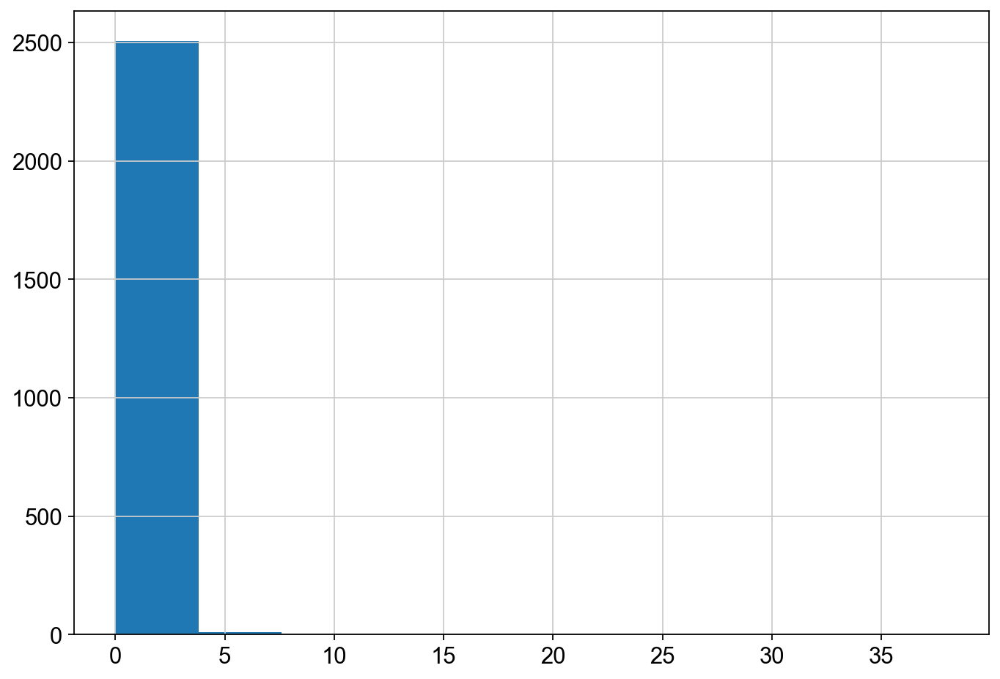

In [40]:
#Remove any cell with shRenilla counts
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata.X[:,adata.var.index.isin(['2117-Nfkb1.2331'])].toarray())
#ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
#adata.obs['2117-Nfkb1.2331'] = 0

#adata.obs['shRenilla'][adata.X[:,adata.var.index.isin(['shRenilla'])] >0] #= adata.X[:,adata.var.index.isin(['shRenilla'])]

In [41]:
adata.obs['2117-Nfkb1'] = adata.X[:,adata.var.index.isin(['2117-Nfkb1.2331'])].toarray()

(array([2.507e+03, 1.200e+01, 5.000e+00, 3.000e+00, 4.000e+00, 2.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([ 0. ,  6.4, 12.8, 19.2, 25.6, 32. , 38.4, 44.8, 51.2, 57.6, 64. ],
       dtype=float32),
 <BarContainer object of 10 artists>)

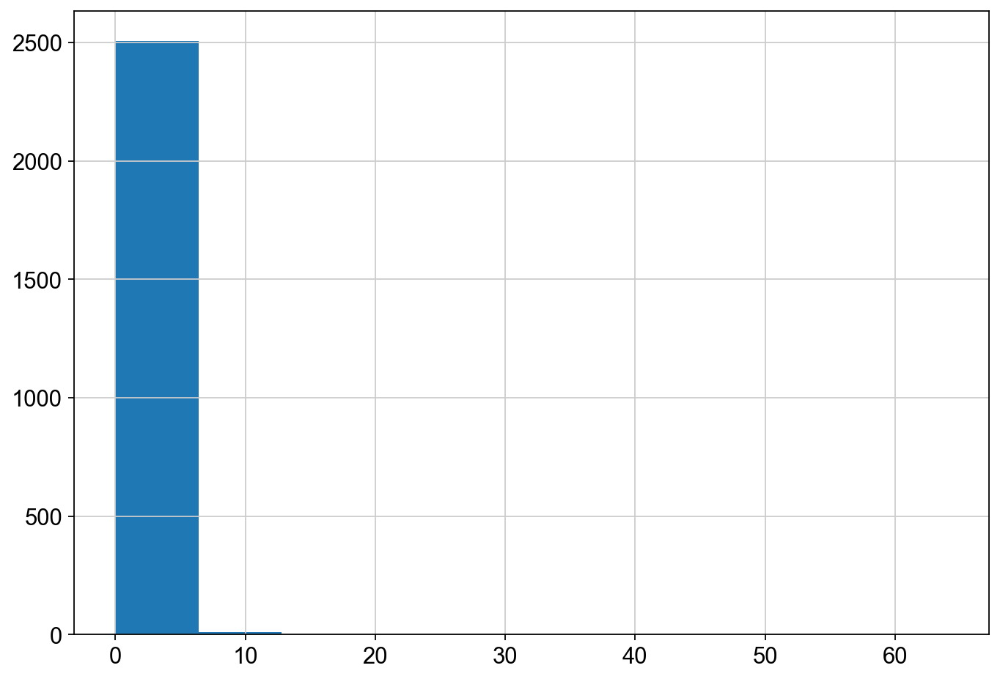

In [42]:
#Remove any cell with shRenilla counts
fig, ax = plt.subplots(figsize =(10, 7))
ax.hist(adata.X[:,adata.var.index.isin(['2118-Nfkb1.3737'])].toarray())
#ax.axvline(np.log10(int(hashDisc.loc["90%",hashName])+1), color='k', linestyle='dashed', linewidth=1)
# Show plot
#adata.obs['2118-Nfkb1.3737'] = 0

#adata.obs['shRenilla'][adata.X[:,adata.var.index.isin(['shRenilla'])] >0] #= adata.X[:,adata.var.index.isin(['shRenilla'])]

In [43]:
adata.obs['2118-Nfkb1'] = adata.X[:,adata.var.index.isin(['2118-Nfkb1.3737'])].toarray()

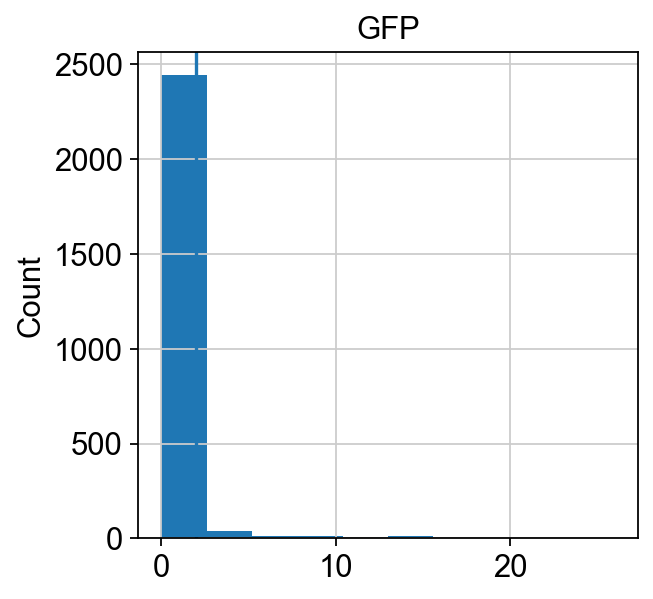

In [44]:
import matplotlib.pyplot as plt
_ = plt.hist(adata[adata.obs.index,'GFP'].X.toarray())
plt.ylabel("Count")
plt.title("GFP")
plt.axvline(x=2)
plt.show()

In [45]:
adata.obs['GFP_count'] = adata.X[:,adata.var.index.isin(['GFP'])].toarray()

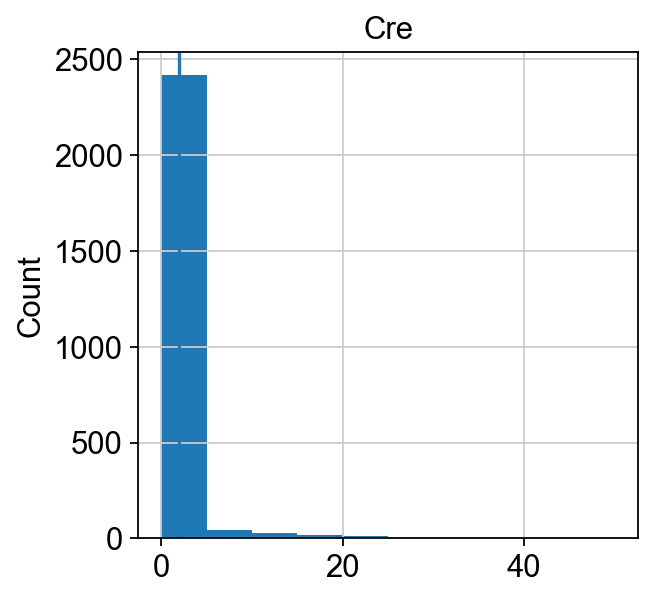

In [46]:
import matplotlib.pyplot as plt
_ = plt.hist(adata[adata.obs.index,'Cre'].X.toarray())
plt.ylabel("Count")
plt.title("Cre")
plt.axvline(x=2)
plt.show()

In [47]:
adata.obs['Cre_count'] = adata.X[:,adata.var.index.isin(['Cre'])].toarray()

In [48]:
hadata = adata.copy()

In [49]:
sc.pp.normalize_total(hadata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [50]:
sc.pp.log1p(hadata)

In [51]:
sc.pp.highly_variable_genes(hadata)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [52]:
hadata = hadata[:, hadata.var.highly_variable]

In [53]:
sc.pp.scale(hadata, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [54]:
sc.tl.pca(hadata, svd_solver='arpack', n_comps=150)

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:00)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

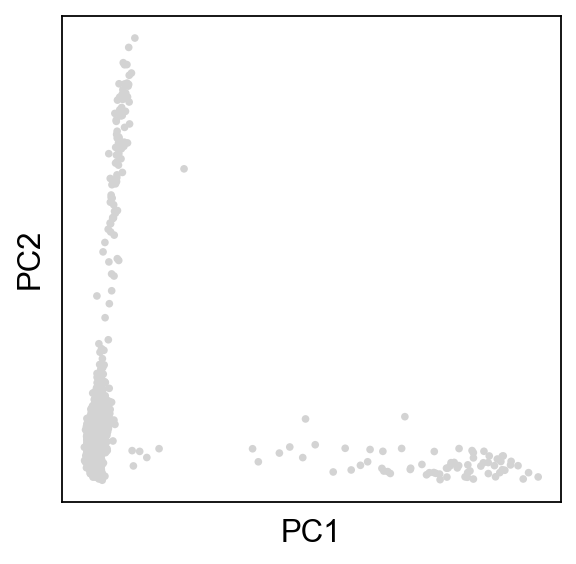

In [55]:
sc.pl.pca(hadata)

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often a rough estimate of the number of PCs does fine.

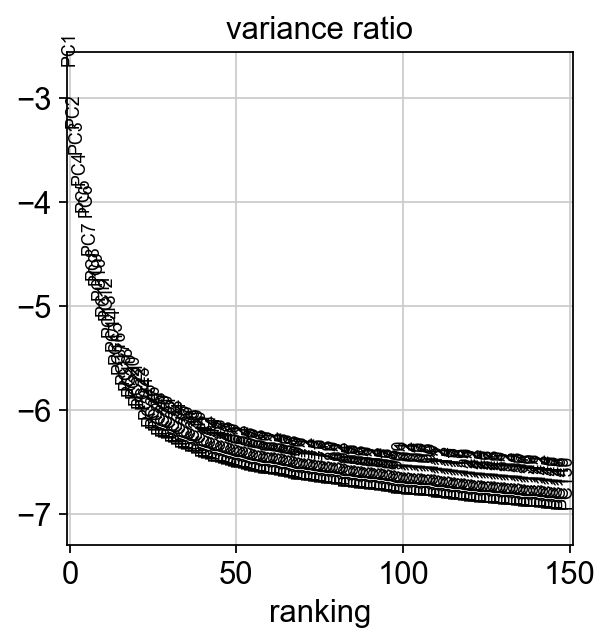

In [56]:
sc.pl.pca_variance_ratio(hadata, log=True, n_pcs=150)

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [57]:
sc.pp.neighbors(hadata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


## Embedding the neighborhood graph

We suggest embedding the graph in two dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [58]:
sc.tl.umap(hadata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


In [59]:
adata.obs['Classification'].unique()

array(['negative', 'BA1525_B0308_2118', 'AT1606_B0305_Renilla',
       'AT1944_B0303_2117', 'doublet', 'AT1939_B0301_Renilla',
       'AT1940_B0302_Renilla', 'BA1526_B0309_2118', 'AV1189_B0310_2118',
       'AT1607_B0307_Renilla', 'AT1831_B0306_2117', 'AT1129_B0304_2117'],
      dtype=object)

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


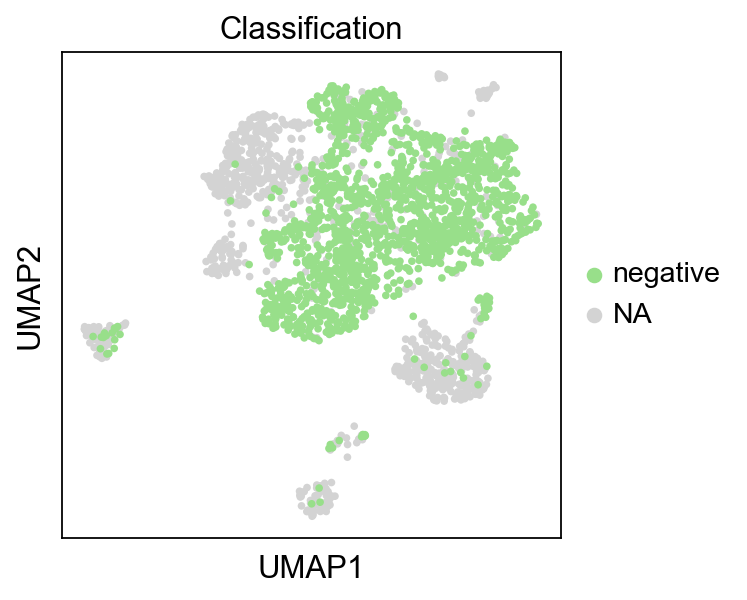

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


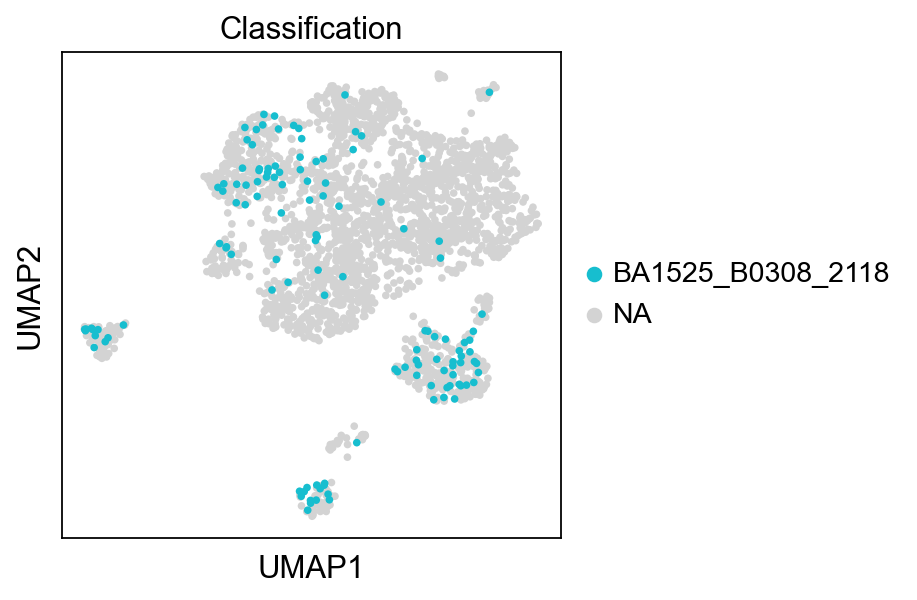

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


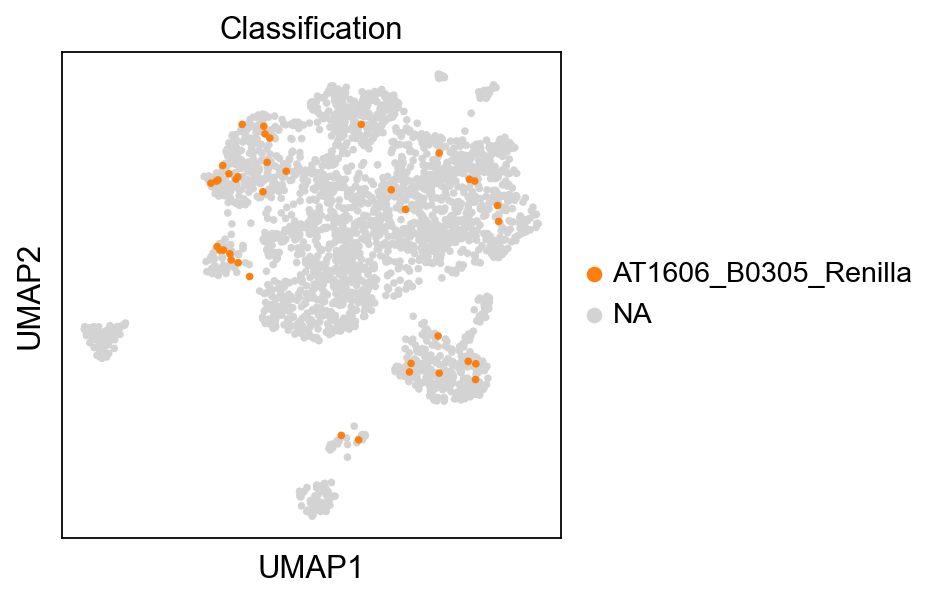

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


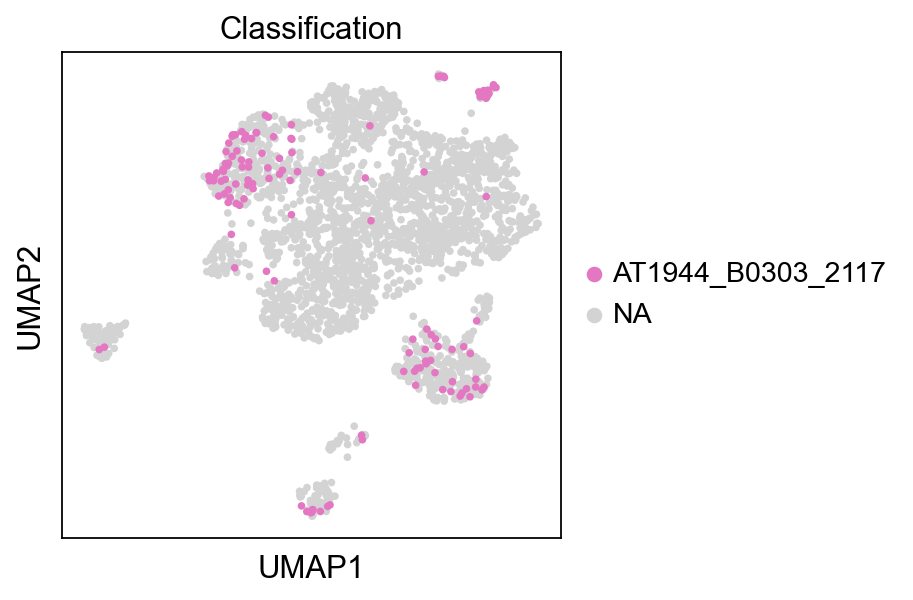

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


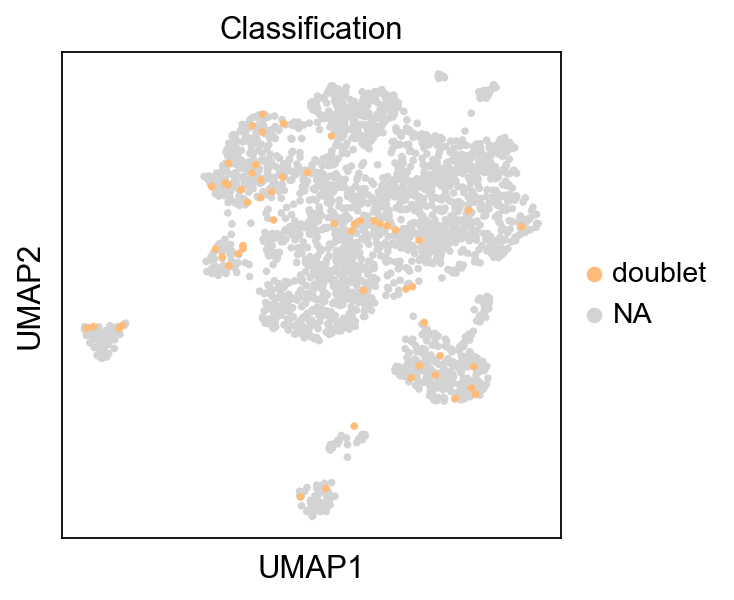

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


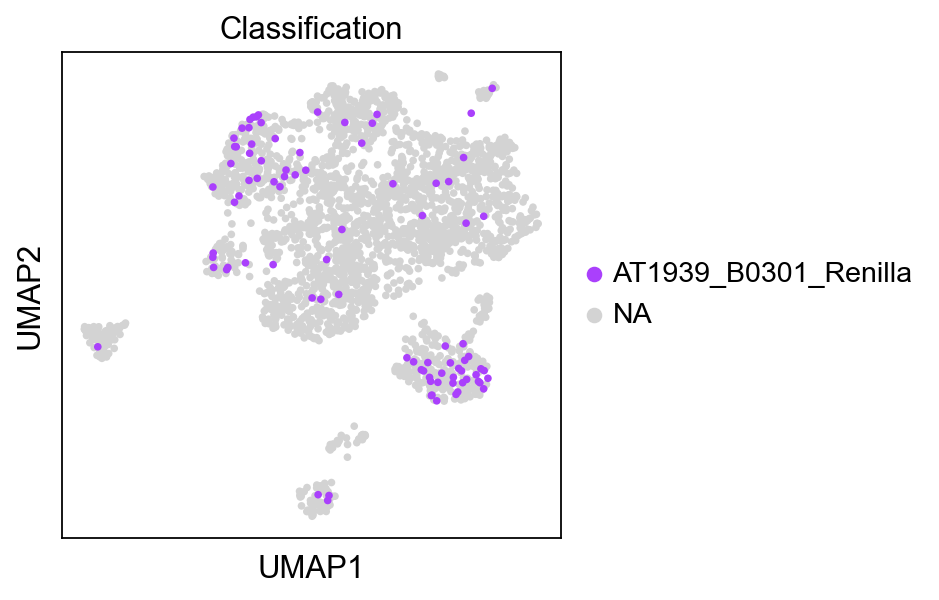

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


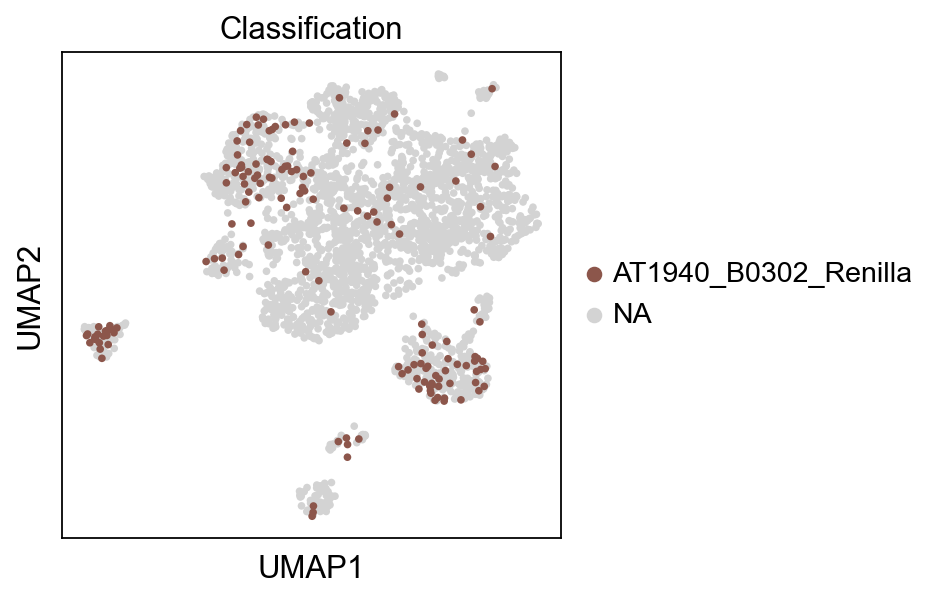

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


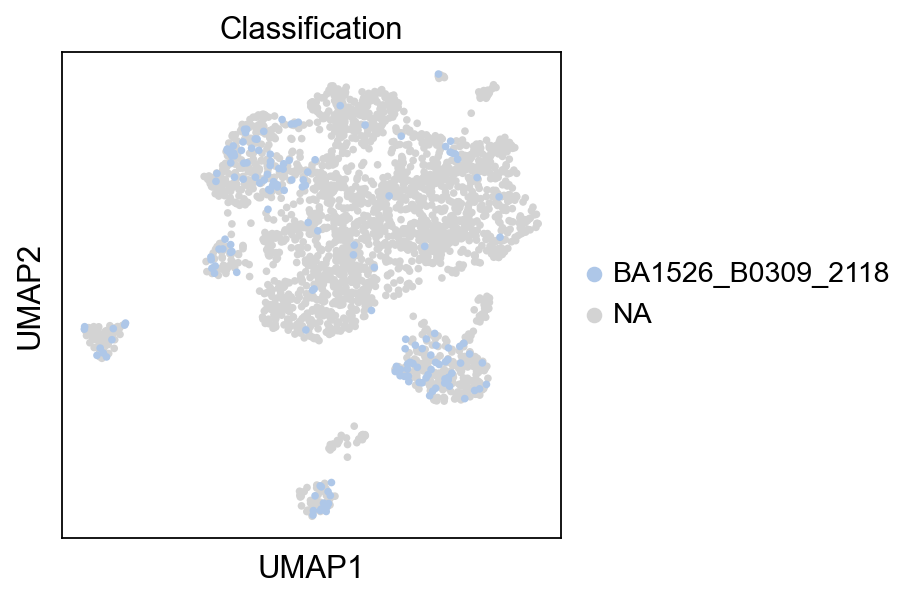

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


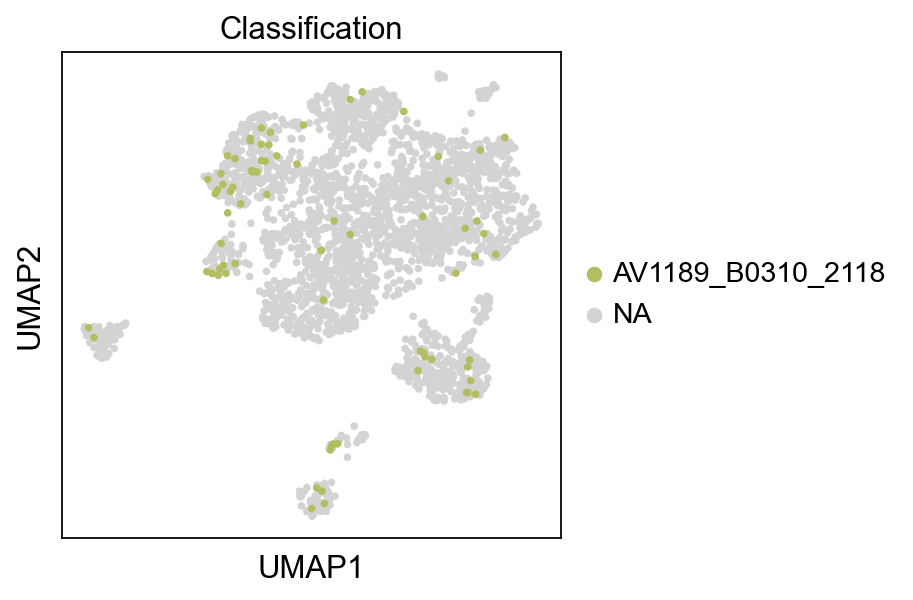

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


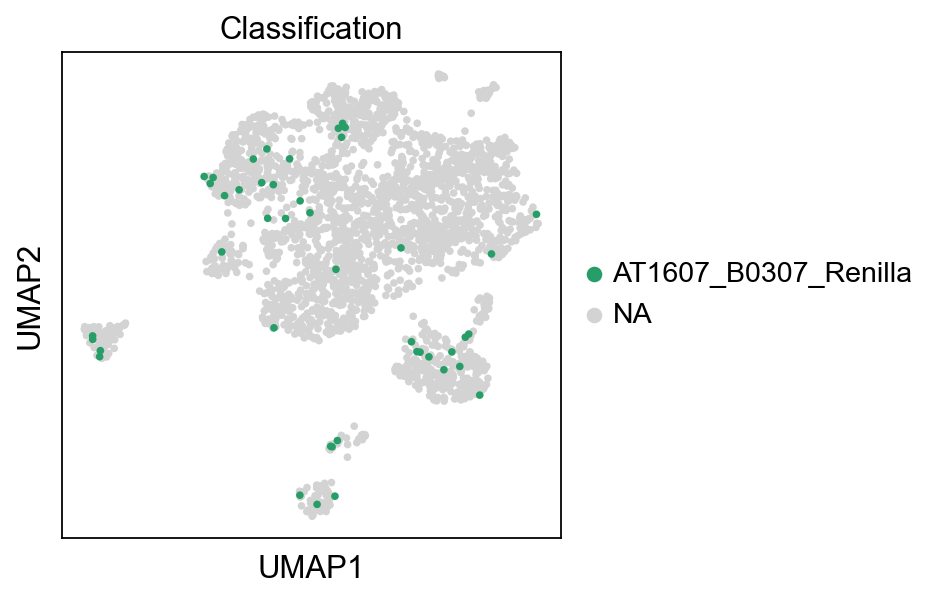

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


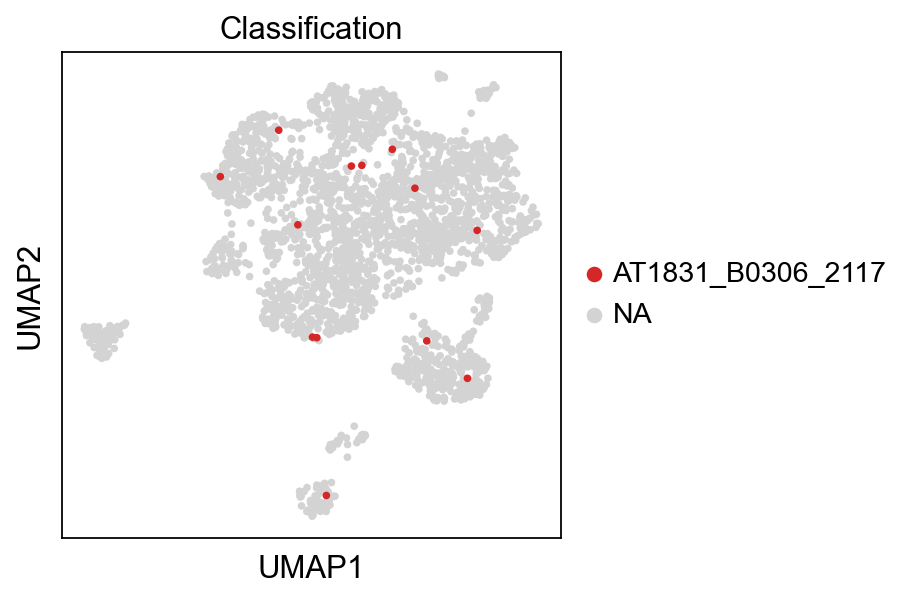

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


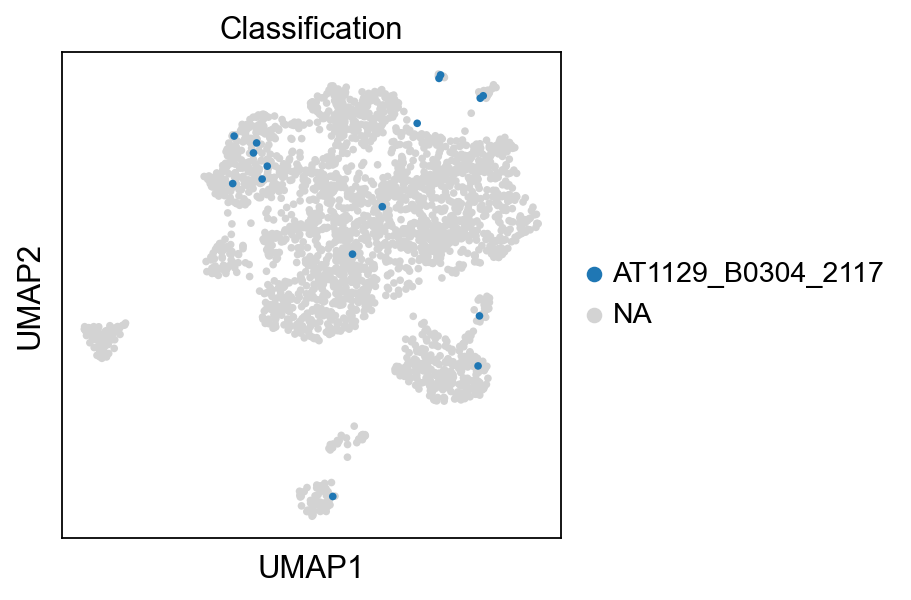

In [60]:
for label in hadata.obs['Classification'].unique():
    sc.pl.umap(hadata, color='Classification',groups=[label])

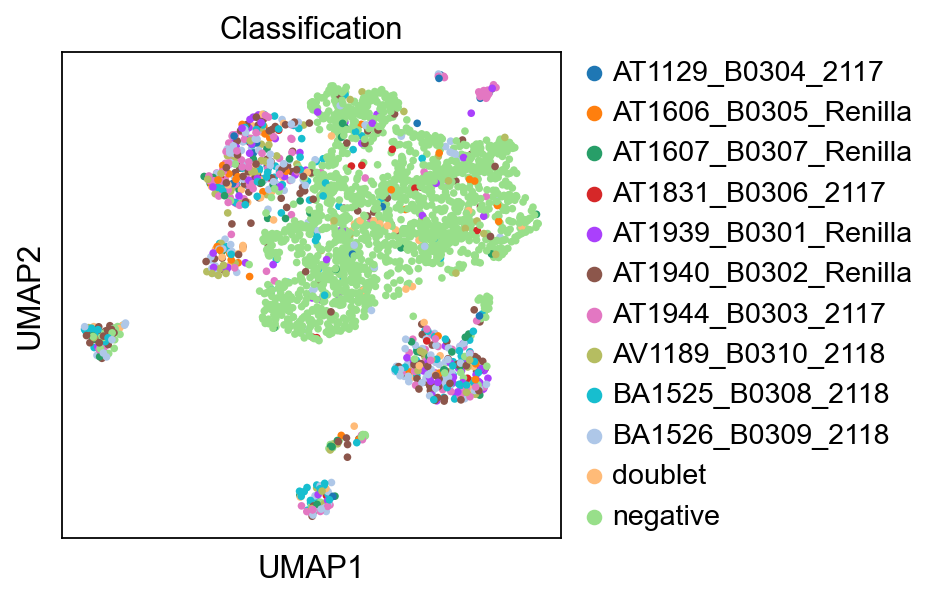

In [61]:
sc.pl.umap(hadata, color='Classification')

In [62]:
samples

['AT1939_B0301_Renilla',
 'AT1940_B0302_Renilla',
 'AT1944_B0303_2117',
 'AT1129_B0304_2117',
 'AT1606_B0305_Renilla',
 'AT1831_B0306_2117',
 'AT1607_B0307_Renilla',
 'BA1525_B0308_2118',
 'BA1526_B0309_2118',
 'AV1189_B0310_2118']

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


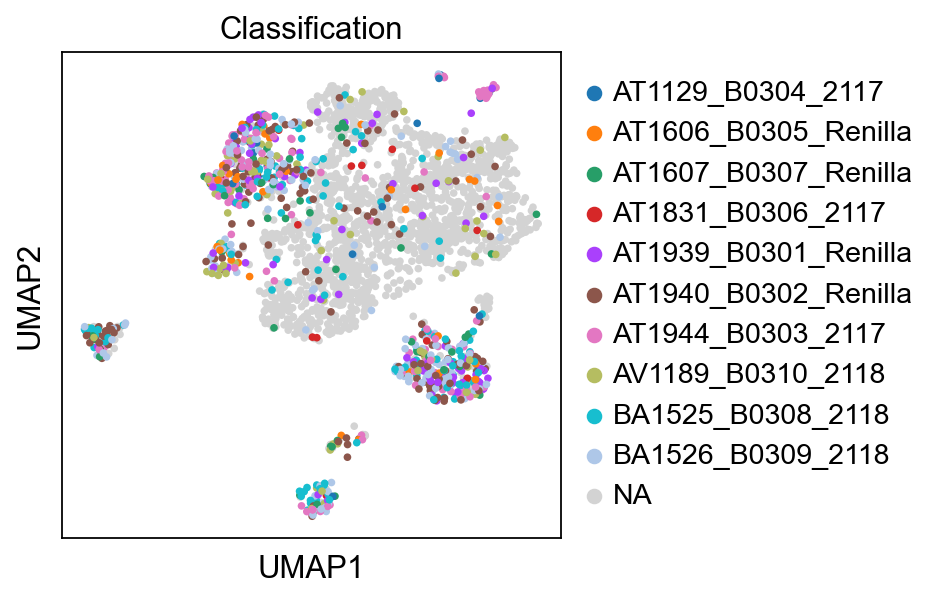

In [63]:
sc.pl.umap(hadata, color='Classification', groups=samples)

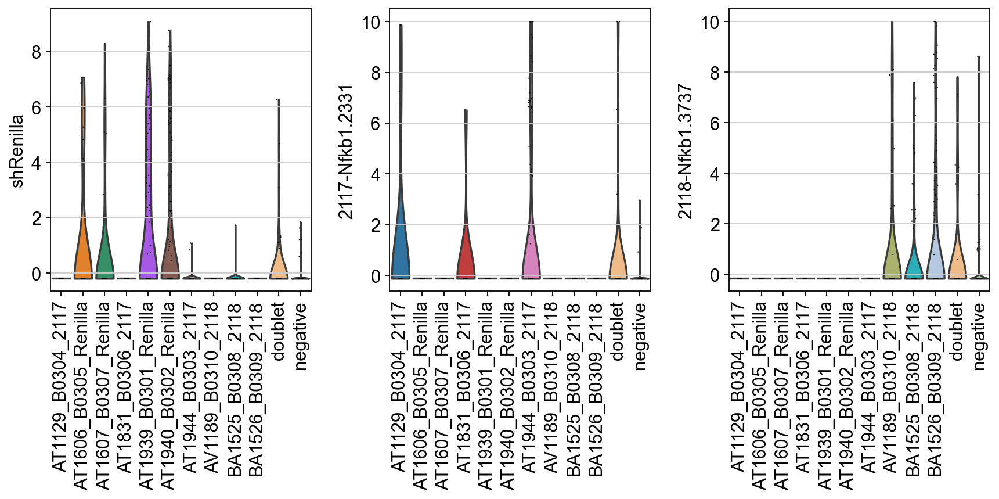

In [64]:
sc.pl.violin(hadata,['shRenilla','2117-Nfkb1.2331','2118-Nfkb1.3737'], groupby='Classification', rotation=90)

In [65]:
hadata.obs.Classification.value_counts()

negative                1625
BA1526_B0309_2118        163
AT1940_B0302_Renilla     157
AT1944_B0303_2117        134
BA1525_B0308_2118        126
AT1939_B0301_Renilla      89
AV1189_B0310_2118         74
doublet                   55
AT1607_B0307_Renilla      44
AT1606_B0305_Renilla      38
AT1129_B0304_2117         16
AT1831_B0306_2117         13
Name: Classification, dtype: int64

## set highly variable genes before moving all mean to 0

In [66]:
adata = adata[~adata.obs['Classification'].isin(['doublet','negative']),:]

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


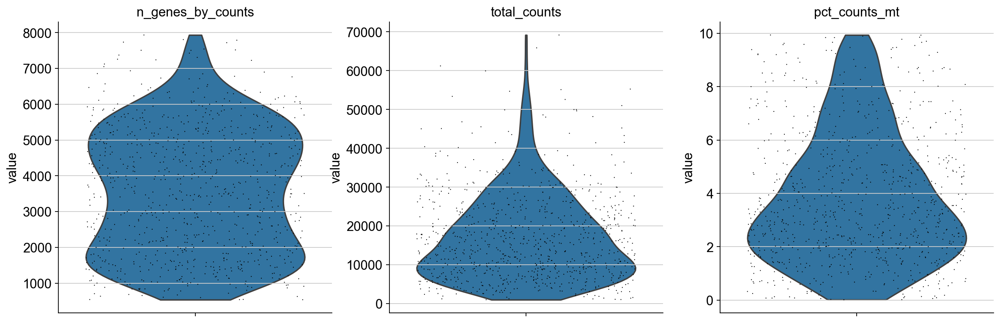

In [67]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

In [68]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [69]:
sc.pp.log1p(adata)

In [70]:
sc.pp.highly_variable_genes(adata) #batch_key=Classification

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


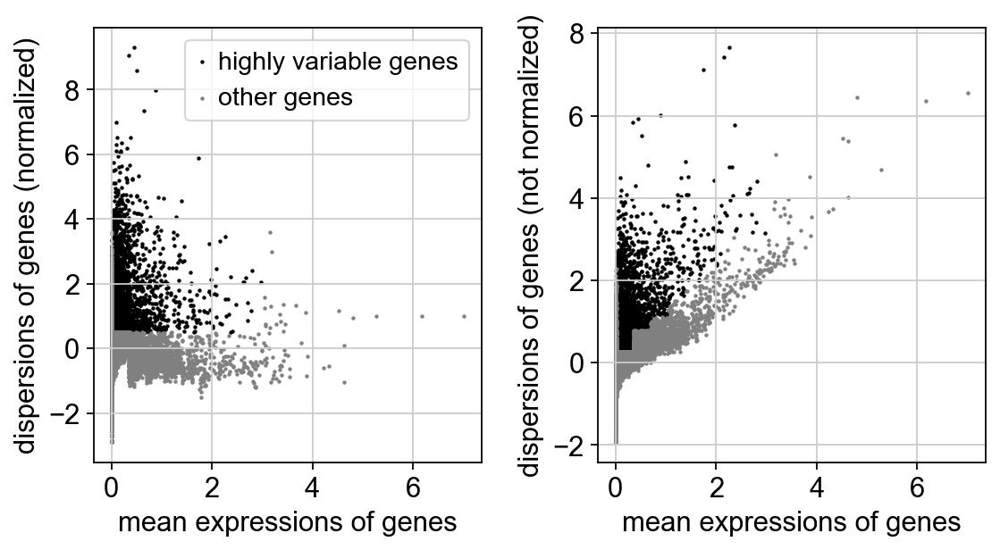

In [71]:
sc.pl.highly_variable_genes(adata)

In [72]:
library = ["1659-Fosl2.226","1660-Fosl2.752","1661-Fhl2.467","1662-Fhl2.179","1663-Myc.989","1664-Myc.1389","1665-Yap1.735","1666-Yap1.2847","1667-Atf4.1383","1668-Atf4.536","1669-Maff.85","1670-Maff.587","1671-Nfkb2.152","1672-Nfkb2.534","1673-Relb.286","1674-Relb.1795","1675-Onecut2.1799","1676-Onecut2.2361","1810-Slc4a11.541","1934-Slc4a11.1966","1811-Itga2.672","1812-Itga2.204","1998-Cldn4-1013","1999-Cldn4-951","2113-Lif.440","2114-Lif.1890","2115-Fosl1.1401","2116-Fosl1.699","2117-Nfkb1.2331","2118-Nfkb1.3737",'shRenilla']

In [73]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['GFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Cre'] = False
for x in library:
    adata.var.highly_variable[x] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/2494002207.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable['GFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/2494002207.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable['mKate2'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/2494002207.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#return

In [74]:
#Set shRNA groups
adata.obs['shRNA'] = None
adata.obs['shRNA'][adata[adata.obs['Renilla'] >= 2,:].obs.index] = 'shRenilla'
adata.obs['shRNA'][adata[adata.obs['2117-Nfkb1'] >= 2,:].obs.index] = '2117'
adata.obs['shRNA'][adata[adata.obs['2118-Nfkb1'] >= 2,:].obs.index] = '2118'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/934621939.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['shRNA'][adata[adata.obs['Renilla'] >= 2,:].obs.index] = 'shRenilla'
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/934621939.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['shRNA'][adata[adata.obs['2117-Nfkb1'] >= 2,:].obs.index] = '2117'
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/934621939.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://

In [75]:
adata.obs[['Classification','shRNA']].value_counts()

Classification        shRNA    
AT1940_B0302_Renilla  shRenilla    32
AT1939_B0301_Renilla  shRenilla    29
AT1944_B0303_2117     2117         28
BA1526_B0309_2118     2118         28
BA1525_B0308_2118     2118         12
AV1189_B0310_2118     2118         10
AT1606_B0305_Renilla  shRenilla     8
AT1607_B0307_Renilla  shRenilla     5
AT1129_B0304_2117     2117          2
dtype: int64

In [76]:
adata.raw = adata

In [77]:
adata.write('write/allmice-noSCT_lane1.h5ad', compression='gzip')

In [78]:
adata = sc.read('write/allmice-noSCT_lane1.h5ad')

In [79]:
adata = adata[:, adata.var.highly_variable]

In [80]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:07)


In [81]:
sc.pp.scale(adata, max_value=10)

## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [82]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=100)

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:00)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

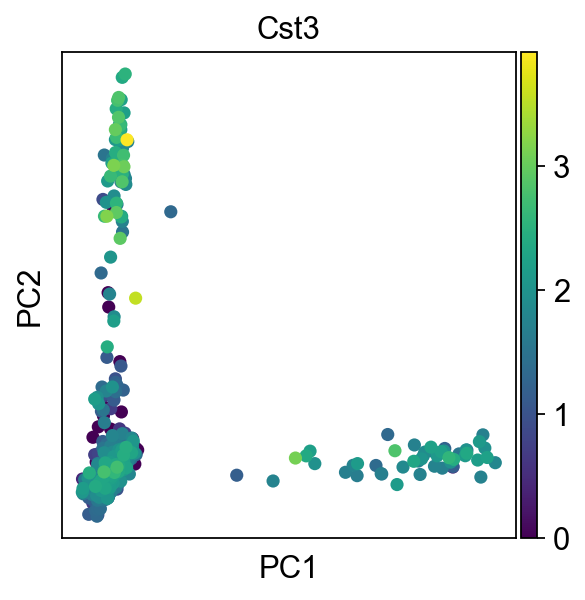

In [83]:
sc.pl.pca(adata, color='Cst3')

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often a rough estimate of the number of PCs does fine.

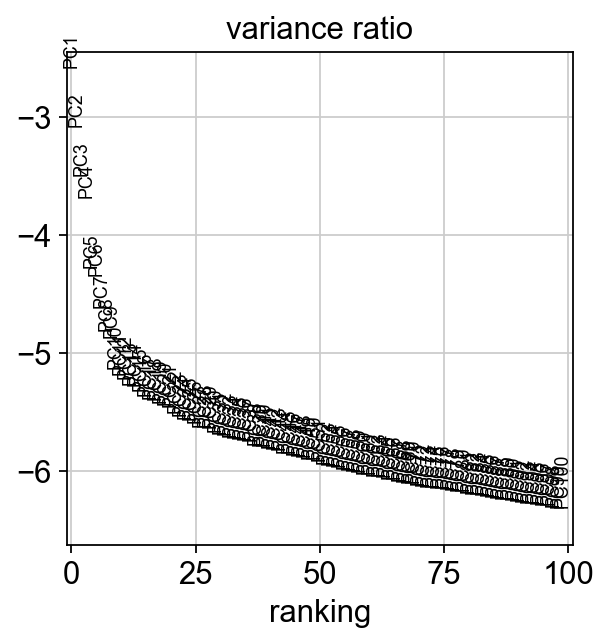

In [84]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=100)

Save the result.

In [85]:
adata.write(results_file, compression='gzip')

In [86]:
adata

AnnData object with n_obs × n_vars = 854 × 4247
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Renilla', '2117-Nfkb1', '2118-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [87]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=25)

computing neighbors
    using 'X_pca' with n_pcs = 25
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


## Embedding the neighborhood graph

We suggest embedding the graph in two dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [88]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


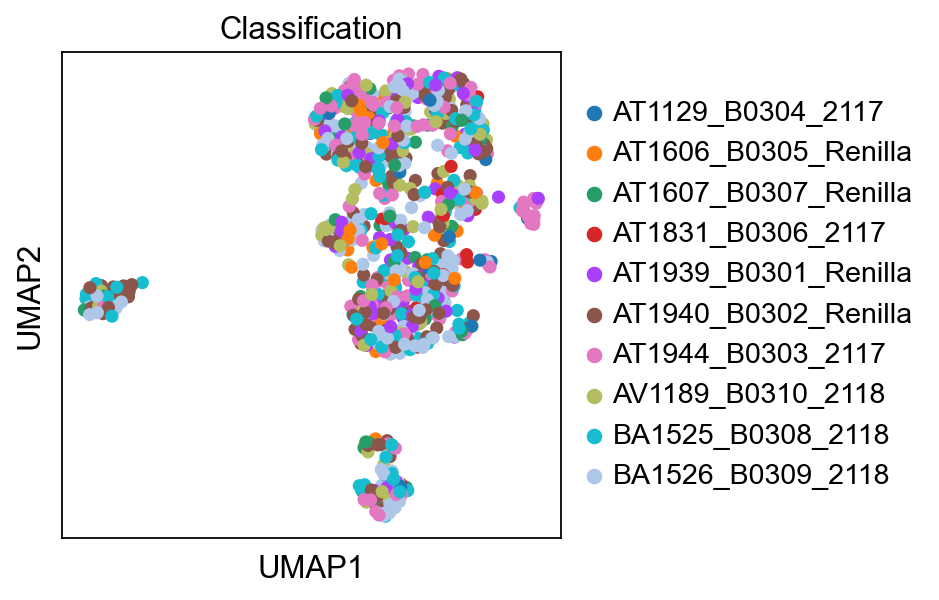

In [89]:
sc.pl.umap(adata, color=['Classification'])

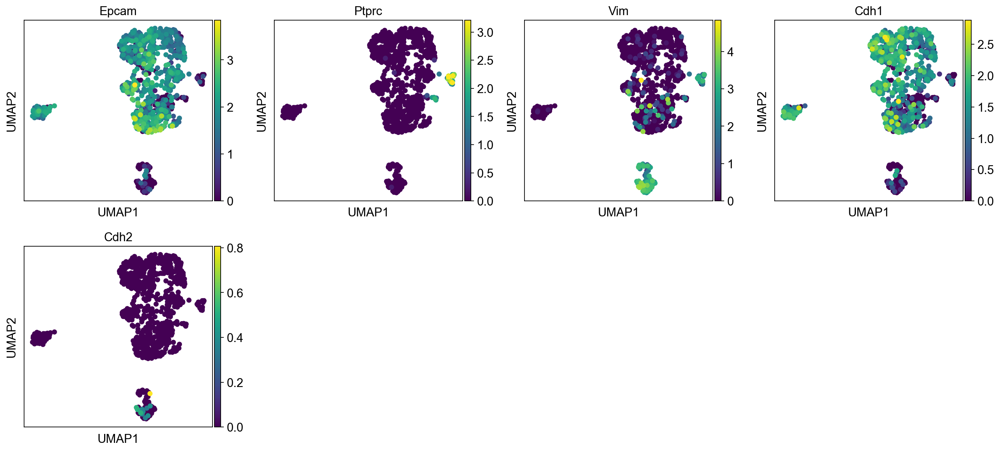

In [90]:
sc.pl.umap(adata, color=['Epcam', 'Ptprc','Vim', 'Cdh1','Cdh2'])

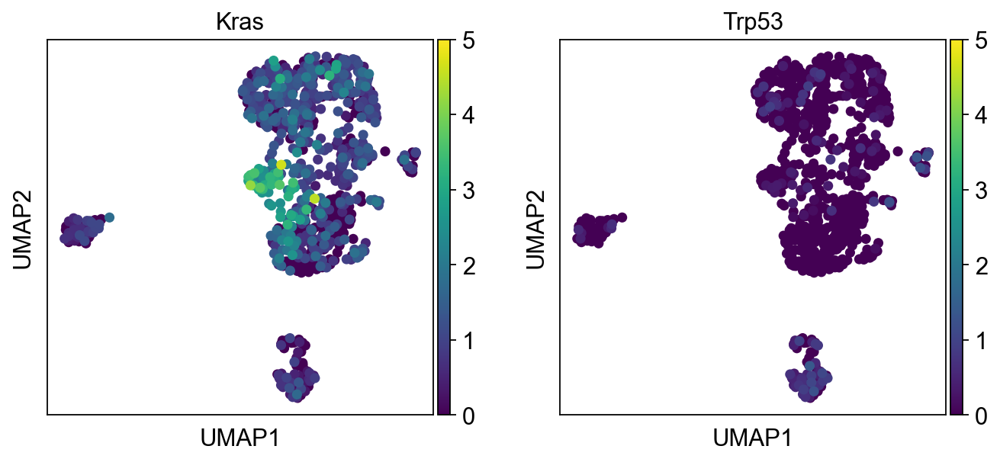

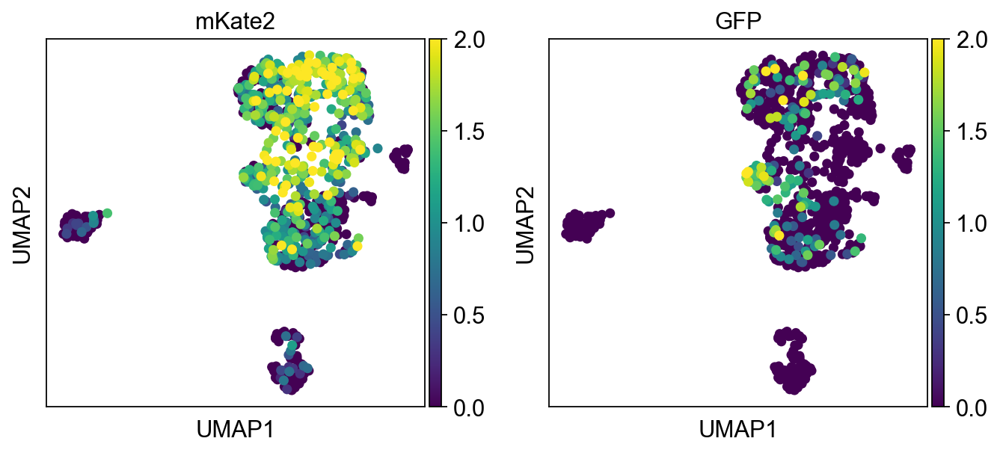

In [91]:
sc.pl.umap(adata, color=['Kras','Trp53'], vmax=5)
sc.pl.umap(adata, color=['mKate2','GFP'], vmax=2)

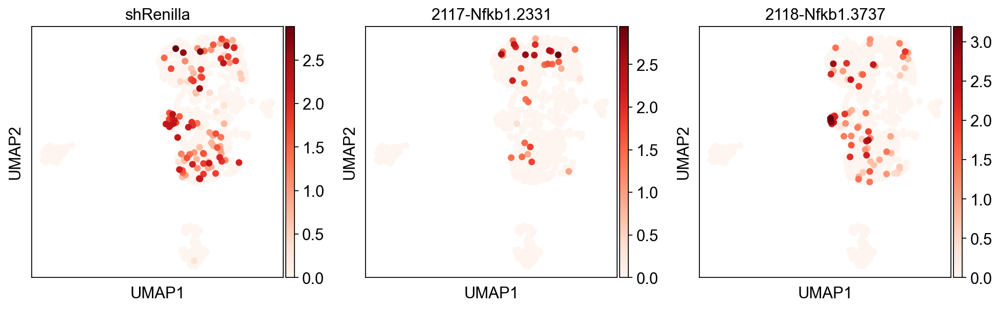

In [92]:
sc.pl.umap(adata, color=['shRenilla', '2117-Nfkb1.2331','2118-Nfkb1.3737'], cmap='Reds')

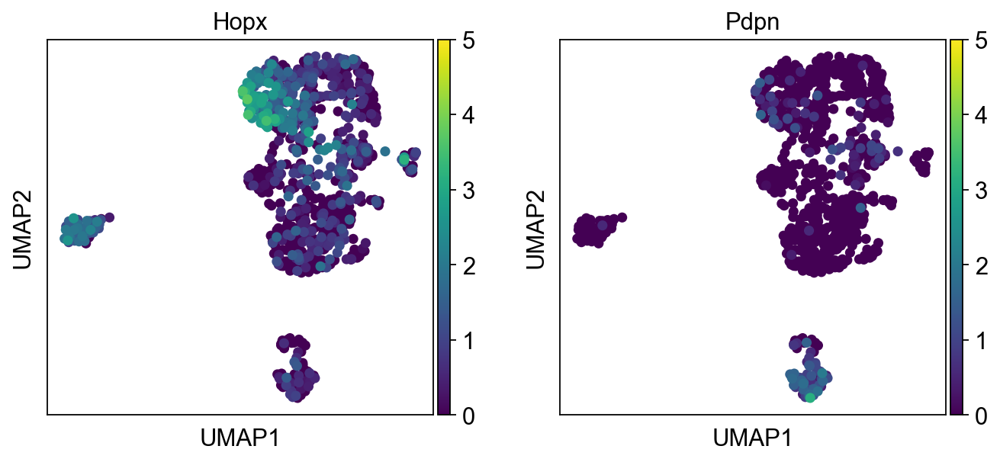

In [93]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], vmax=5)

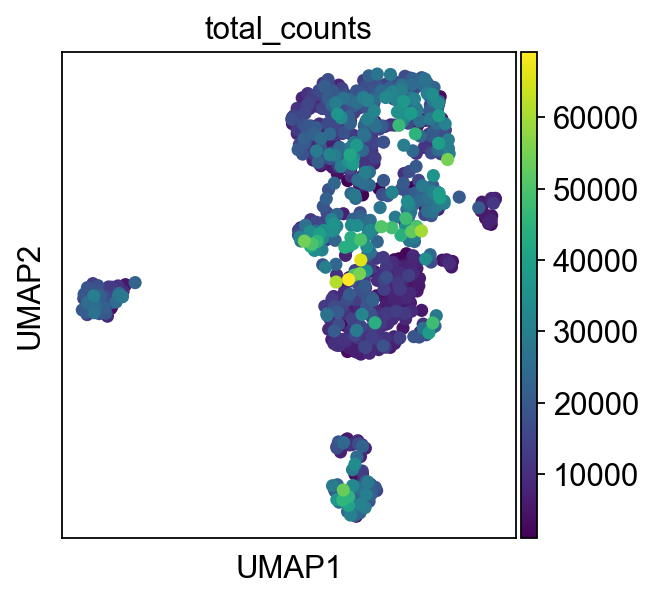

In [94]:
sc.pl.umap(adata, color=['total_counts'])

In [95]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'tumorClusters':
            with open('clusters/tumorClustersv2.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            for i in range(0,16):
                clusterkeys.append('%i' % i)
            HPCS = '3'
        elif hpcs == 'cell2020':         
            with open('clusters/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        elif hpcs == 'cl5bootstrap':
            with open('clusters/cl5bootstrap.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            #for i in range(0,1):
                #clusterkeys.append('%i' % i)
            clusterkeys.append('Cl5Bootstrap')
            HPCS = 'Cl5Bootstrap'
        elif hpcs == 'cl5bootstrap2':
            with open('clusters/cl5bootstrap2.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = row[1:]
            #for i in range(0,1):
                #clusterkeys.append('%i' % i)
            clusterkeys.append('Cl5Bootstrap2')
            HPCS = 'Cl5Bootstrap2'
        elif hpcs == 'shRenilla':
            raise ValueError
            ###
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [96]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i)  
        #sc.tl.score_genes(ad, clusters['Highly_mixed'],score_name="Highly_mixed")
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        #sc.pl.violin(ad, ['SLC4A11','ITGA2','CLDN4','TGIF1','Cluster5'],
         #   jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation)     
        #sc.pl.violin(ad, ['Highly_mixed'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation)            
        #sc.pl.violin(ad, ['MYC_sig','MYC','Fredlund','Jung'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation)     
        #sc.pl.violin(ad, ['ONECUT2','ONECUT2_369_sig','ONECUT2_29_sig'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation) 
        #sc.pl.violin(ad, ['YAP1', 'TAZ', 'YAP_sig'],
        #    jitter=0.4, multi_panel=True, groupby=groupby, rotation=rotation) 
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [97]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
        #sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    499 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    597 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    650 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    599 total control genes are used. (0:00:00)
computing score 'Cluster 5'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and 

    finished: added
    'Cluster 5', score of gene set (adata.obs).
    649 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    848 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    548 total control genes are used. (0:00:00)
computing score 'Cluster 8'
    finished: added
    'Cluster 8', score of gene set (adata.obs).
    549 total control genes are used. (0:00:00)
computing score 'Cluster 9'
    finished: added
    'Cluster 9', score of gene set (adata.obs).
    550 total control genes are used. (0:00:00)
computing score 'Cluster 10'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and 

    finished: added
    'Cluster 10', score of gene set (adata.obs).
    550 total control genes are used. (0:00:00)
computing score 'Cluster 11'
    finished: added
    'Cluster 11', score of gene set (adata.obs).
    699 total control genes are used. (0:00:00)
computing score 'Cluster 12'
    finished: added
    'Cluster 12', score of gene set (adata.obs).
    599 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


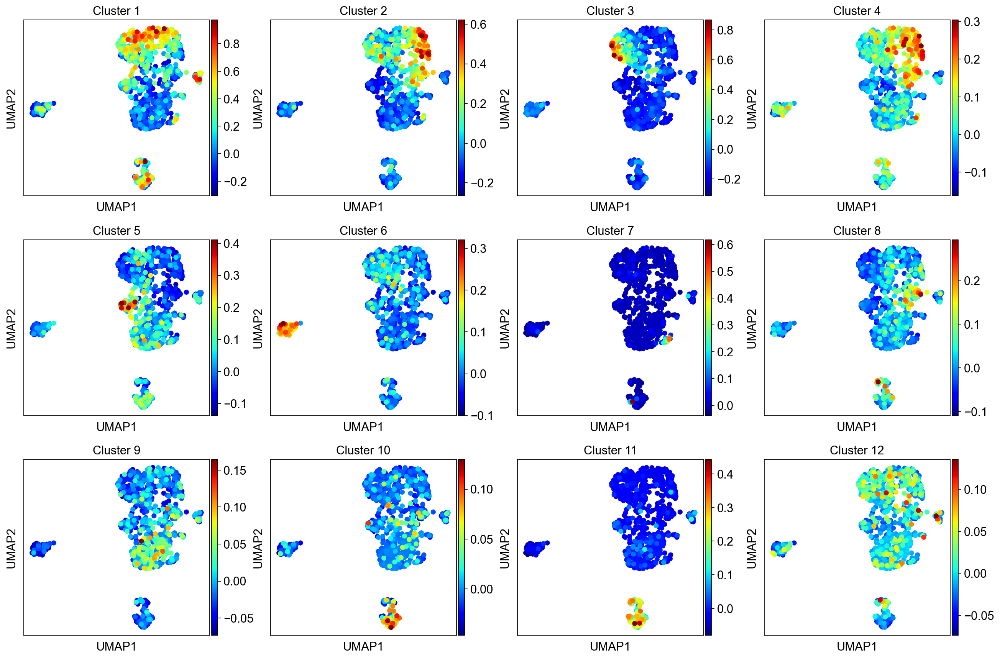

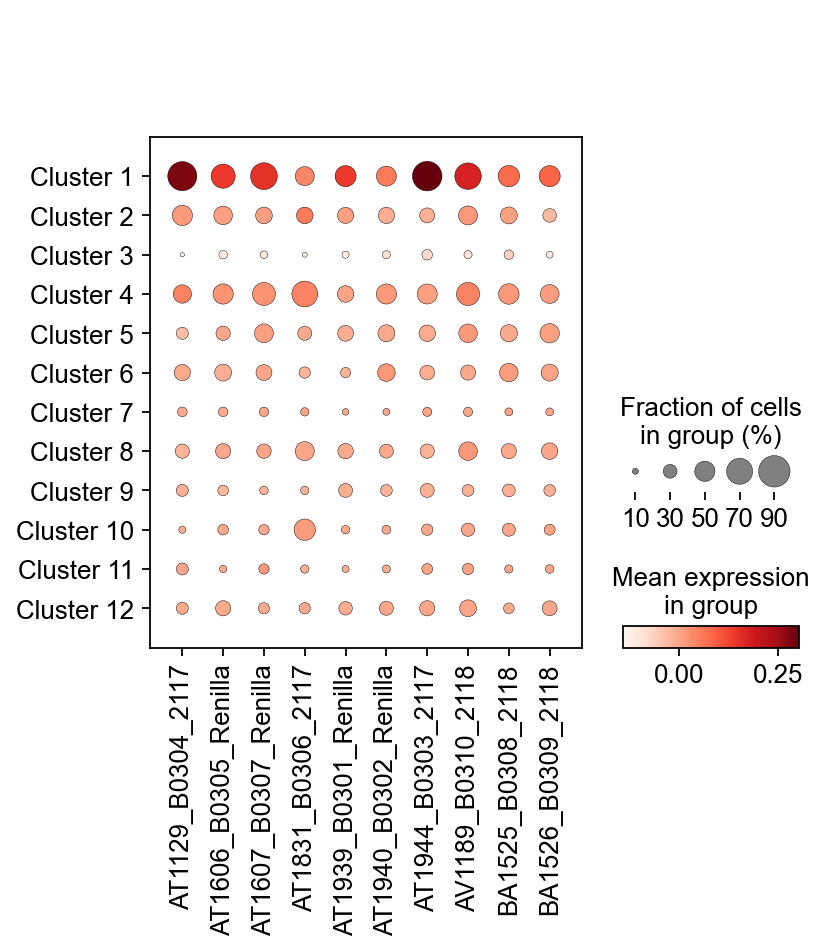

In [98]:
scoreAndPlot(adata)

## Clustering the neighborhood graph

As with Seurat and many other frameworks, we recommend the Leiden graph-clustering method (community detection based on optimizing modularity) by [Traag *et al.* (2018)](https://scanpy.readthedocs.io/en/latest/references.html#traag18). Note that Leiden clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.

In [99]:
#sc.tl.leiden(adata, resolution=0.30)
sc.tl.leiden(adata, resolution=0.35)

running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


Plot the clusters, which agree quite well with the result of Seurat.

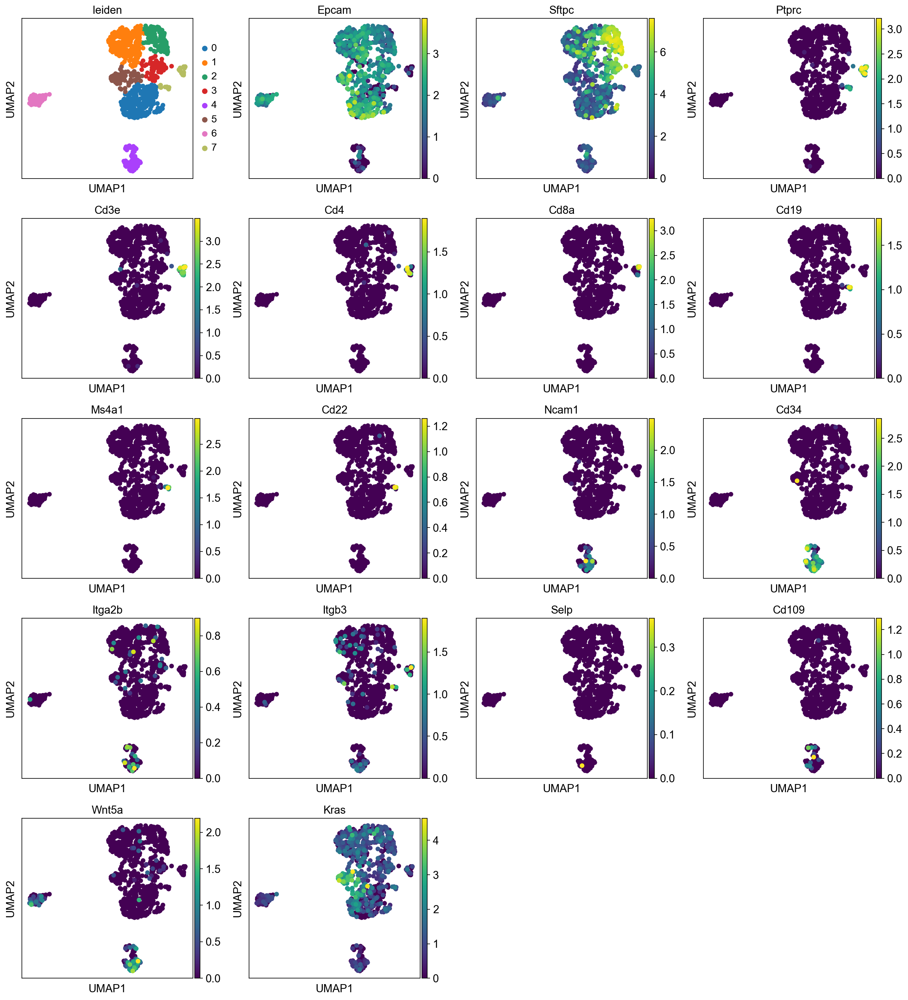

In [100]:
sc.pl.umap(adata, color=['leiden', 'Epcam', 'Sftpc', # Tumor cells
                         'Ptprc', #immune
                         'Cd3e', 'Cd4', 'Cd8a', #T cell
                         'Cd19', 'Ms4a1', 'Cd22', # B cell
                         #'Itgax', 'Il3ra', # Dendritic Cell
                         'Ncam1',# 'Ncr1', # NK Cell
                         'Cd34', # Hematopoetic stem cell
                         #'Cd14', 'Cd33', # macrophage
                         #'Ceacam8' # Granulocyte
                         'Itga2b', 'Itgb3', 'Selp', #platelet
                         #'Gypa',  # erythrocyte
                         #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         'Cd109', 'Wnt5a', 'Kras'])

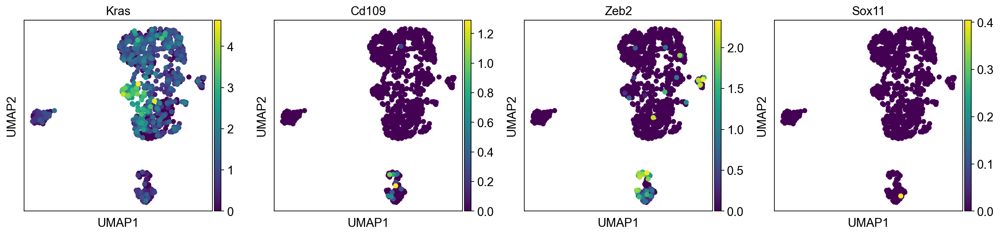

In [101]:
sc.pl.umap(adata, color=['Kras', 'Cd109', 'Zeb2', 'Sox11'])

Save the result.

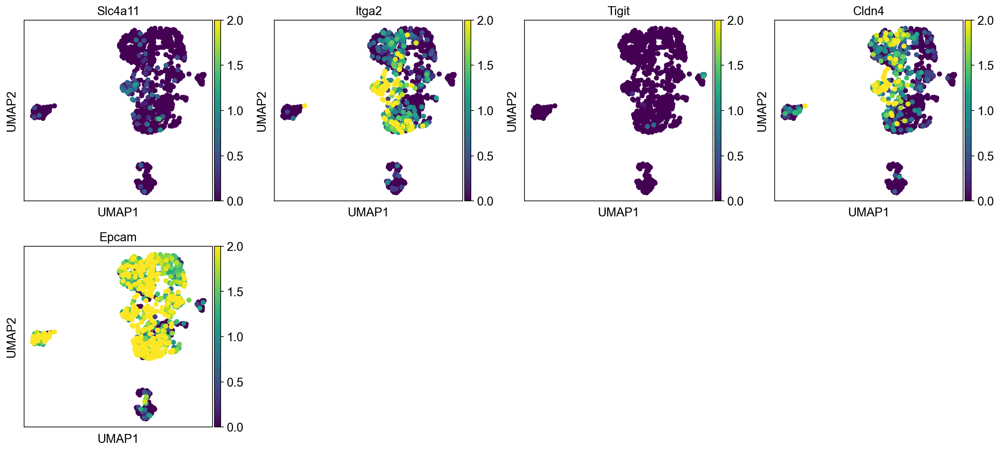

In [102]:
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Tigit', 'Cldn4','Epcam'], vmax=2)

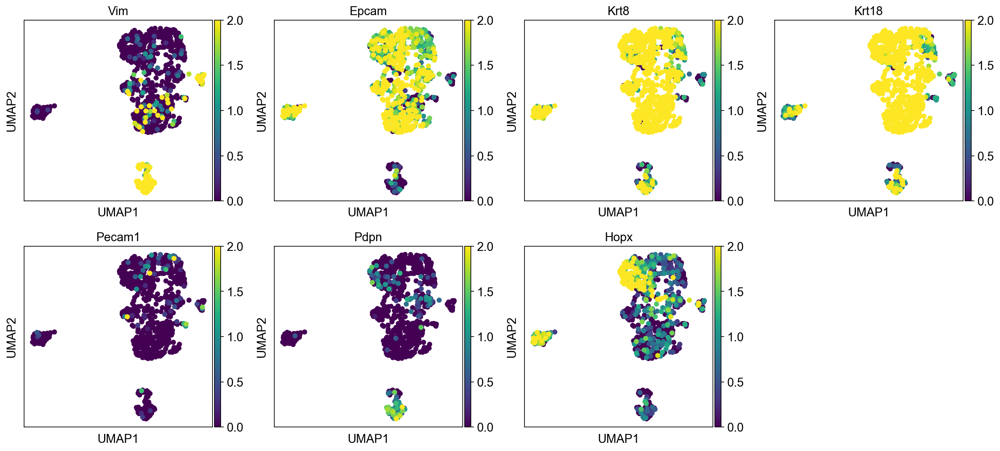

In [103]:
sc.pl.umap(adata, color=['Vim', 'Epcam', 'Krt8', 'Krt18','Pecam1', 'Pdpn', 'Hopx'], vmax=2)

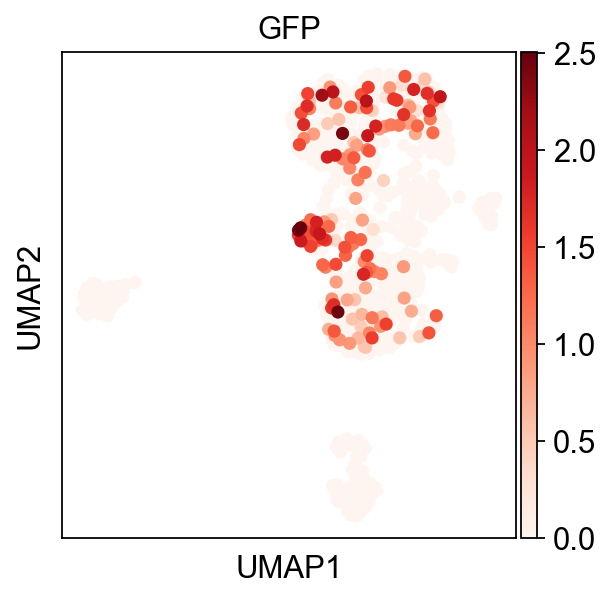

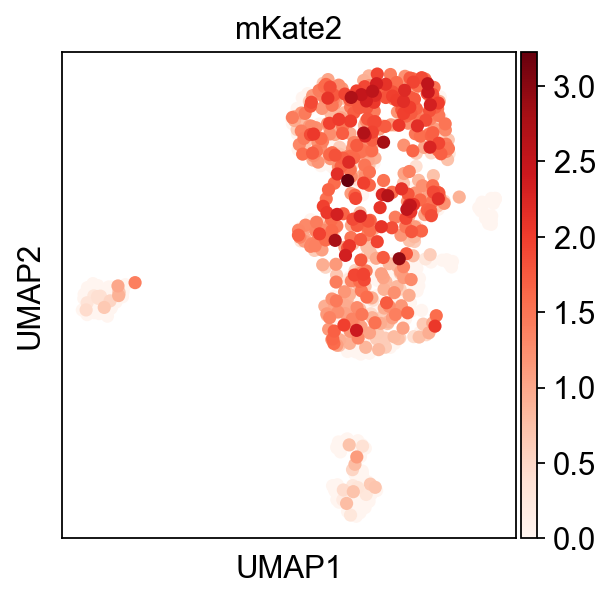

In [104]:
sc.pl.umap(adata, color=['GFP'], cmap='Reds')
sc.pl.umap(adata, color=['mKate2'], cmap='Reds')

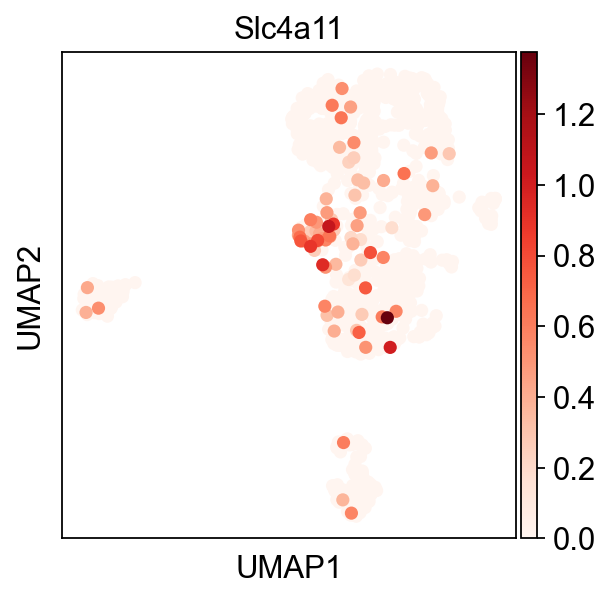

In [105]:
sc.pl.umap(adata, color=['Slc4a11'], cmap='Reds')

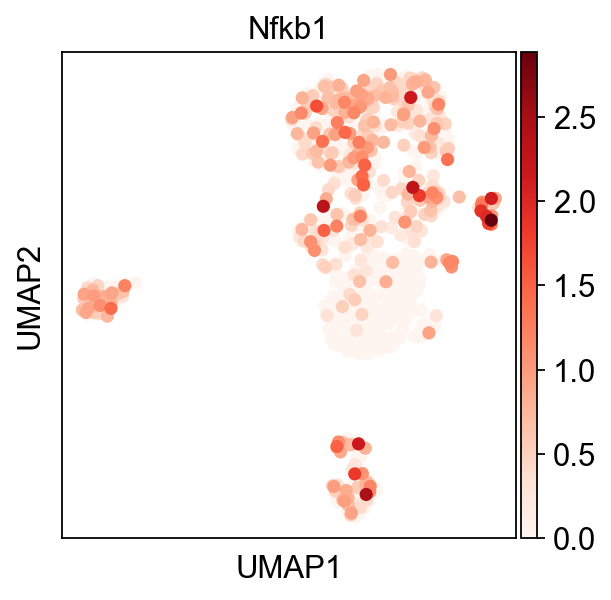

In [106]:
sc.pl.umap(adata, color=['Nfkb1'], cmap='Reds')

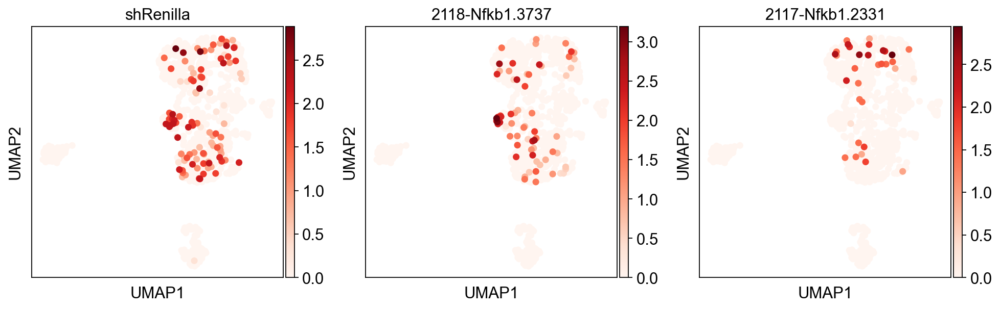

In [107]:
sc.pl.umap(adata, color=['shRenilla', "2118-Nfkb1.3737", "2117-Nfkb1.2331"], cmap='Reds')

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


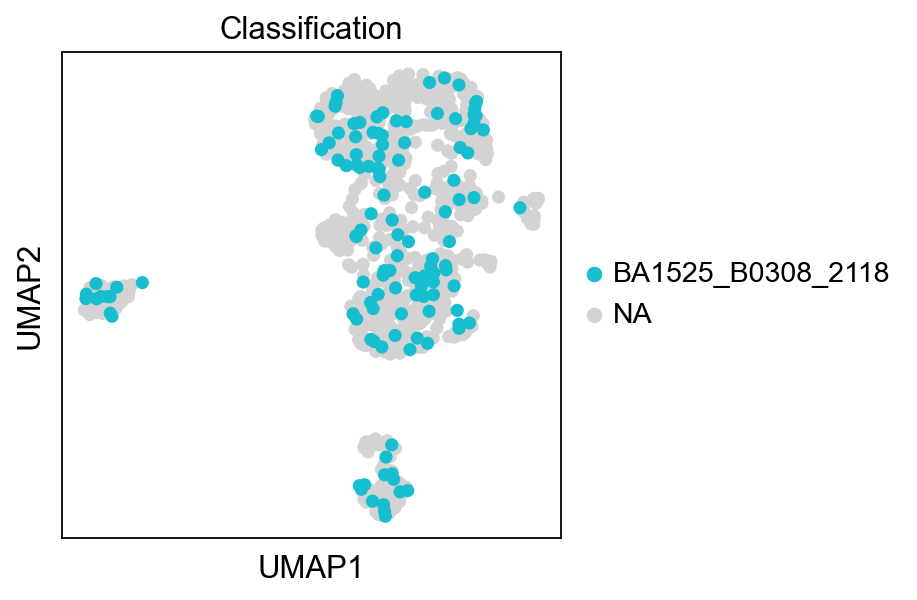

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


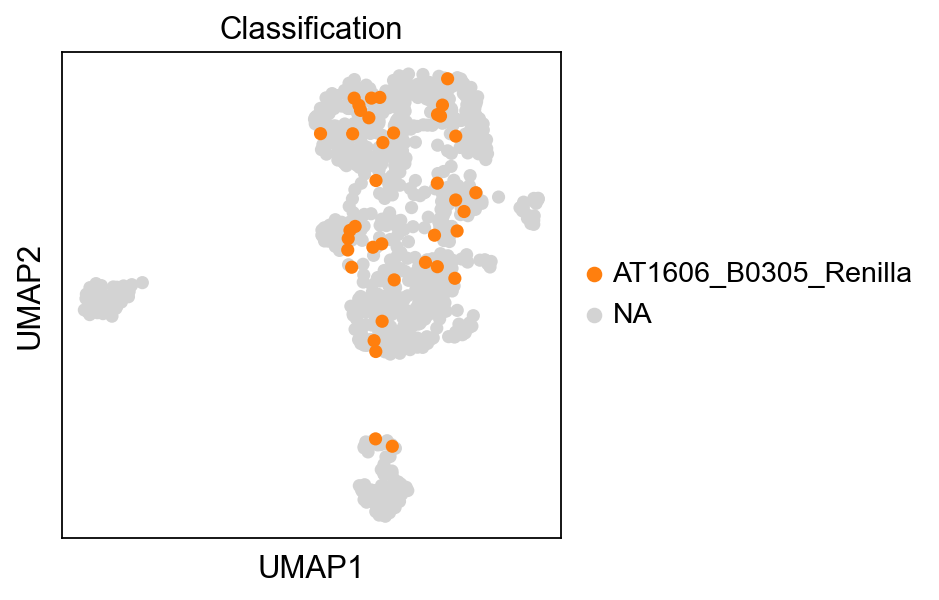

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


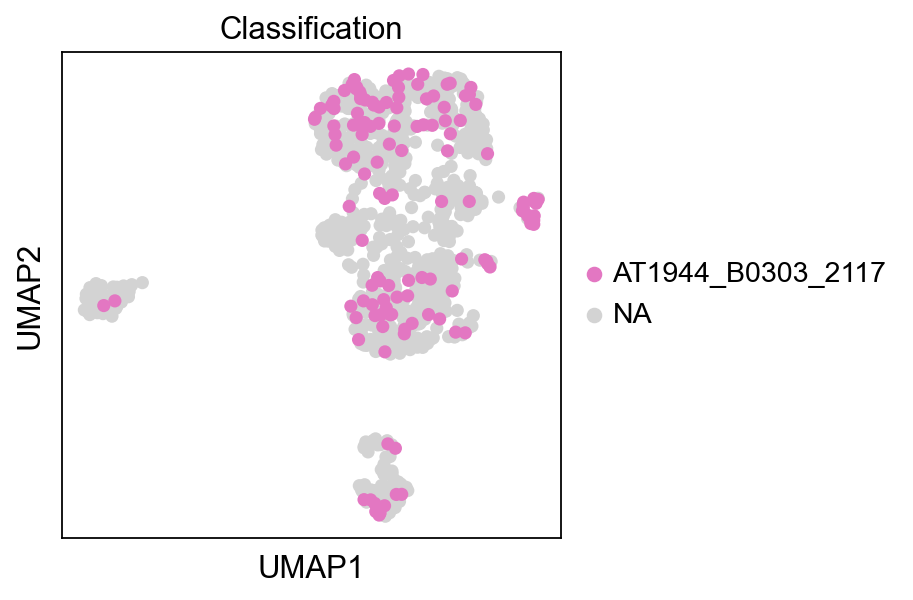

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


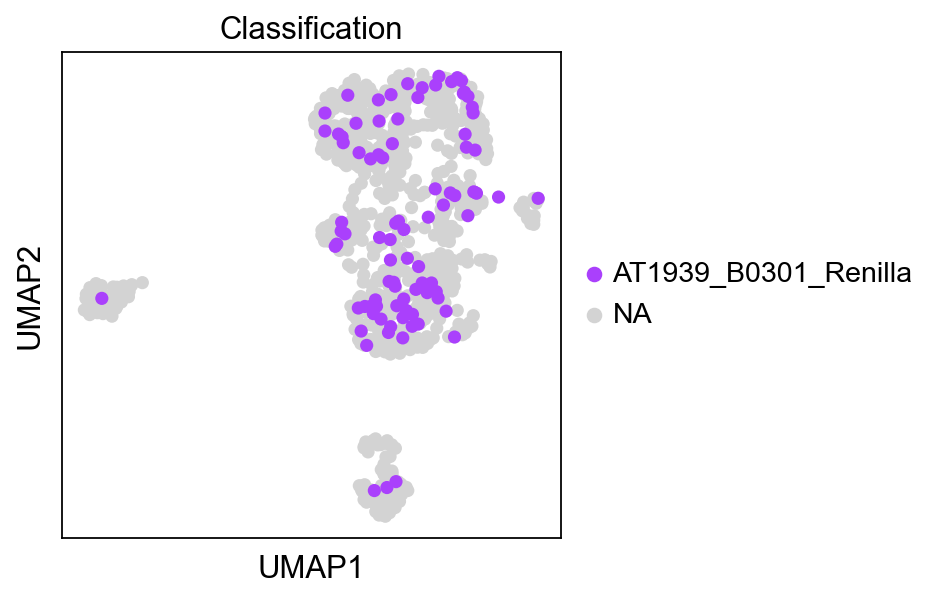

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


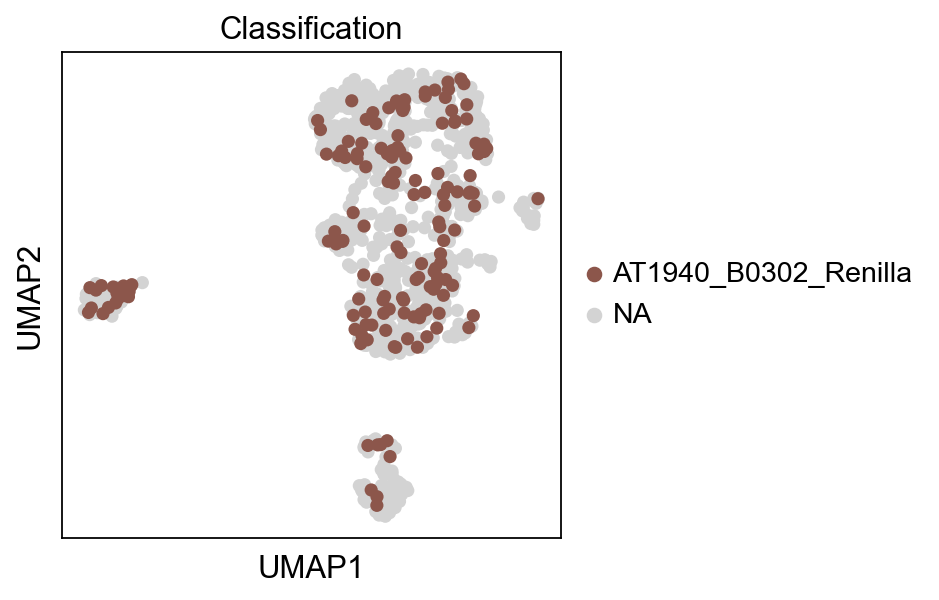

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


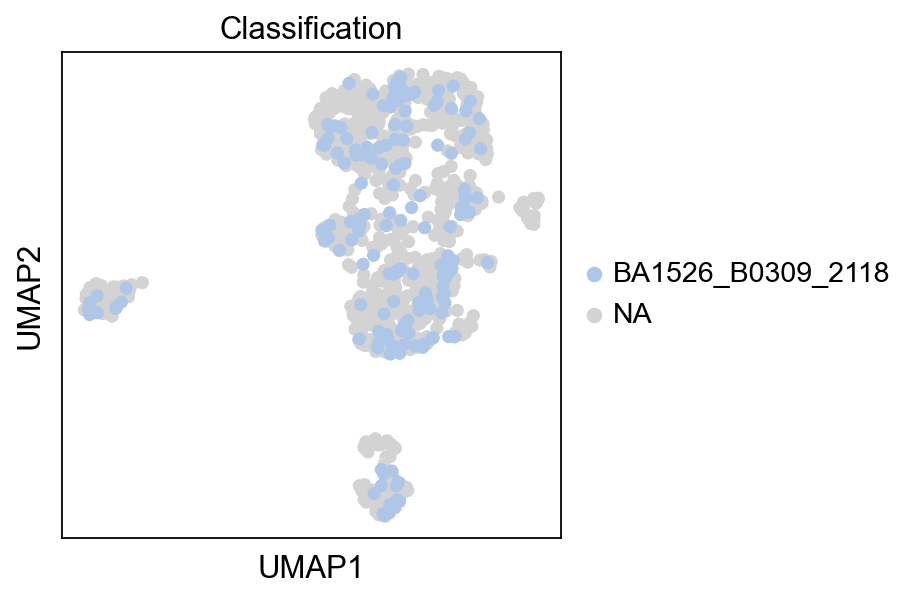

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


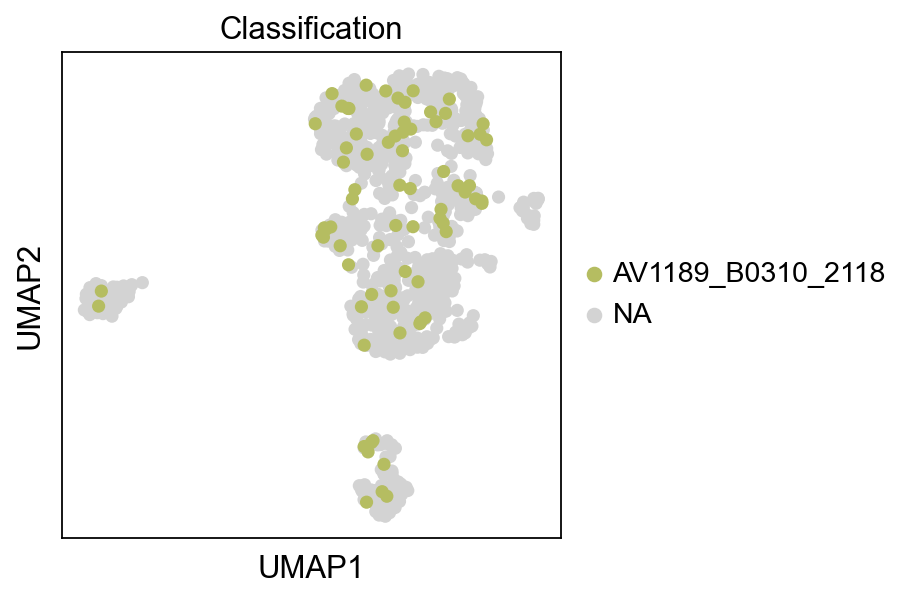

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


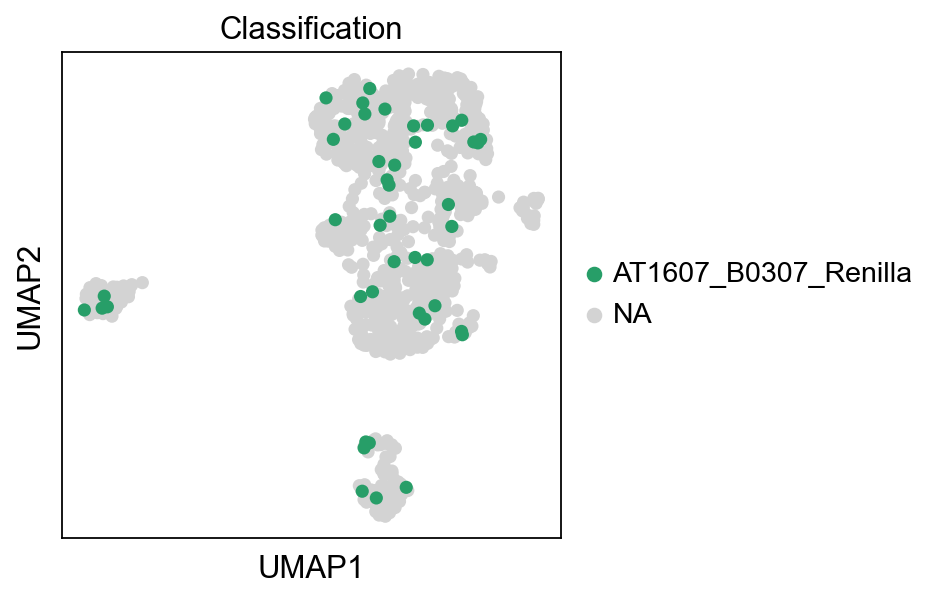

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


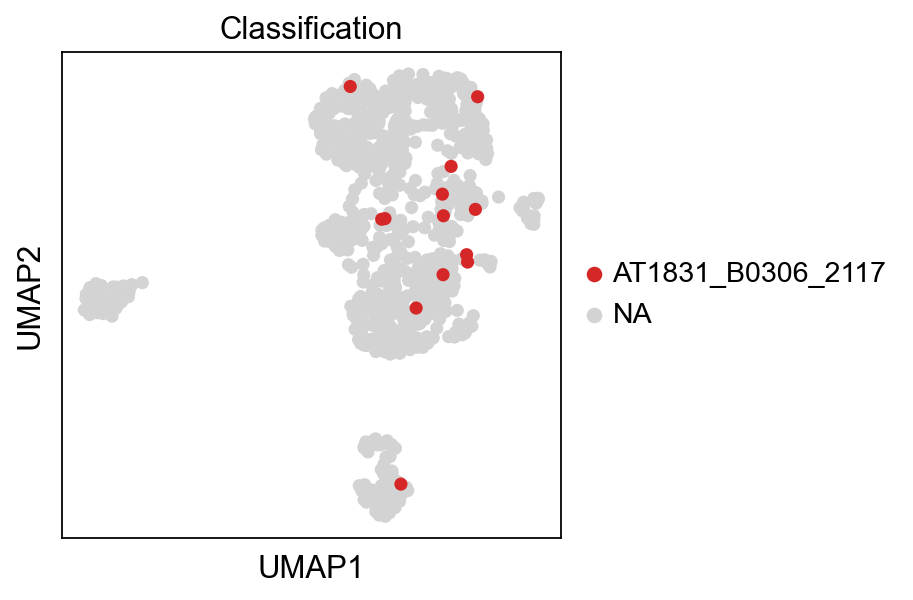

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


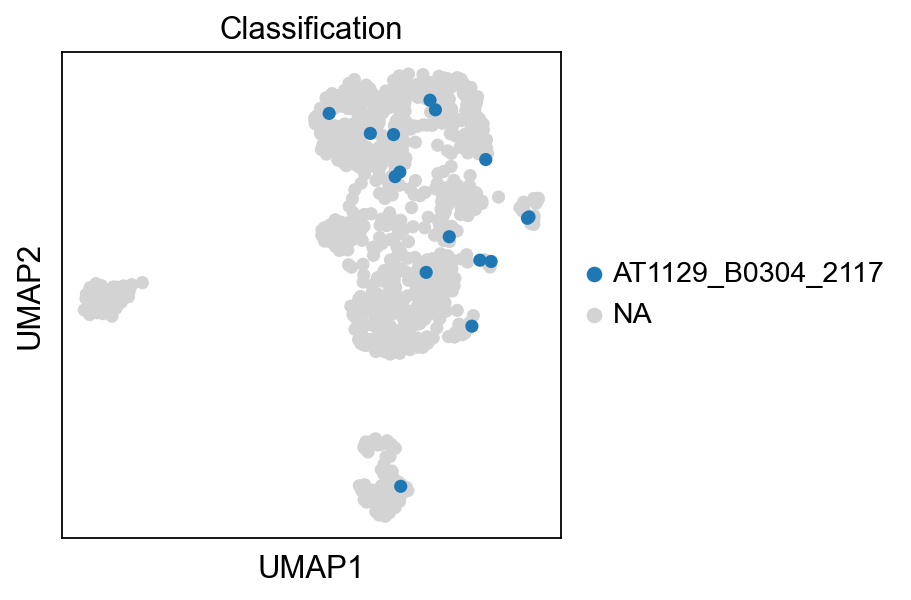

In [108]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [109]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p']['base'] = None

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


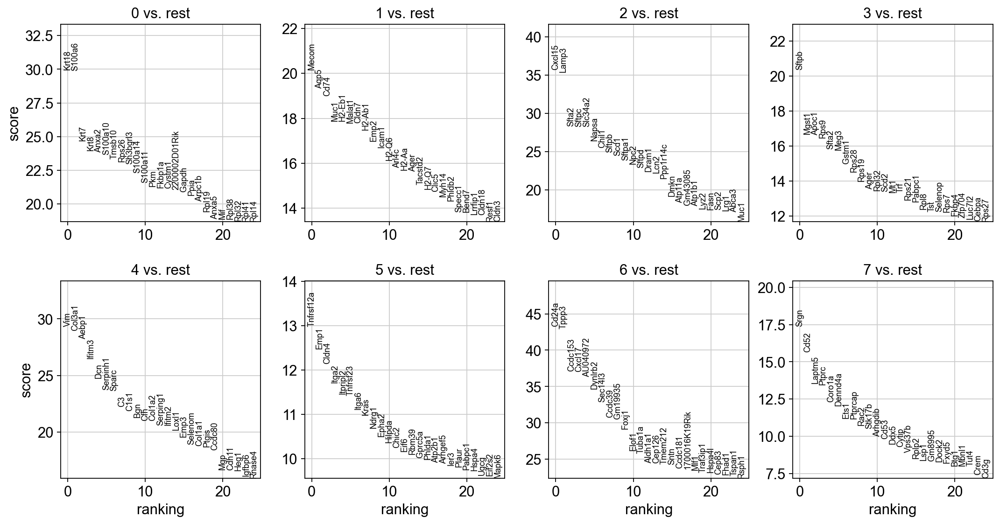

In [110]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

Cluster 1 appears to be fibroblasts based on Krt8 and Krt18 weak staining

In [111]:
adata.obs.keys()

Index(['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Renilla',
       '2117-Nfkb1', '2118-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA',
       'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5',
       'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10',
       'Cluster 11', 'Cluster 12', 'leiden'],
      dtype='object')

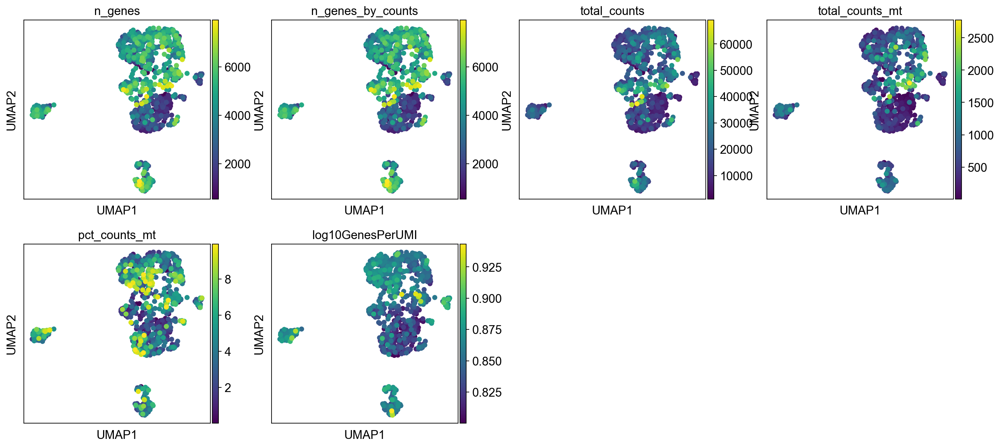

In [112]:
sc.pl.umap(adata,color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

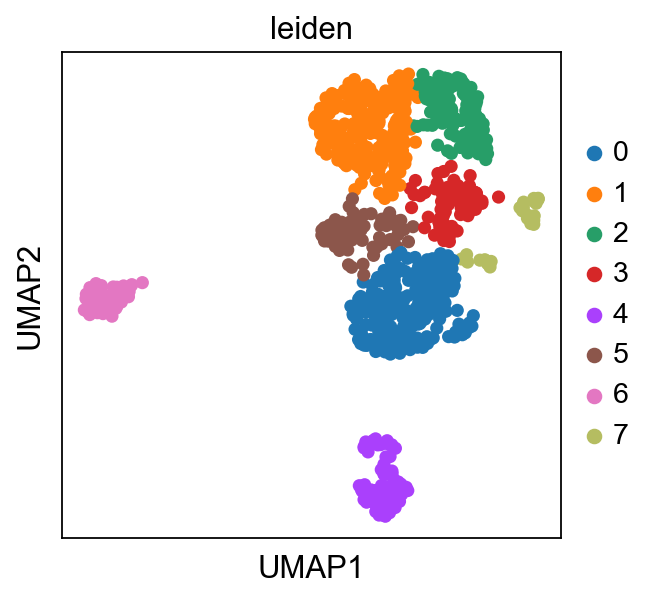

In [113]:
sc.pl.umap(adata,color='leiden')

In [114]:
adata

AnnData object with n_obs × n_vars = 854 × 4247
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Renilla', '2117-Nfkb1', '2118-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'Classification_colors', 'leiden', 'leiden_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [115]:
adata[adata.obs.leiden.isin(['0','1','2','3','5']),:]

View of AnnData object with n_obs × n_vars = 702 × 4247
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Renilla', '2117-Nfkb1', '2118-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'Classification_colors', 'leiden', 'leiden_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


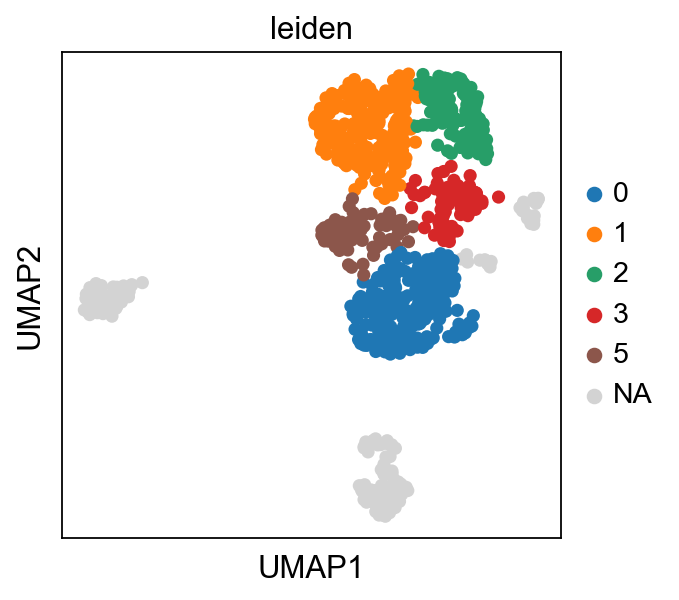

In [116]:
sc.pl.umap(adata, color=['leiden'], groups=['0','1','2','3','5',]) # cluster 3 seems to be fibroblasts

## End Analysis

In [117]:
# Select only those subset of cells that are useful
adata2 = sc.read('write/allmice-noSCT_lane1.h5ad')
adata = adata2[adata.obs['leiden'].isin(['0','1','2','3','5',]),:] # remove fibroblast cells
del adata2

In [118]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p']['base'] = None

In [119]:
sc.pp.highly_variable_genes(adata)#, batch_key='Classification')

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


In [120]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['GFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Cre'] = False
for x in library:
    adata.var.highly_variable[x] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/2494002207.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable['GFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/2494002207.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable['mKate2'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/2494002207.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#return

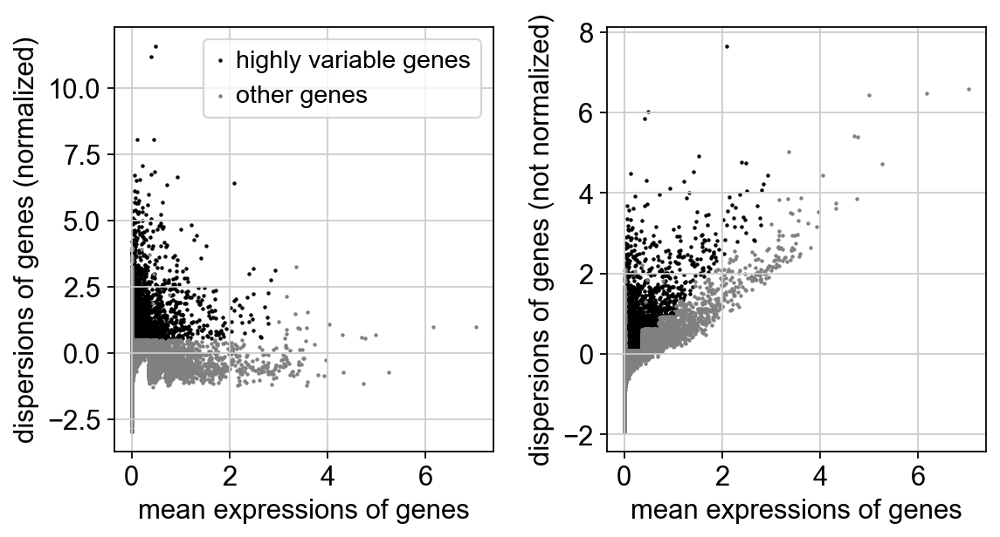

In [121]:
sc.pl.highly_variable_genes(adata)

In [122]:
adata.raw = adata

In [123]:
adata.write('write/allmice-tumornoSCT_lane1.h5ad', compression='gzip')
adata = sc.read('write/allmice-tumornoSCT_lane1.h5ad')

## Now rerun algorithm

In [124]:
adata = adata[:, adata.var.highly_variable]

In [125]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:06)


In [126]:
sc.pp.scale(adata, max_value=10)

## Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [127]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:00)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

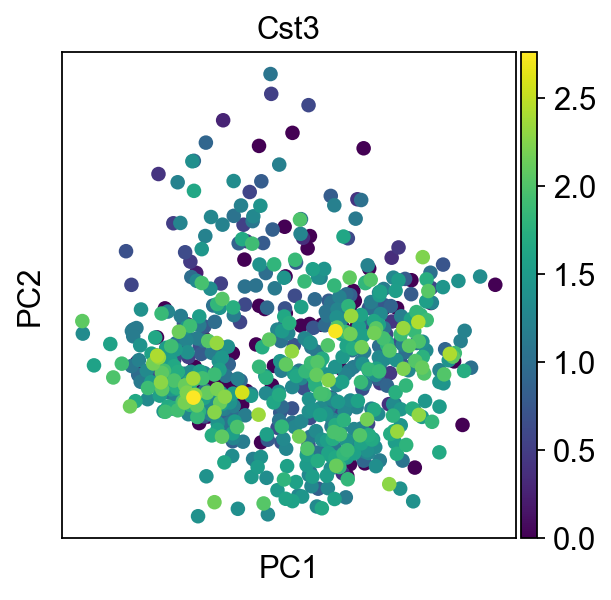

In [128]:
sc.pl.pca(adata, color='Cst3')

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`. In our experience, often a rough estimate of the number of PCs does fine.

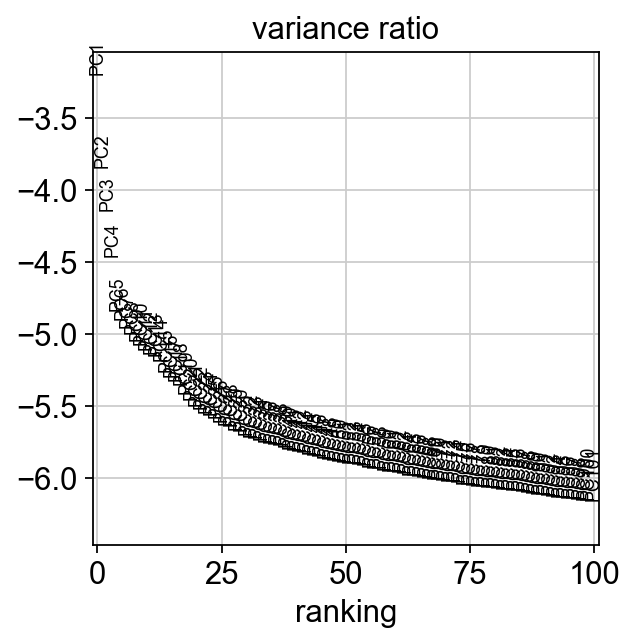

In [129]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=100)

Save the result.

In [130]:
adata.write(results_file, compression='gzip')

In [131]:
adata

AnnData object with n_obs × n_vars = 702 × 4284
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Renilla', '2117-Nfkb1', '2118-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [132]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


## Embedding the neighborhood graph

We suggest embedding the graph in two dimensions using UMAP ([McInnes et al., 2018](https://arxiv.org/abs/1802.03426)), see below. It is potentially more faithful to the global connectivity of the manifold than tSNE, i.e., it better preserves trajectories. In some ocassions, you might still observe disconnected clusters and similar connectivity violations. They can usually be remedied by running:

```
tl.paga(adata)
pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
tl.umap(adata, init_pos='paga')
```

In [133]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


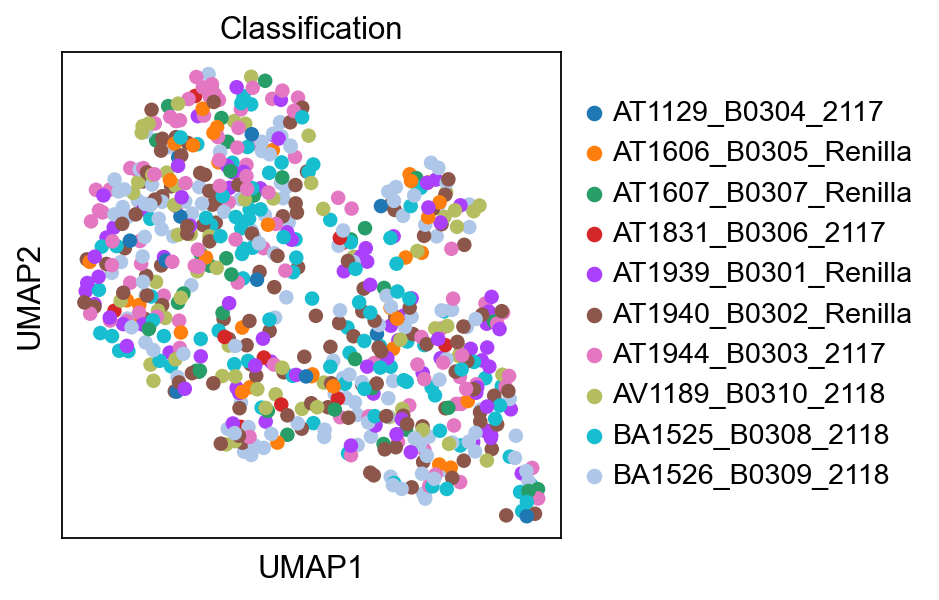

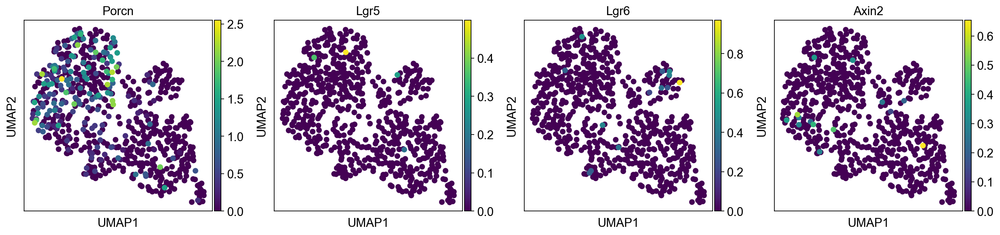

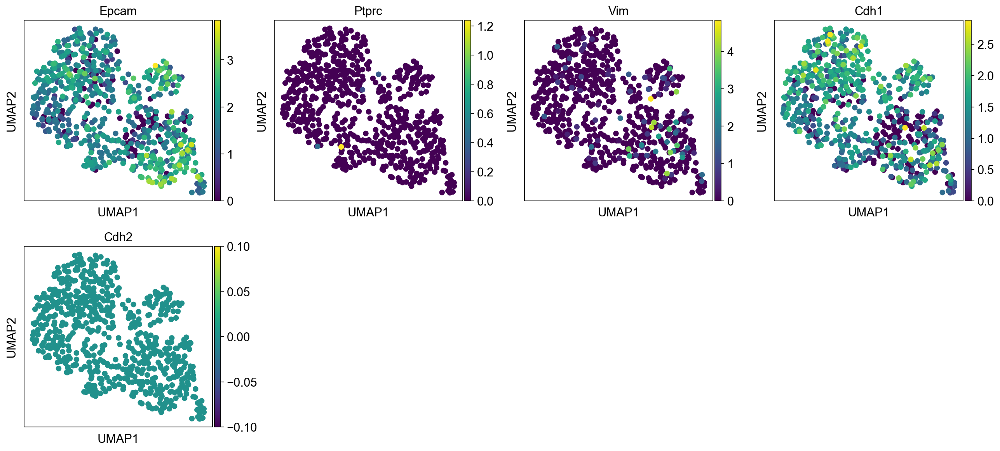

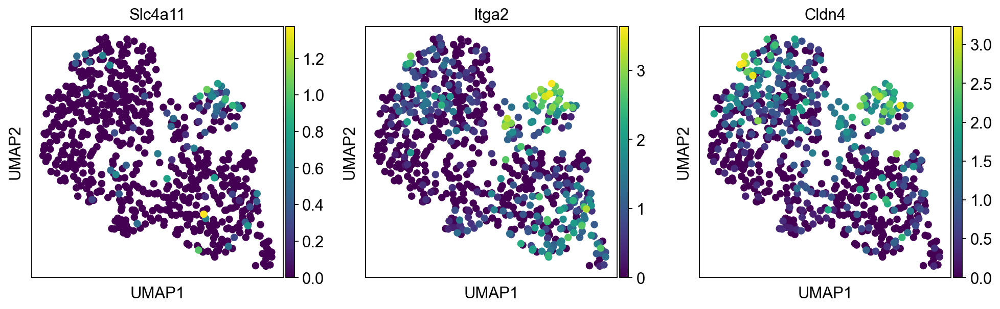

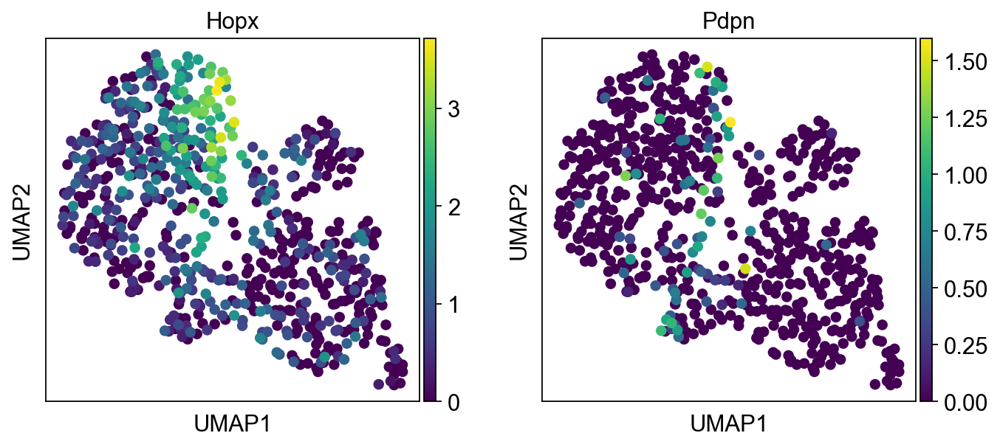

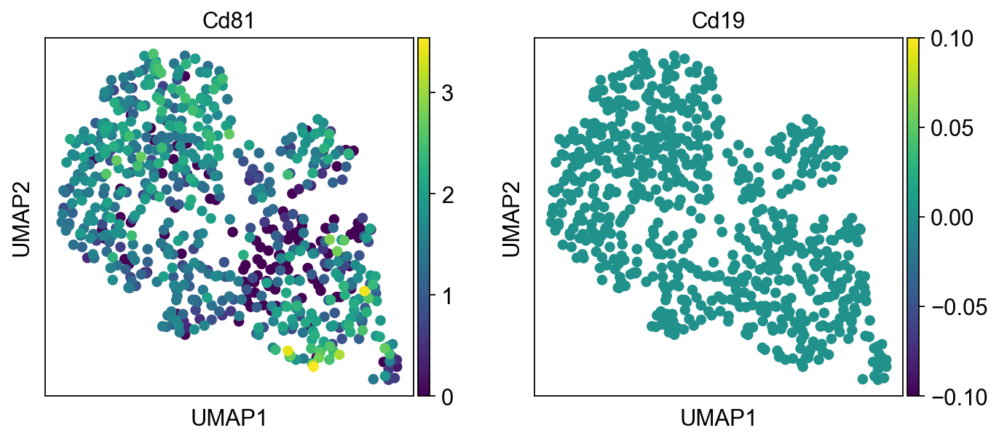

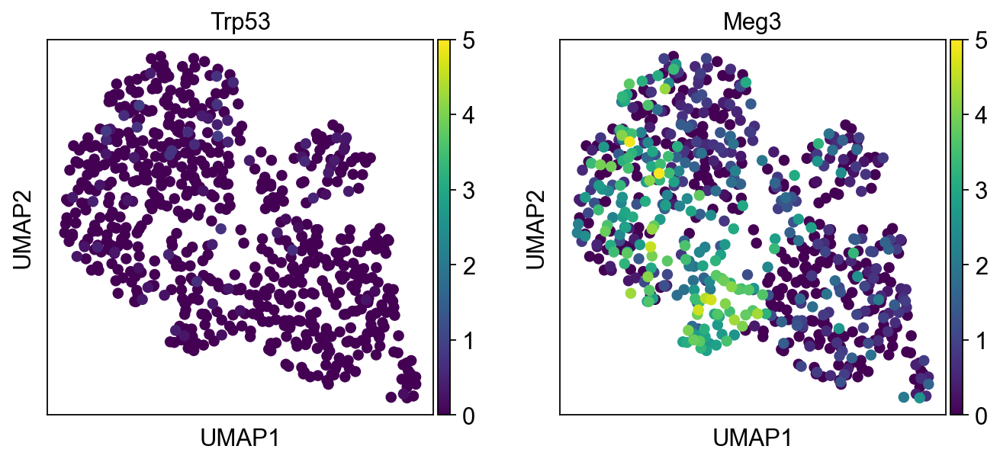

In [134]:
sc.pl.umap(adata, color=['Classification'])
sc.pl.umap(adata, color=['Porcn', 'Lgr5', 'Lgr6','Axin2']) #LGR5 not found #
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1','Cdh2']) #CDH2 not found
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])
sc.pl.umap(adata, color=['Cd81', 'Cd19'])
sc.pl.umap(adata, color=['Trp53','Meg3'], vmax=5)

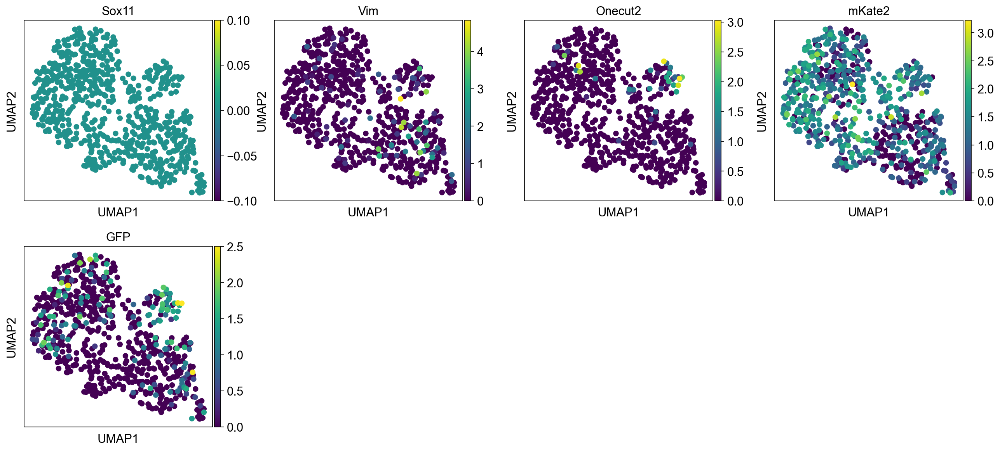

In [135]:
sc.pl.umap(adata, color=['Sox11', 'Vim', 'Onecut2', 'mKate2', 'GFP'])

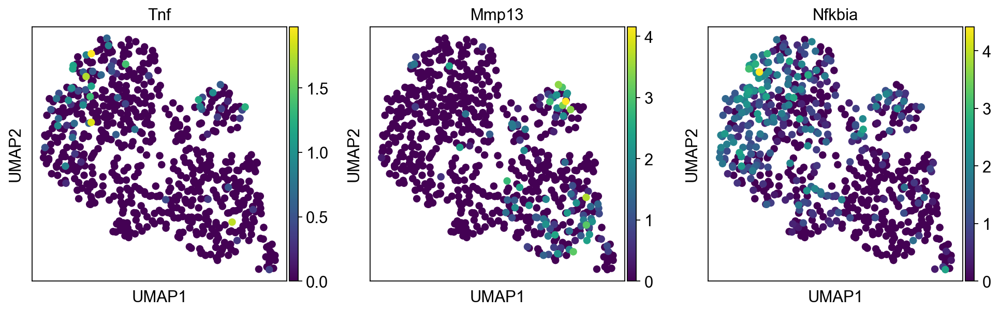

computing score 'score'
    finished: added
    'score', score of gene set (adata.obs).
    450 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


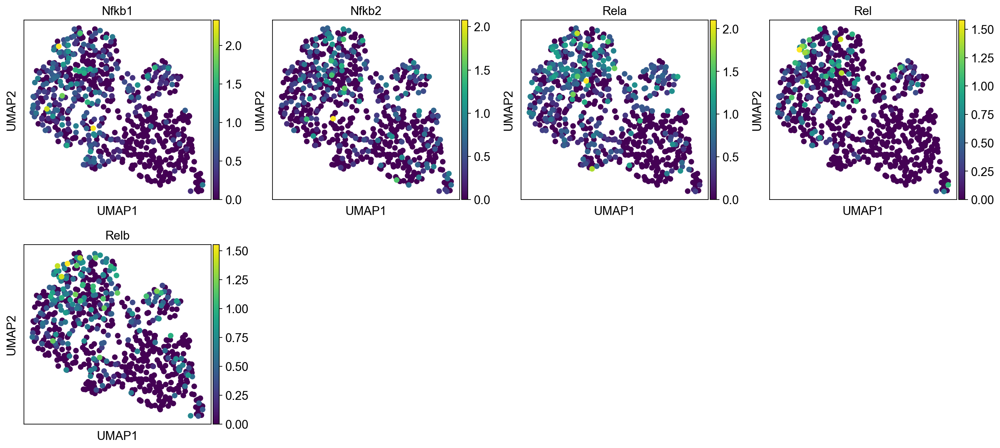

In [136]:
#NFkB targets
nfkb = ['Tnf', 'Mmp13','Nfkbia']
nfkball = ['Tnf', 'Mmp13', 'Nfkbia', 'Bcl2', 'Bcl2l1', 'Xiap', 'Birc2', 'Il6', 'Birc5', 'Ccnd1', 'Mmp3']
nfkbfactors = ['Nfkb1', 'Nfkb2', 'Rela', 'Rel', 'Relb']
sc.pl.umap(adata,color=nfkb)
sc.tl.score_genes(adata, nfkball)
sc.pl.umap(adata, color=nfkbfactors)

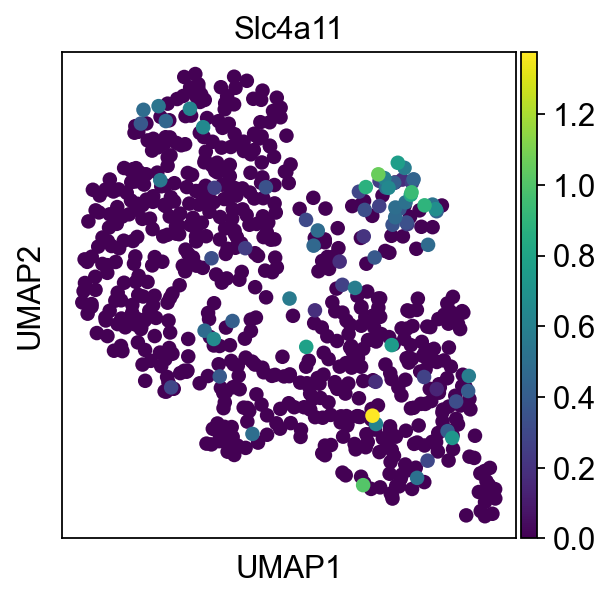

In [137]:
sc.pl.umap(adata, color='Slc4a11')

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    749 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    747 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    649 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    798 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    747 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and 

computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    848 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    599 total control genes are used. (0:00:00)
computing score 'Cluster 8'
    finished: added
    'Cluster 8', score of gene set (adata.obs).
    700 total control genes are used. (0:00:00)
computing score 'Cluster 9'
    finished: added
    'Cluster 9', score of gene set (adata.obs).
    798 total control genes are used. (0:00:00)
computing score 'Cluster 10'
    finished: added
    'Cluster 10', score of gene set (adata.obs).
    746 total control genes are used. (0:00:00)
computing score 'Cluster 11'


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and 

    finished: added
    'Cluster 11', score of gene set (adata.obs).
    595 total control genes are used. (0:00:00)
computing score 'Cluster 12'
    finished: added
    'Cluster 12', score of gene set (adata.obs).
    749 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


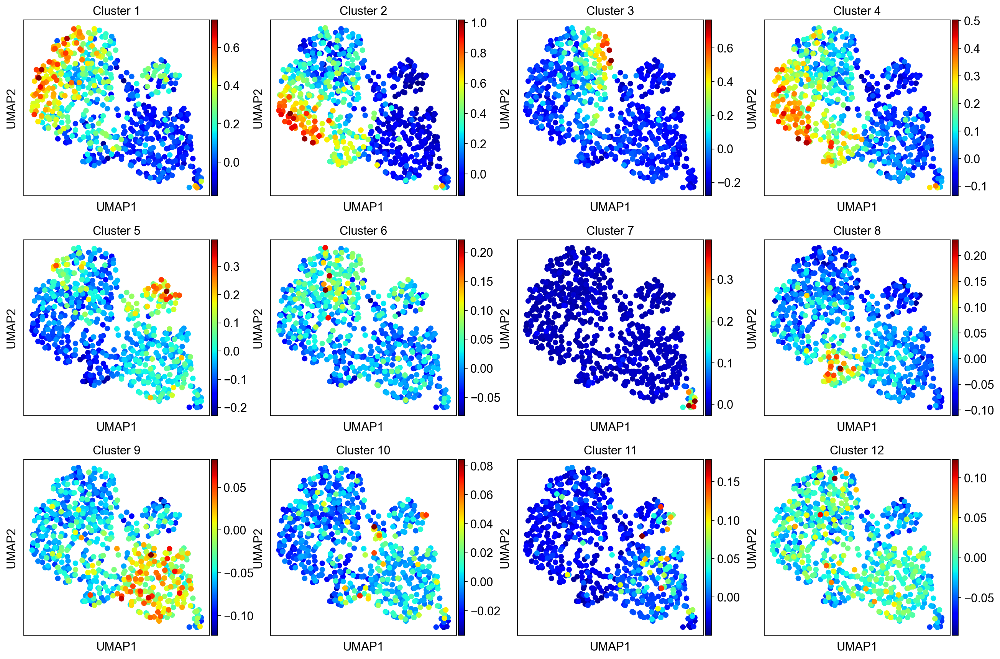

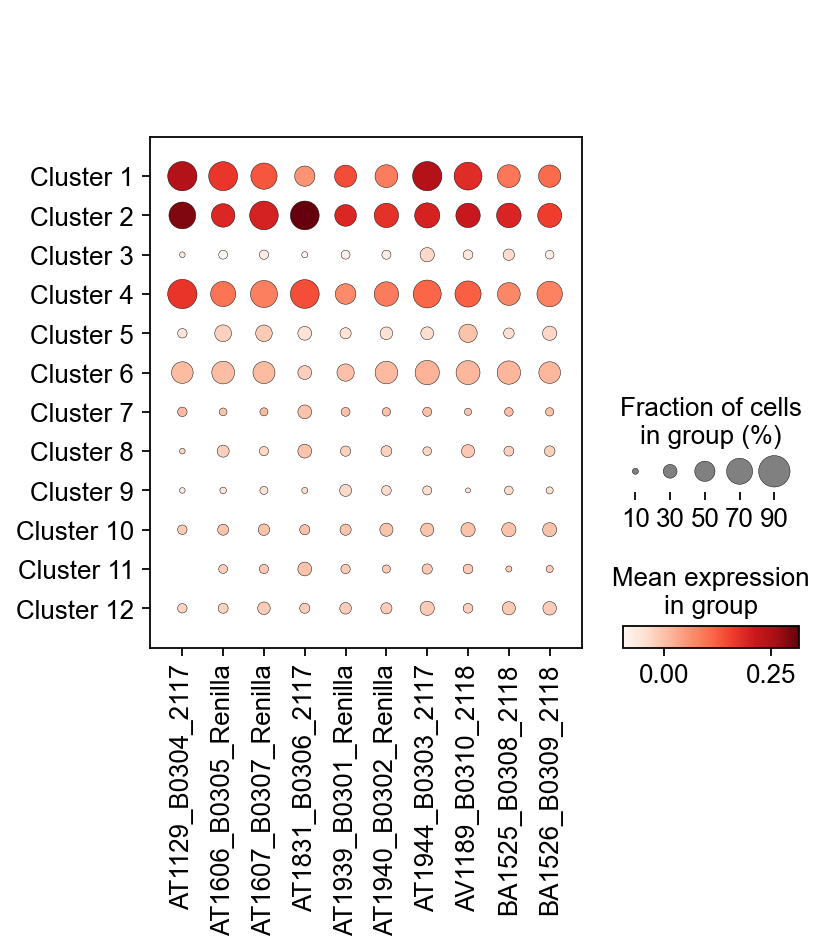

In [138]:
scoreAndPlot(adata, numgenes=50)

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    395 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


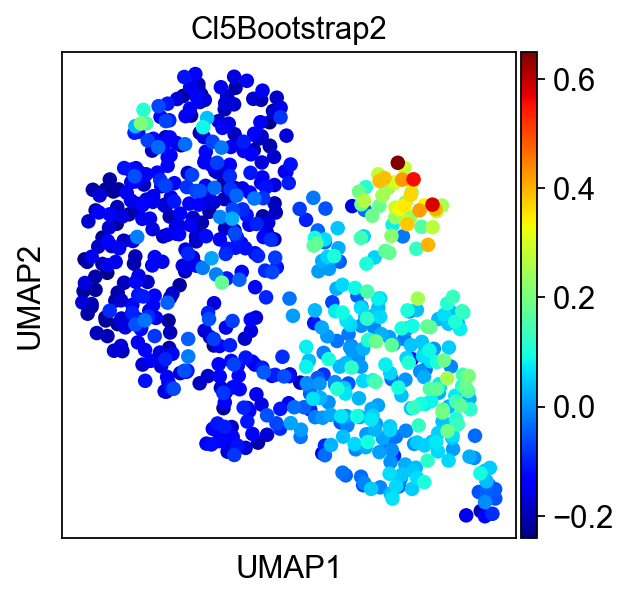

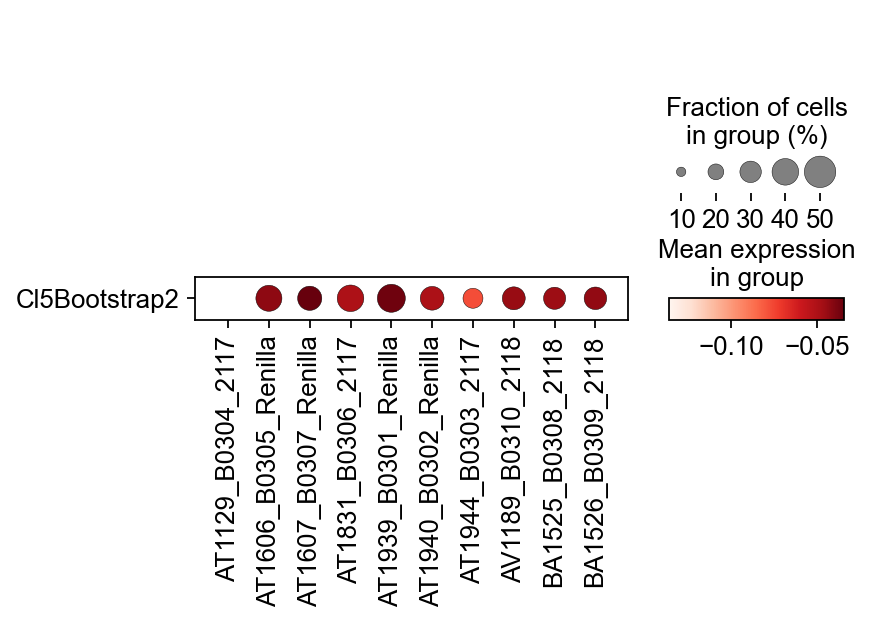

In [139]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(adata,numgenes=100)

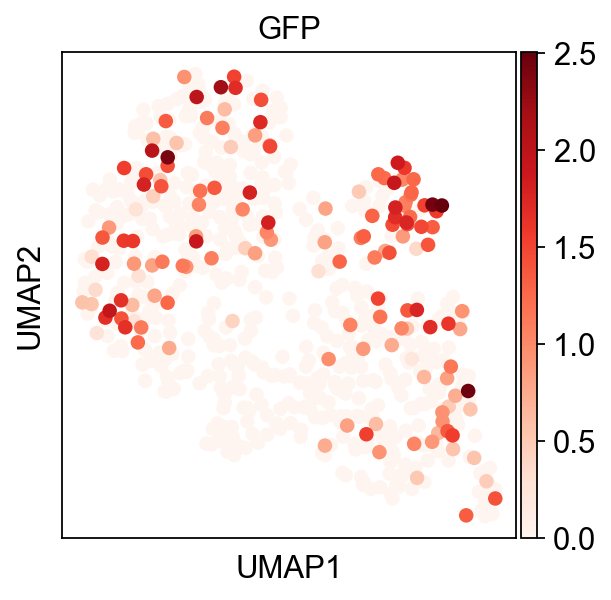

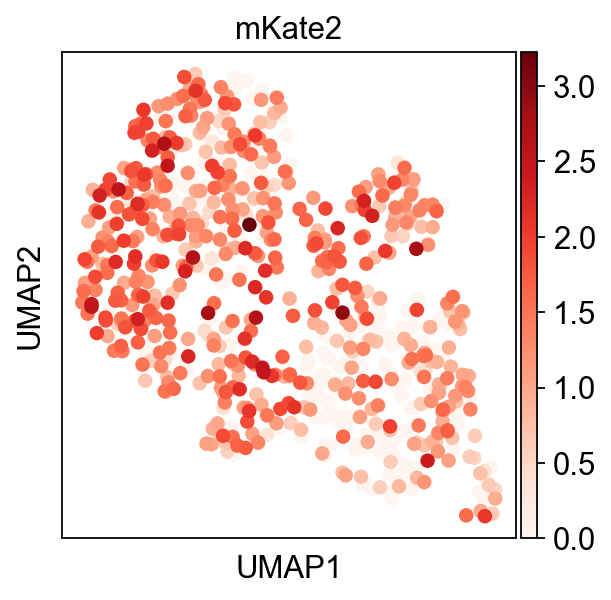

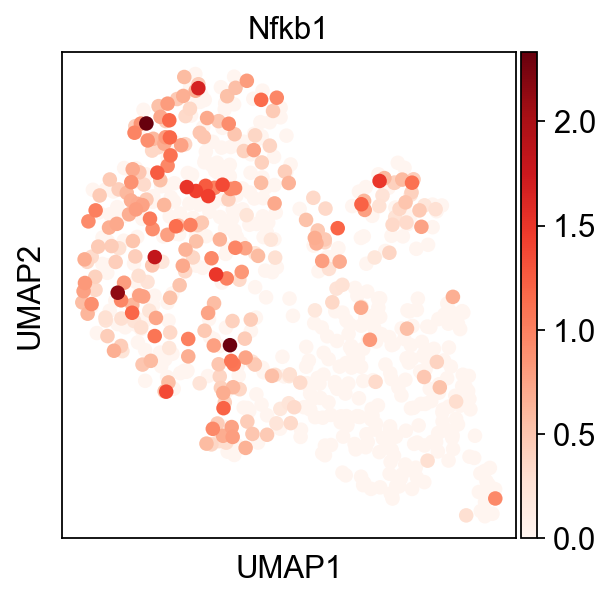

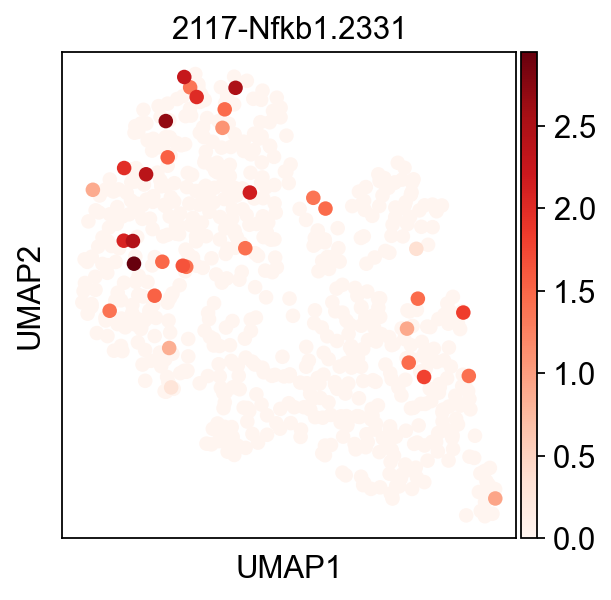

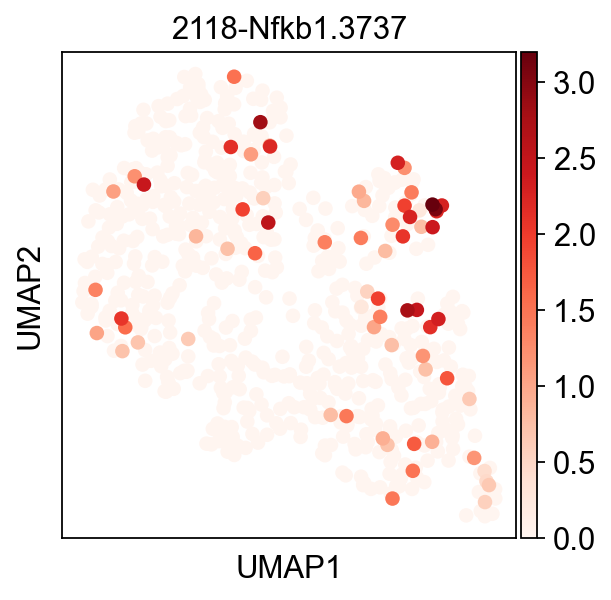

In [140]:
sc.pl.umap(adata, color=['GFP'], cmap='Reds')
sc.pl.umap(adata, color=['mKate2'], cmap='Reds')
sc.pl.umap(adata, color=['Nfkb1'], cmap='Reds')
sc.pl.umap(adata, color=["2117-Nfkb1.2331"], cmap='Reds')
sc.pl.umap(adata, color=["2118-Nfkb1.3737"], cmap='Reds')

In [141]:
adata.obs.keys()

Index(['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Renilla',
       '2117-Nfkb1', '2118-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA', 'score',
       'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5',
       'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10',
       'Cluster 11', 'Cluster 12', 'Cl5Bootstrap2'],
      dtype='object')

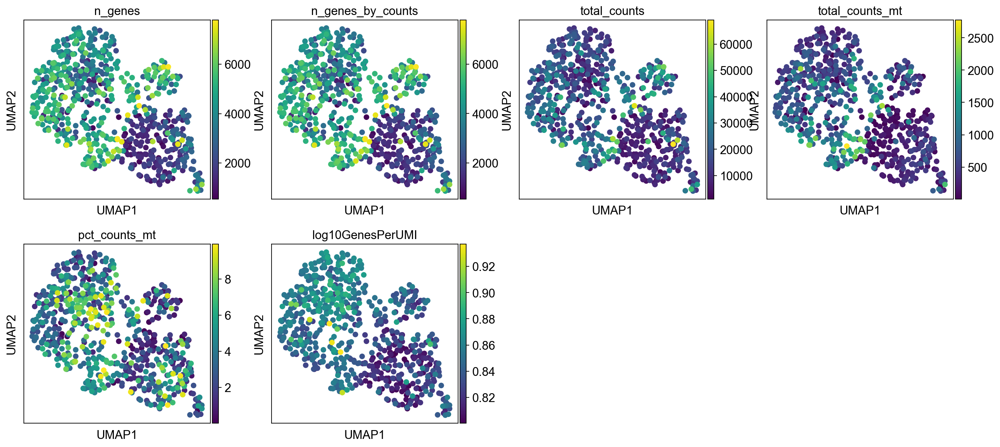

In [142]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

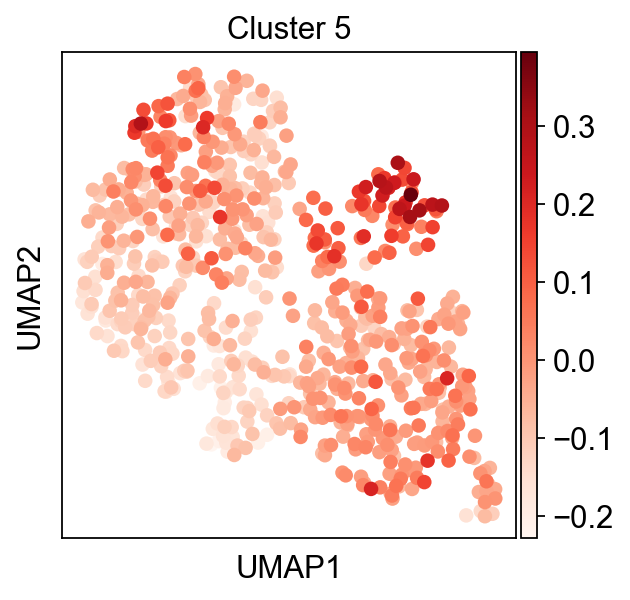

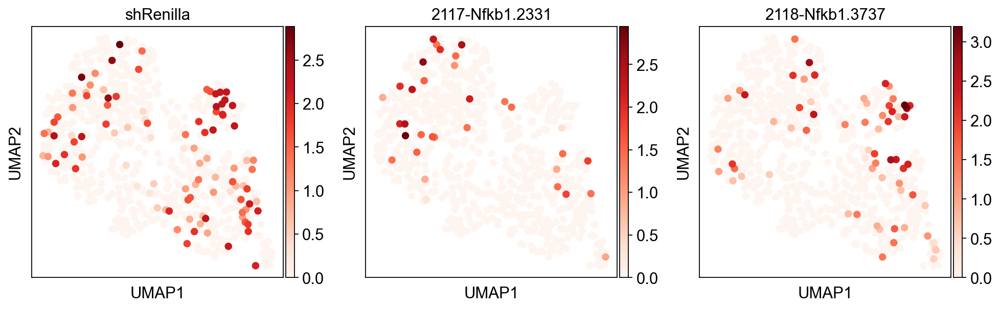

In [143]:
sc.pl.umap(adata,color='Cluster 5', cmap='Reds')
sc.pl.umap(adata, color=['shRenilla', "2117-Nfkb1.2331","2118-Nfkb1.3737"], cmap='Reds')

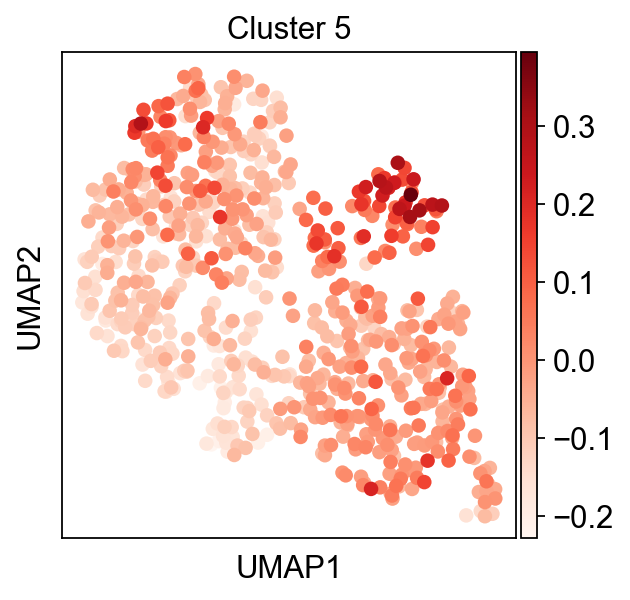

In [144]:
sc.pl.umap(adata,color='Cluster 5', cmap='Reds')

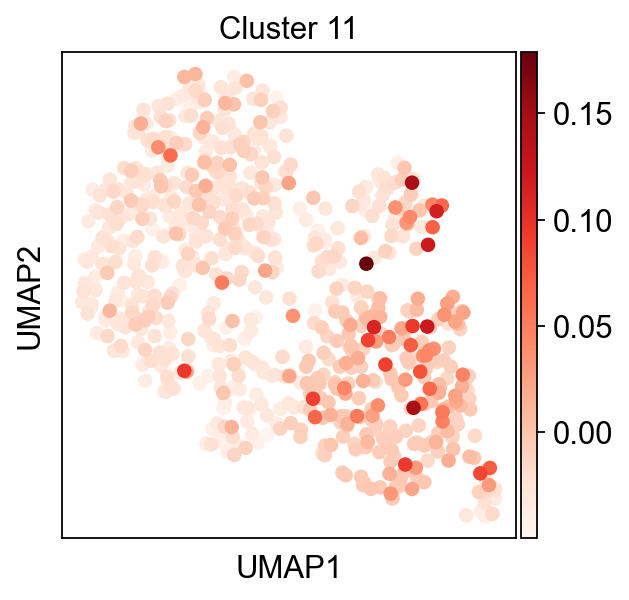

In [145]:
sc.pl.umap(adata,color='Cluster 11', cmap='Reds')

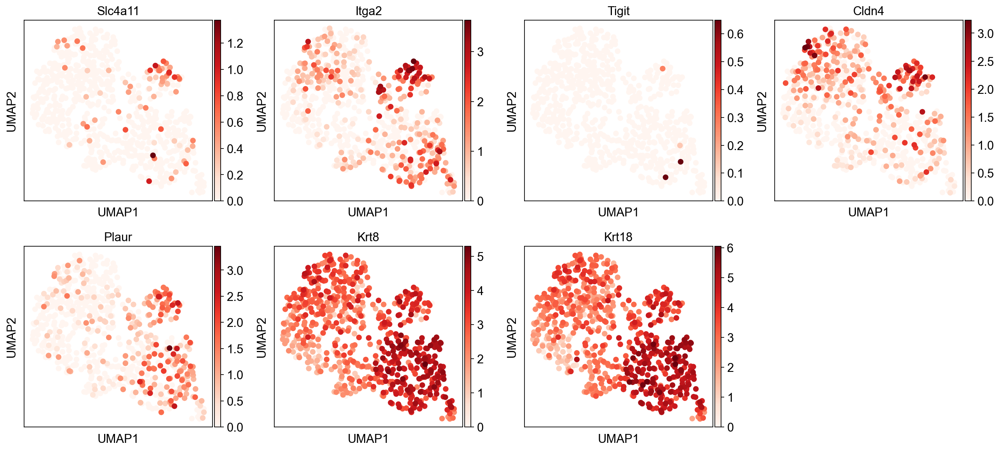

In [146]:
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Tigit', 'Cldn4', 'Plaur', 'Krt8', 'Krt18'], cmap='Reds')

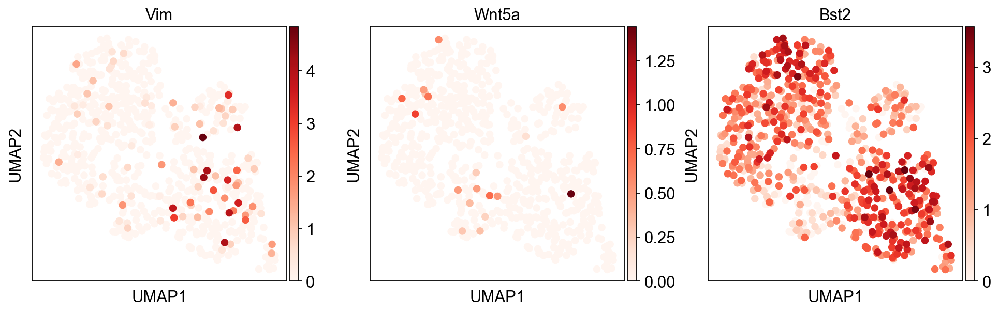

In [147]:
sc.pl.umap(adata, color=['Vim','Wnt5a','Bst2'], cmap='Reds')

In [148]:
sc.tl.embedding_density(adata, basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


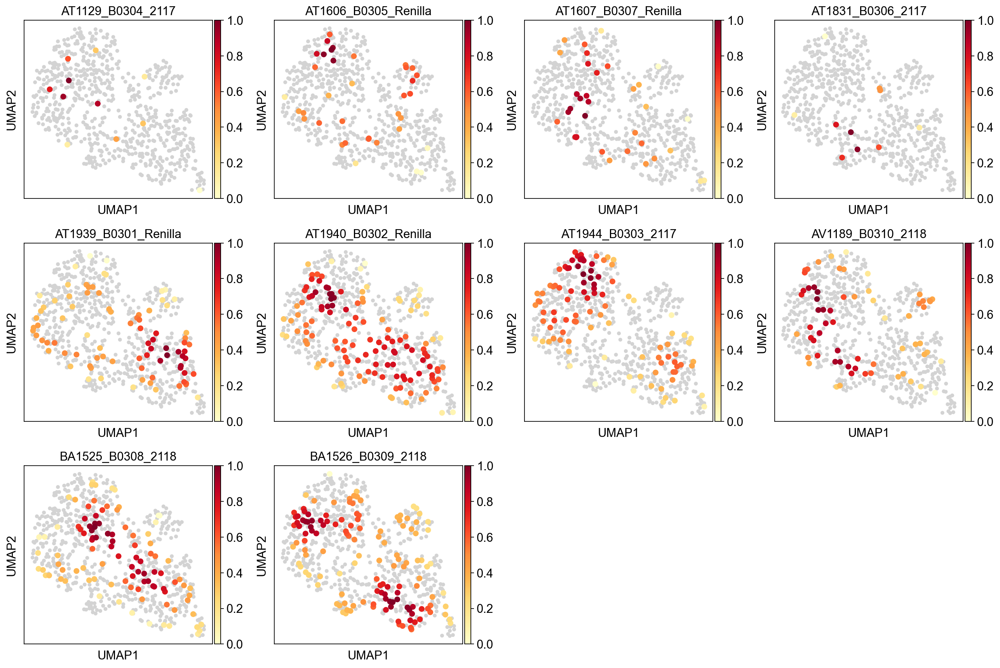

In [149]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Classification')

In [150]:
sc.tl.embedding_density(adata, basis='umap', groupby='shRNA')

computing density on 'umap'
--> added
    'umap_density_shRNA', densities (adata.obs)
    'umap_density_shRNA_params', parameter (adata.uns)


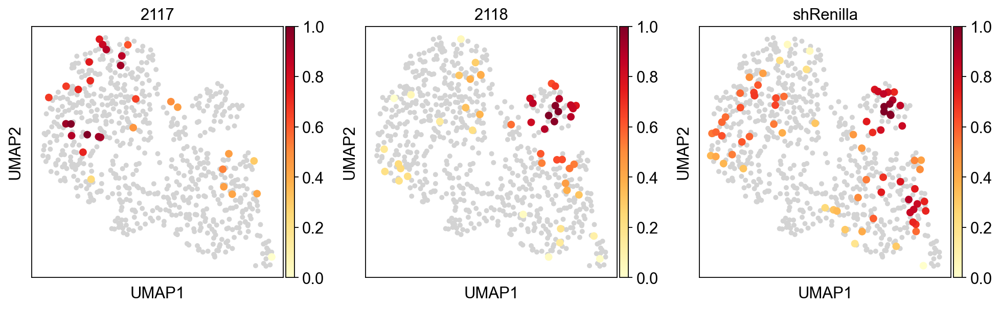

In [151]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_shRNA')

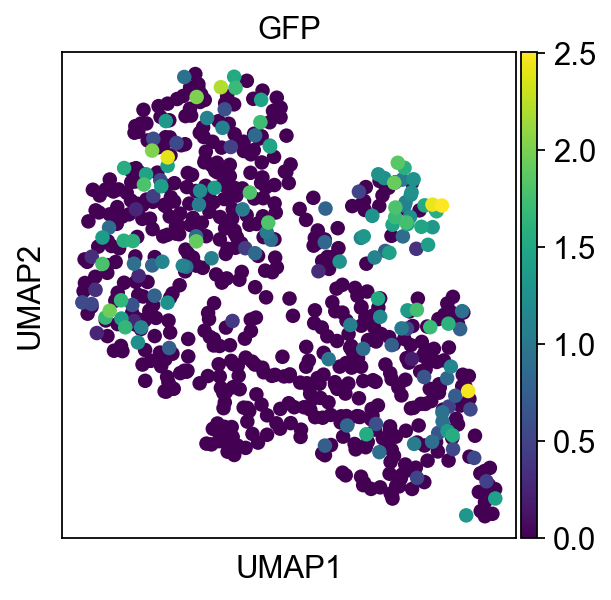

In [152]:
sc.pl.umap(adata, color='GFP')

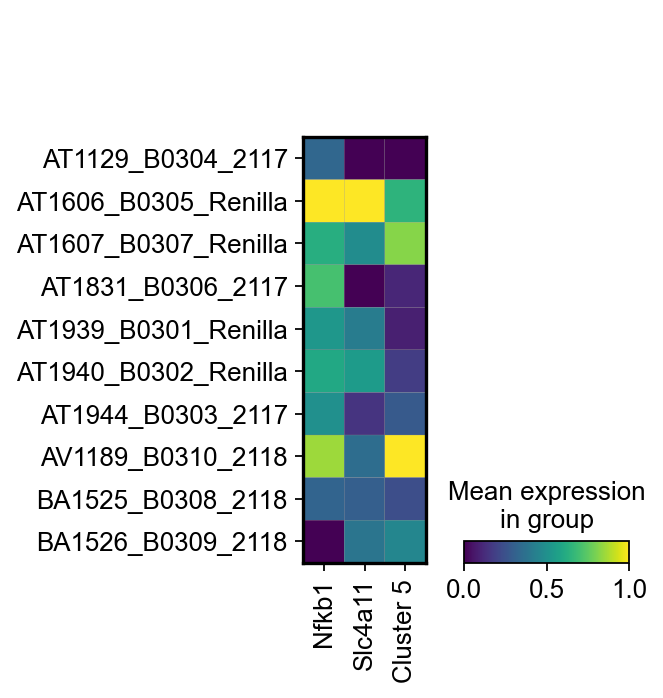

In [153]:
sc.pl.matrixplot(adata, ['Nfkb1','Slc4a11','Cluster 5'], groupby='Classification', standard_scale='var')

In [154]:
adata.obs.Classification.value_counts()

BA1526_B0309_2118       137
AT1940_B0302_Renilla    128
AT1944_B0303_2117        99
BA1525_B0308_2118        99
AT1939_B0301_Renilla     84
AV1189_B0310_2118        64
AT1606_B0305_Renilla     36
AT1607_B0307_Renilla     34
AT1129_B0304_2117        11
AT1831_B0306_2117        10
Name: Classification, dtype: int64

## Clustering the neighborhood graph

As with Seurat and many other frameworks, we recommend the Leiden graph-clustering method (community detection based on optimizing modularity) by [Traag *et al.* (2018)](https://scanpy.readthedocs.io/en/latest/references.html#traag18). Note that Leiden clustering directly clusters the neighborhood graph of cells, which we already computed in the previous section.

running Leiden clustering
    finished: found 4 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


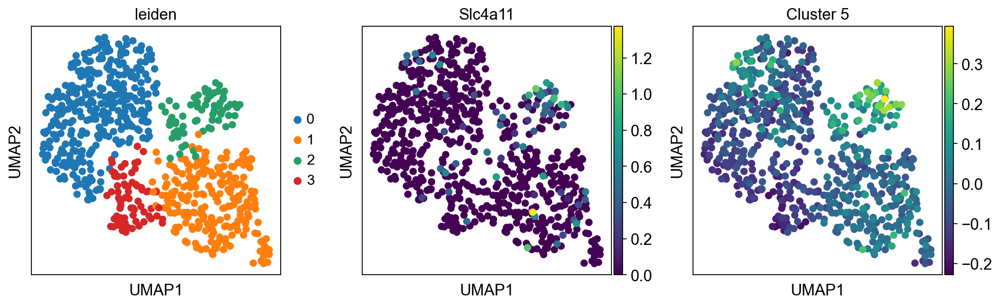

In [155]:
sc.tl.leiden(adata, resolution=.3)
sc.pl.umap(adata, color=['leiden','Slc4a11','Cluster 5'])

Plot the clusters, which agree quite well with the result of Seurat.

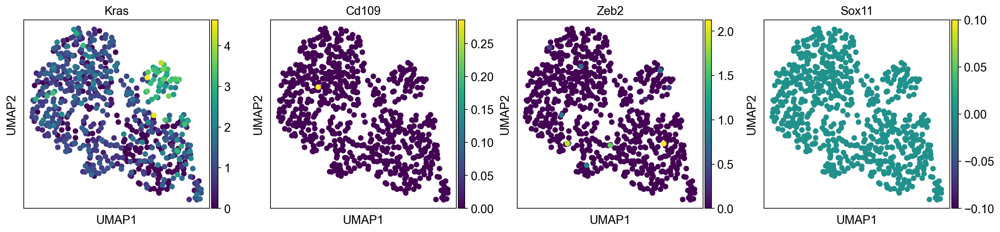

In [156]:
sc.pl.umap(adata, color=['Kras', 'Cd109', 'Zeb2', 'Sox11'])

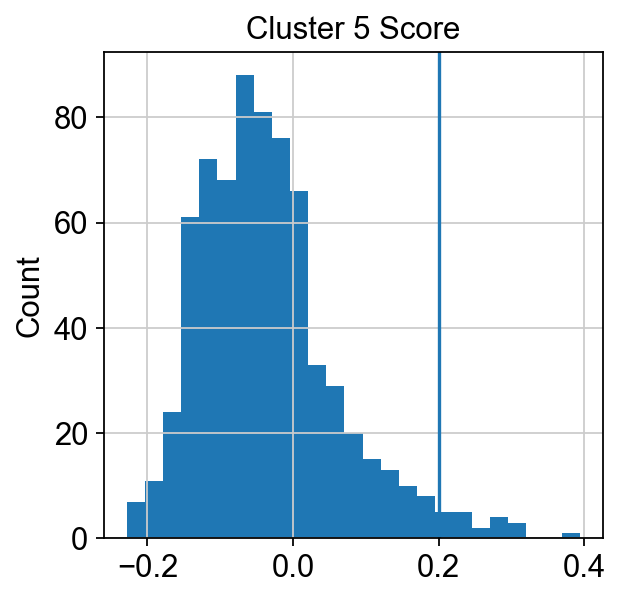

In [157]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.obs['Cluster 5'], bins='auto')
plt.ylabel("Count")
plt.title("Cluster 5 Score")
plt.axvline(x=0.2)
plt.show()

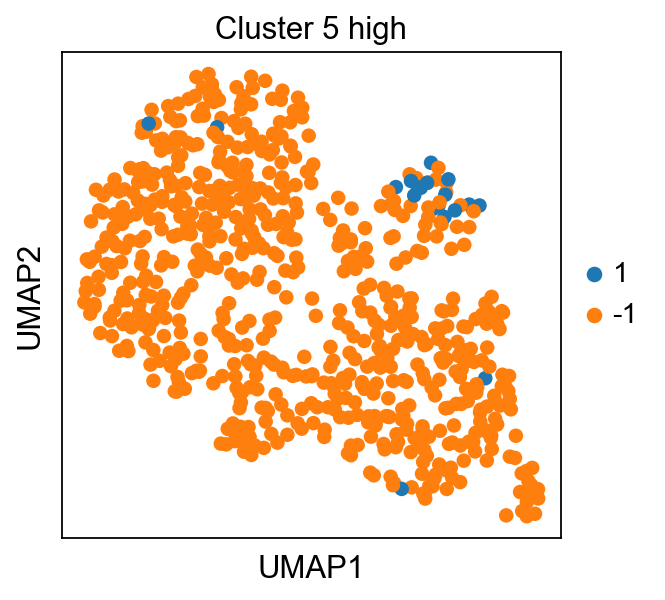

In [158]:
adata.obs['Cluster 5 high'] = ['1' if z >0.2 else '-1' for z in adata.obs['Cluster 5']]


sc.pl.umap(adata, color=['Cluster 5 high'], cmap="tab20c_r")

In [159]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p']['base'] = None

Save the result.

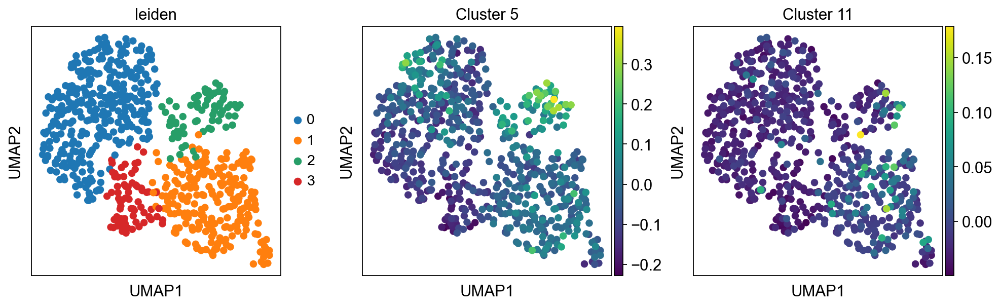

In [160]:
sc.pl.umap(adata, color=['leiden', 'Cluster 5', 'Cluster 11'])

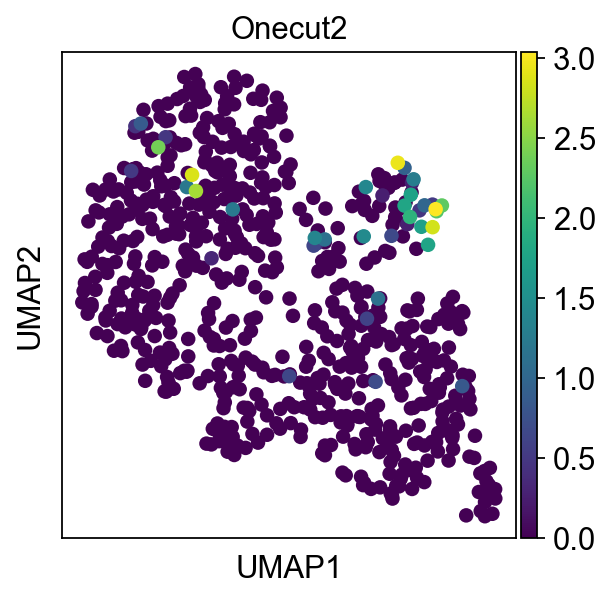

In [161]:
sc.pl.umap(adata, color=['Onecut2'])

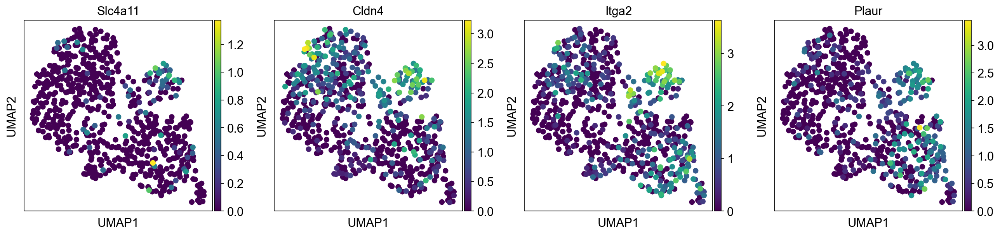

In [162]:
sc.pl.umap(adata, color=['Slc4a11','Cldn4','Itga2', 'Plaur']) #'Tigit',

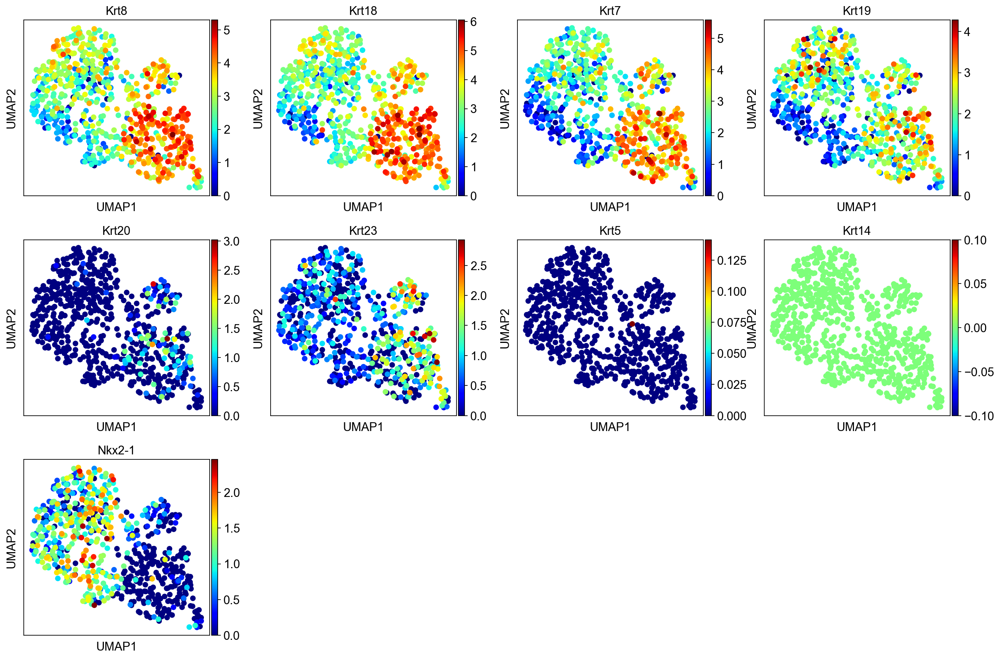

In [163]:
sc.pl.umap(adata, color=['Krt8','Krt18','Krt7','Krt19', 'Krt20', 'Krt23', 'Krt5', 'Krt14', 'Nkx2-1'], cmap="jet")

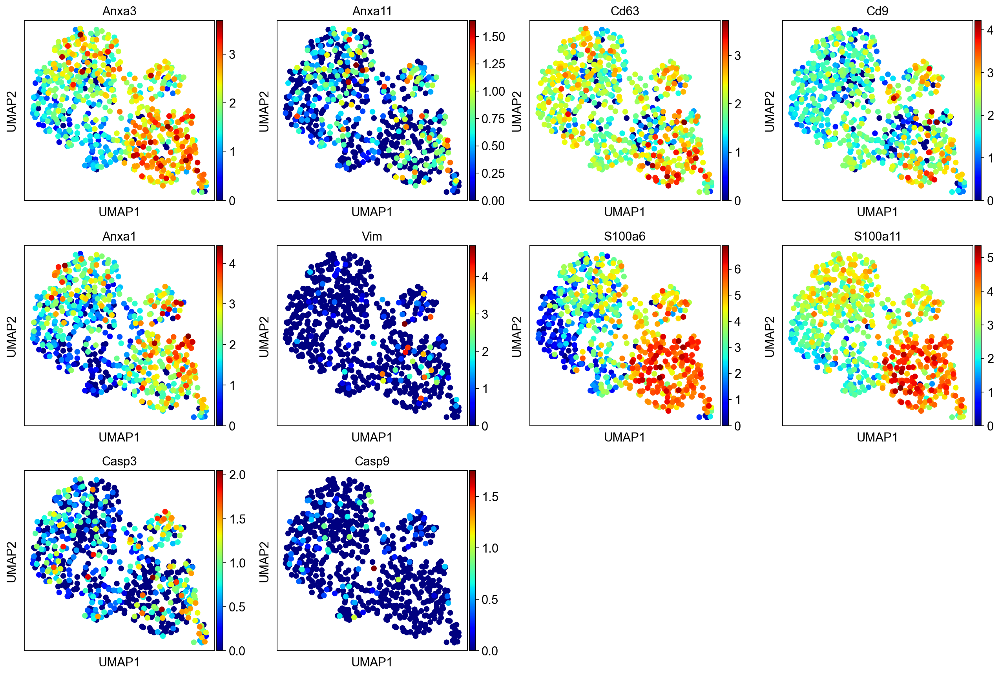

In [164]:
sc.pl.umap(adata, color=['Anxa3', 'Anxa11', 'Cd63','Cd9', 'Anxa1','Vim','S100a6','S100a11', 'Casp3', 'Casp9'], cmap="jet")

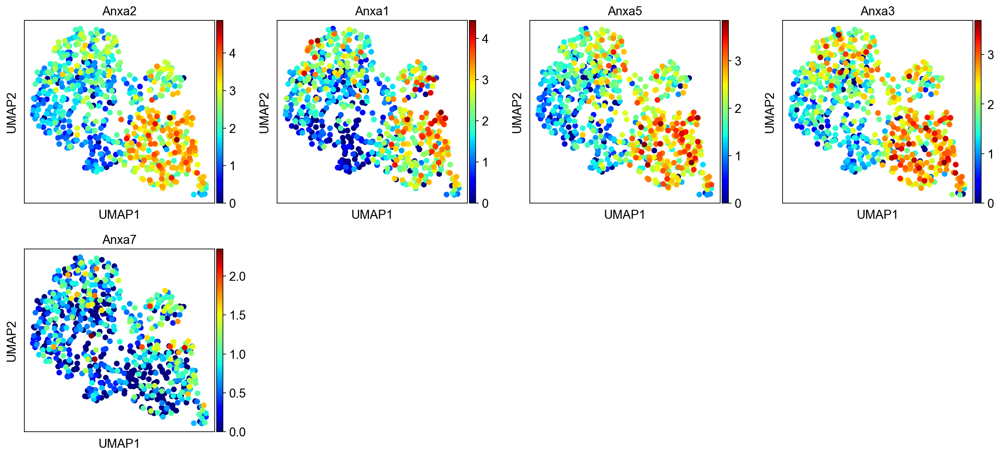

In [165]:
sc.pl.umap(adata, color=['Anxa2', 'Anxa1', 'Anxa5','Anxa3', 'Anxa7'], cmap="jet")

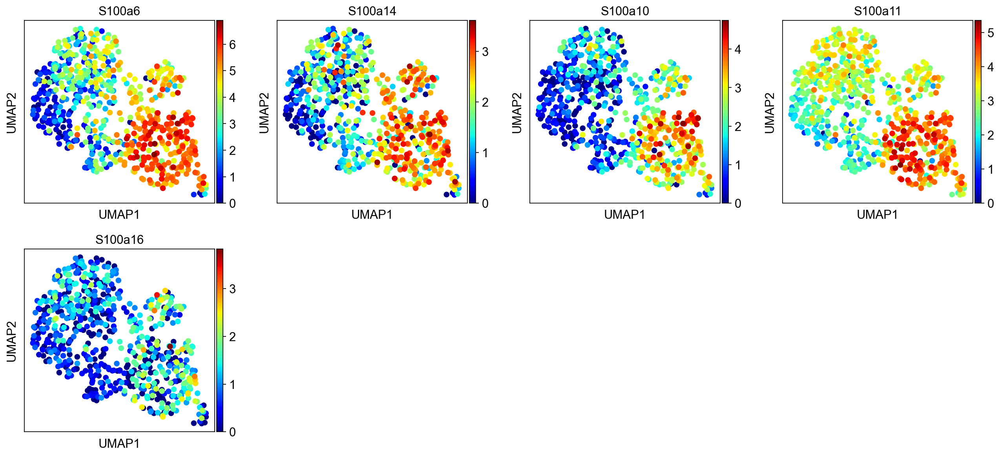

In [166]:
sc.pl.umap(adata, color=['S100a6','S100a14','S100a10','S100a11','S100a16'], cmap="jet")

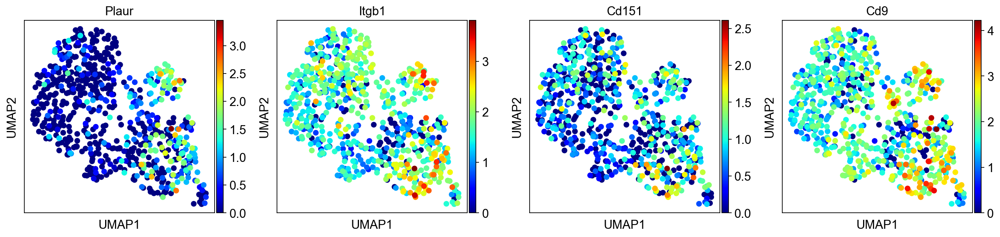

In [167]:
sc.pl.umap(adata, color=['Plaur','Itgb1','Cd151', 'Cd9'], cmap="jet")

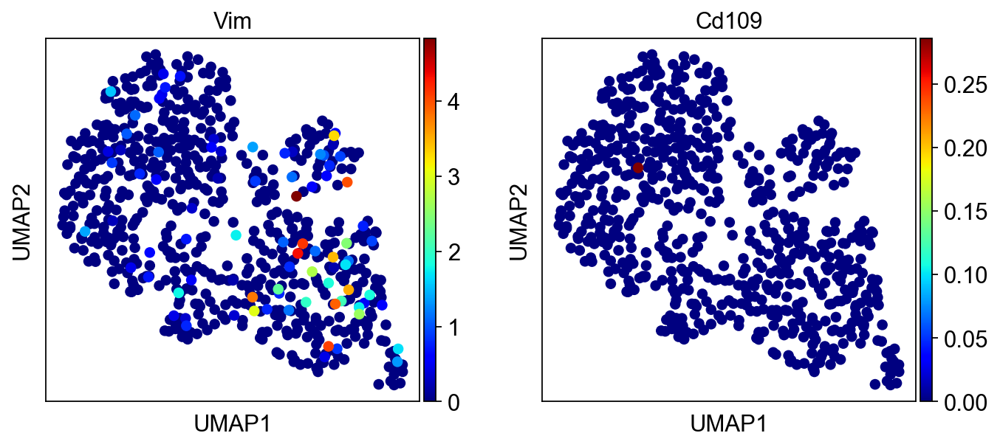

In [168]:
sc.pl.umap(adata, color=['Vim','Cd109'], cmap="jet")

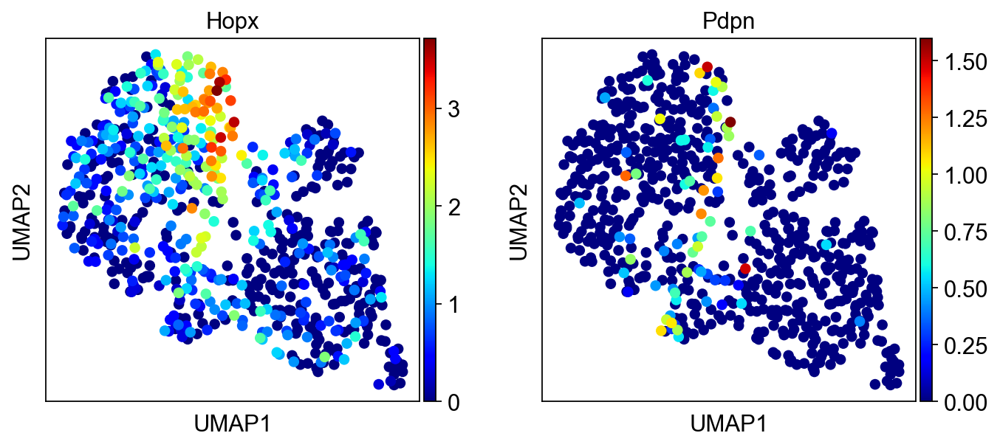

In [169]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], cmap="jet")

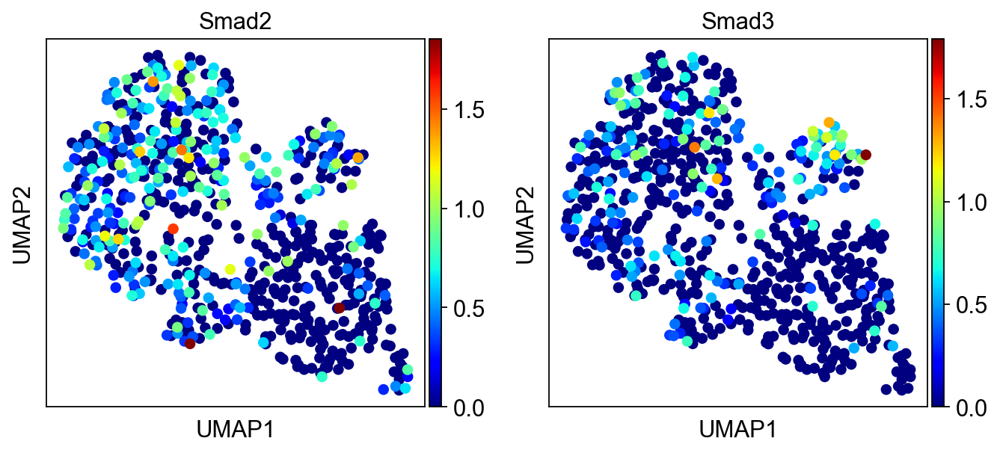

In [170]:
sc.pl.umap(adata, color=['Smad2', 'Smad3'], cmap="jet")

In [171]:
adata.write_h5ad(results_file)

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


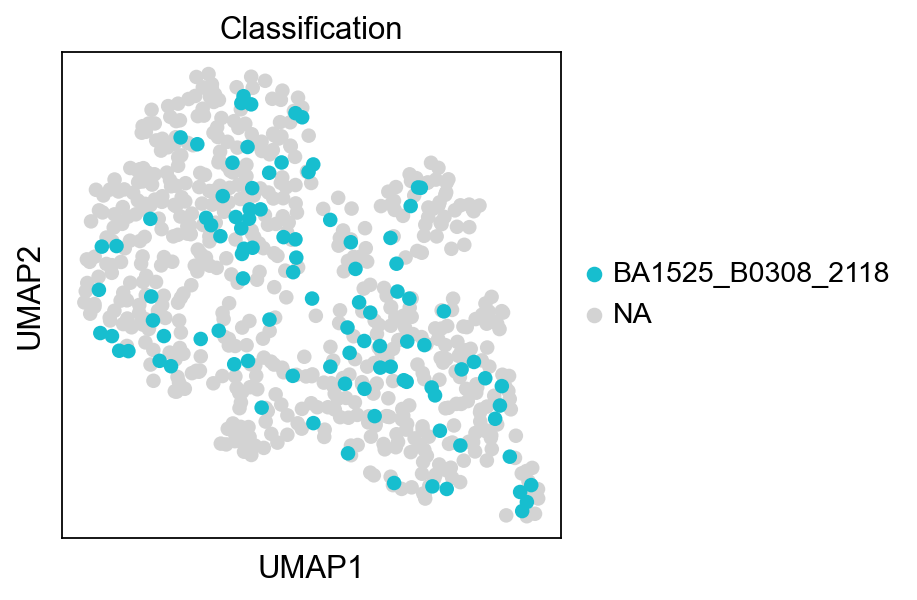

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


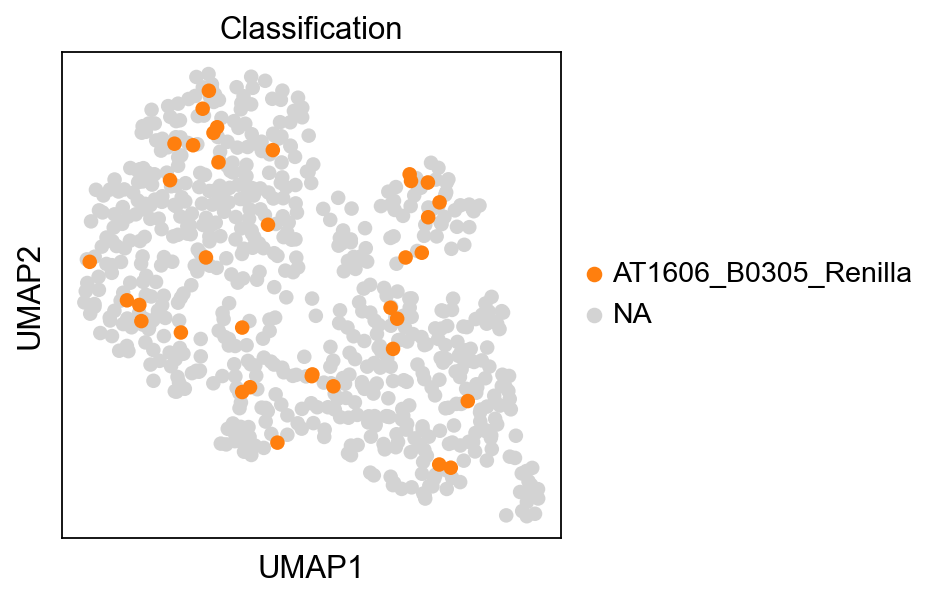

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


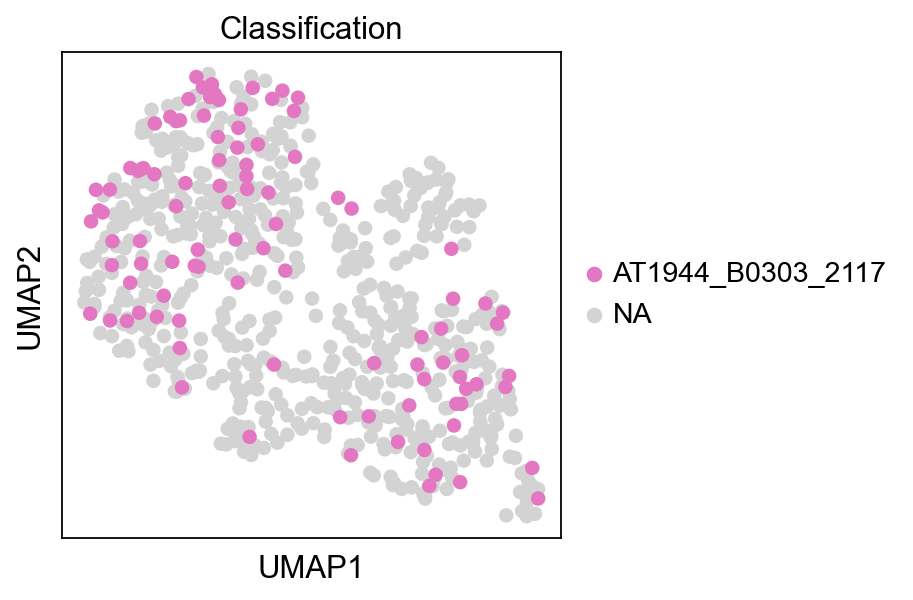

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


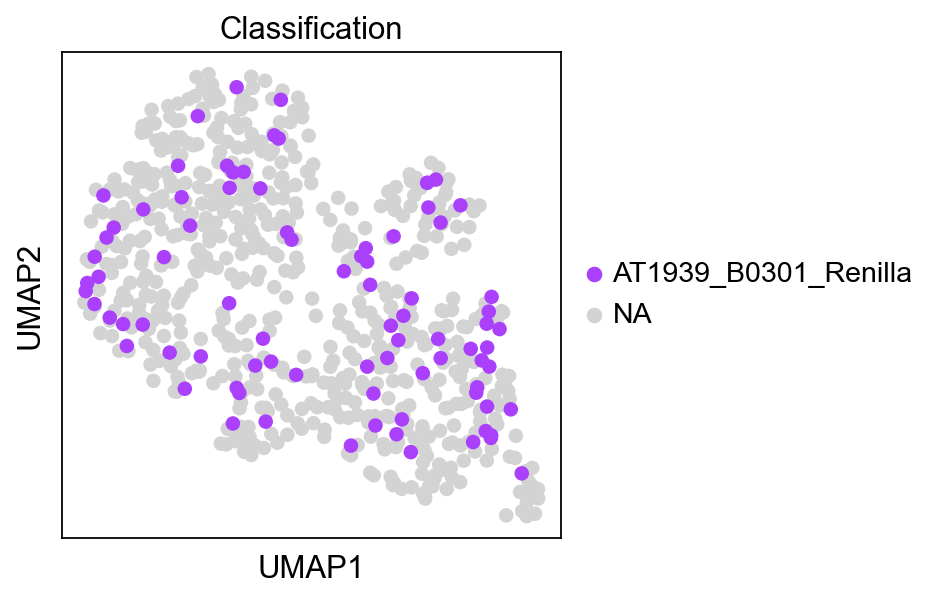

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


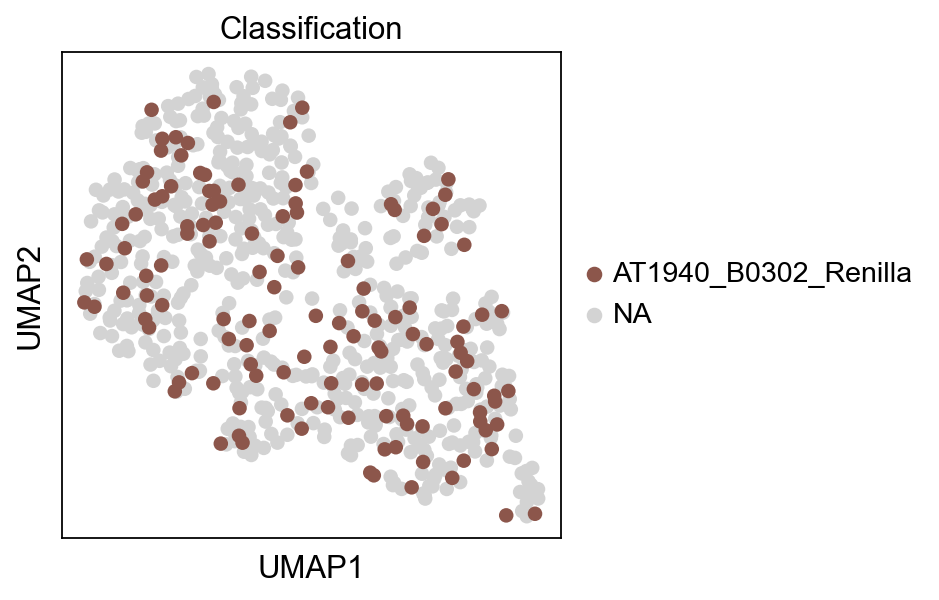

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


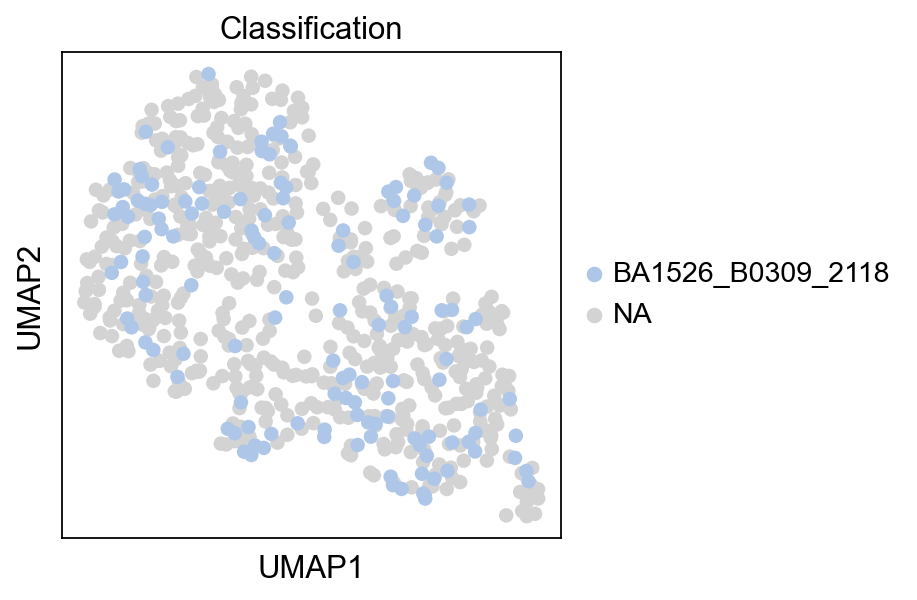

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


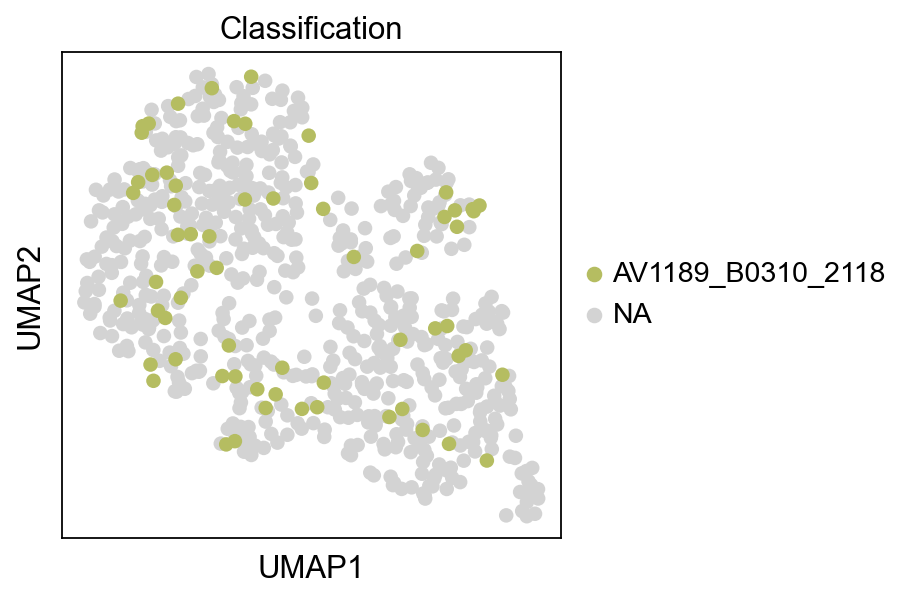

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


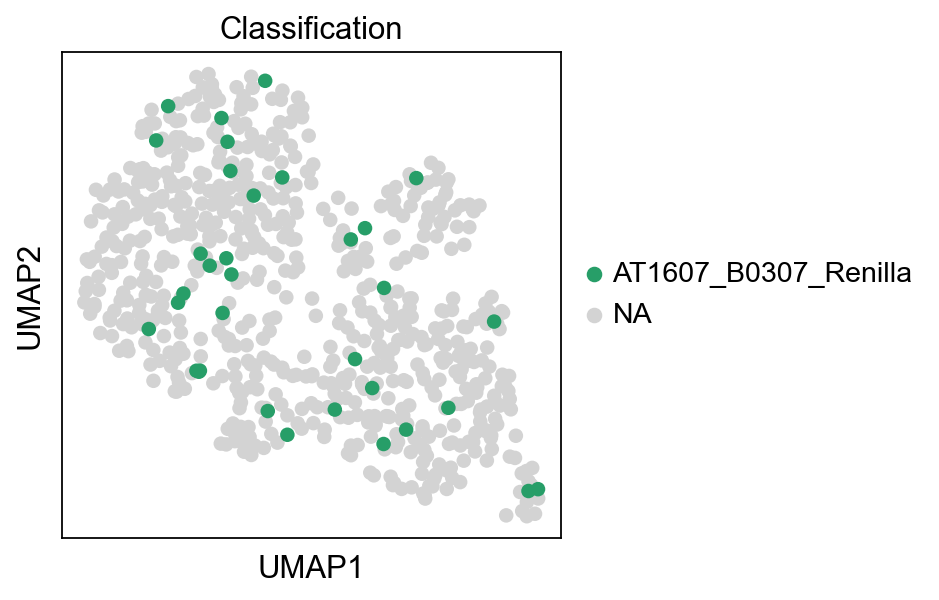

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


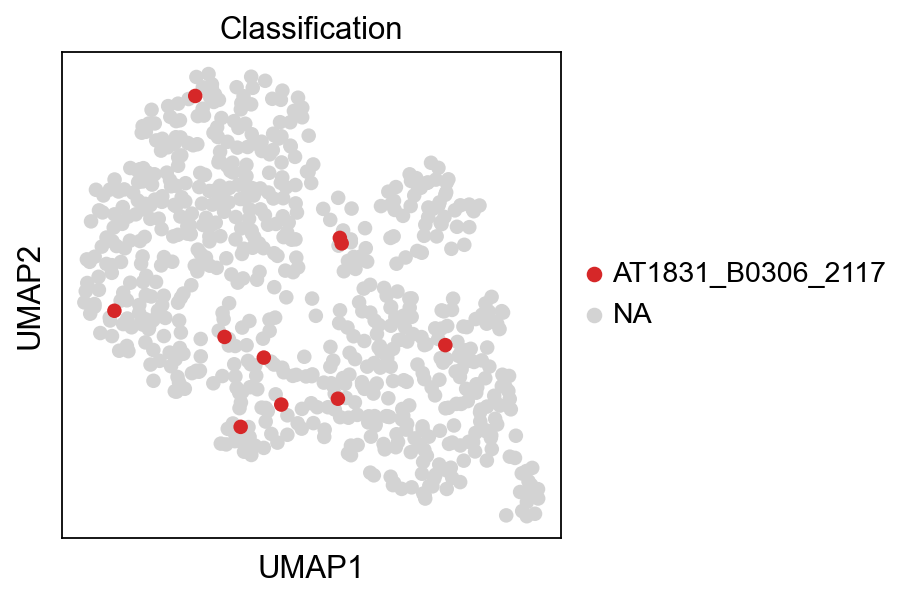

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


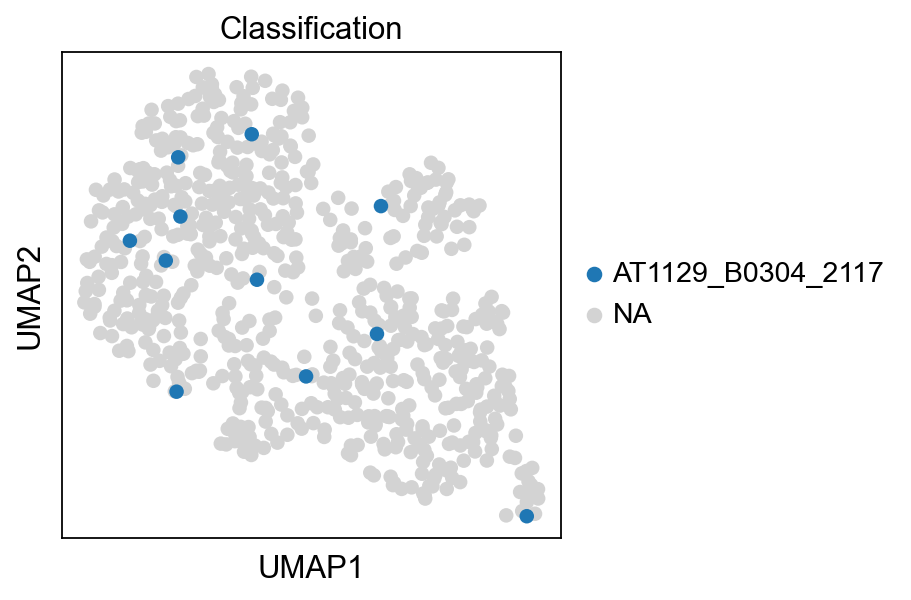

In [172]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [173]:
#Set shRNA groups
adata.obs['Group'] = 'Renilla'
adata.obs['Group'][adata.obs.Classification.isin(['AT1944_B0303_2117', 'AT1129_B0304_2117', 'AT1831_B0306_2117'])] = '2117'
adata.obs['Group'][adata.obs.Classification.isin(['BA1526_B0309_2118', 'BA1525_B0308_2118', 'AV1189_B0310_2118'])] = '2118'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/4022999393.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['Group'][adata.obs.Classification.isin(['AT1944_B0303_2117', 'AT1129_B0304_2117', 'AT1831_B0306_2117'])] = '2117'
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/4022999393.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['Group'][adata.obs.Classification.isin(['BA1526_B0309_2118', 'BA1525_B0308_2118', 'AV1189_B0310_2118'])] = '2118'


In [174]:
sc.tl.embedding_density(adata,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


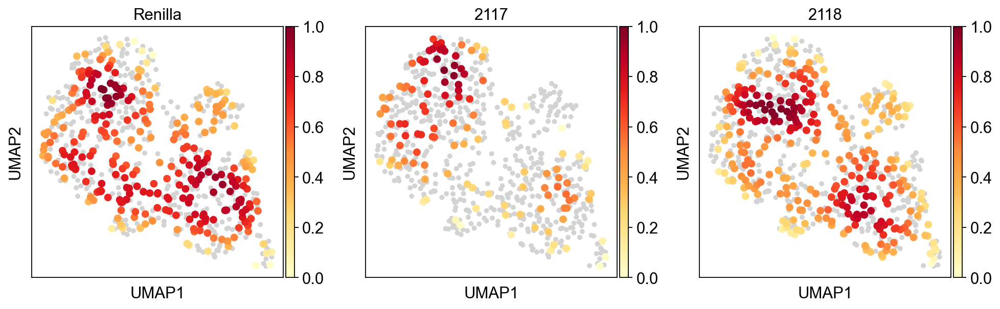

In [175]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Group', group=['Renilla','2117','2118'])

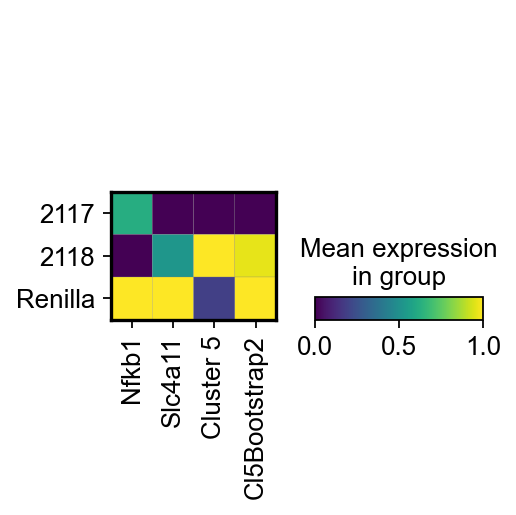

In [176]:
sc.pl.matrixplot(adata, ['Nfkb1','Slc4a11','Cluster 5','Cl5Bootstrap2'], groupby='Group', standard_scale='var')

In [177]:
adata.obs.Group.value_counts()

2118       300
Renilla    282
2117       120
Name: Group, dtype: int64

In [178]:
import pickle
with open('write/cellwhitelist-lane1.pickle', 'wb') as f:
    # Pickle the 'data' dictionary using the highest protocol available.
    pickle.dump(tuple(adata.obs.index), f, pickle.HIGHEST_PROTOCOL)

In [179]:
internalhash = None
with open('CellRanger output/hashIDs.pickle', 'rb') as f:
    internalhash = pickle.load(f)
internalhash

""


In [180]:
nadata = adata[internalhash.index,:]

In [181]:
classify = np.load('CellRanger output/classification.npy', allow_pickle=True)

In [182]:
nadata.obs["shRNA"] = classify
nadata.obs["shRNA"].value_counts()

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_8861/3285749934.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  nadata.obs["shRNA"] = classify


Series([], Name: shRNA, dtype: int64)

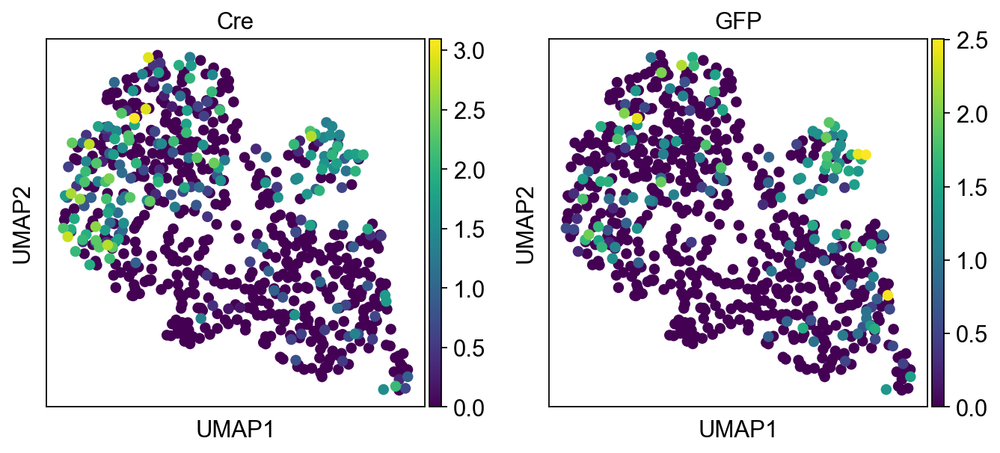

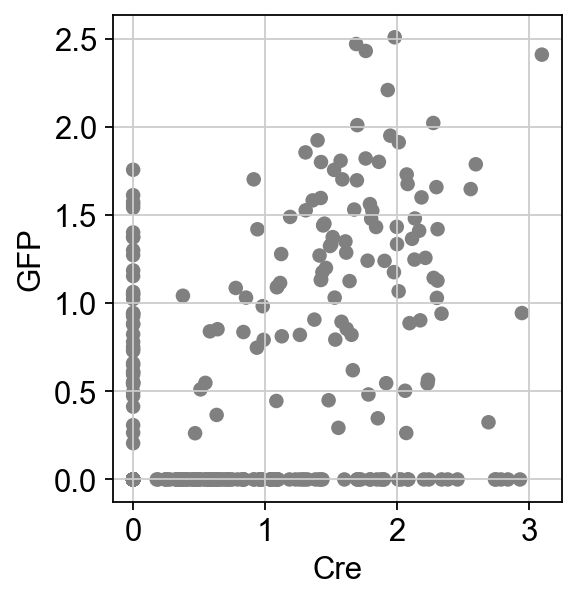

In [183]:
sc.pl.umap(adata, color=['Cre','GFP'])
sc.pl.scatter(adata, x='Cre', y='GFP')

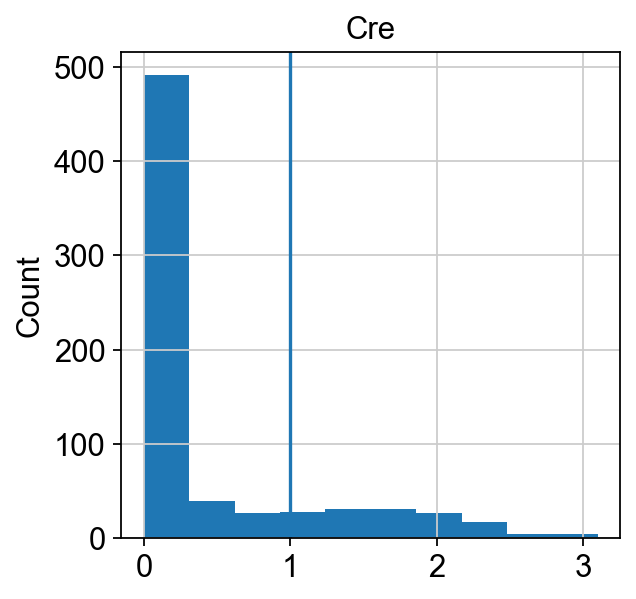

In [184]:
import matplotlib.pyplot as plt
#Remove any cell with PTPRC counts
adata.var.index.isin(['Cre'])
_ = plt.hist(adata.raw.to_adata()[adata.obs.index,'Cre'].X.toarray())
plt.ylabel("Count")
plt.title("Cre")
plt.axvline(x=1)
plt.show()

## Cre Cells

In [185]:
#PtprcCells = adata[adata.X[:,adata.var.index.isin(['Ptprc'])] >= 0.5,:].obs.index
CreCells = adata[adata.obs['Cre_count'] >= 2,:].obs.index

In [186]:
nadata2 = adata[CreCells,:]
nadata2

View of AnnData object with n_obs × n_vars = 154 × 4284
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Renilla', '2117-Nfkb1', '2118-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA', 'score', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'Cl5Bootstrap2', 'umap_density_Classification', 'umap_density_shRNA', 'leiden', 'Cluster 5 high', 'Group', 'umap_density_Group'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'Classification_colors', 'umap_density_Classification_params', 'umap_density_shRNA_params', 'leiden', 'leiden_colors', 'Cluster 5 high_colors', 'umap_density_Group_params'

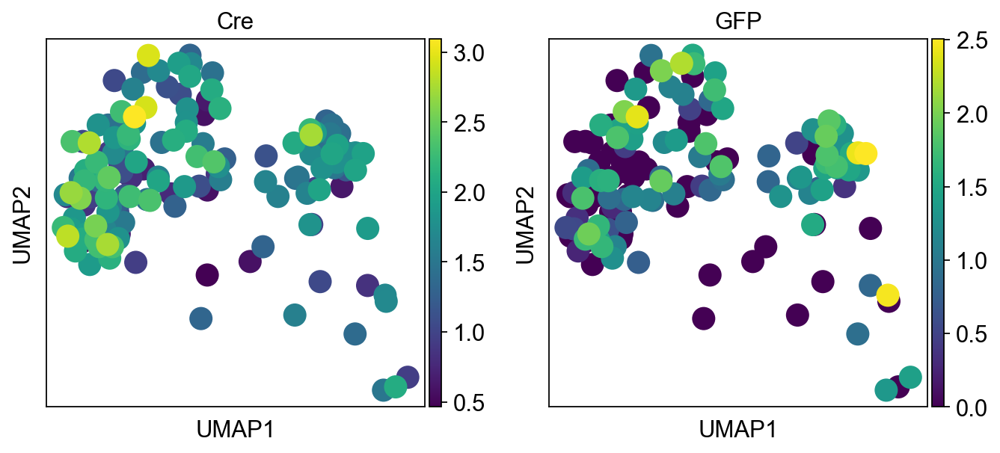

In [187]:
sc.pl.umap(nadata2, color=['Cre', 'GFP'])

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    746 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    649 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    797 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    799 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    700 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    846 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    500 total control genes are used. (0

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:175: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[score_name] = pd.Series(
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future 

    finished: added
    'Cluster 8', score of gene set (adata.obs).
    849 total control genes are used. (0:00:00)
computing score 'Cluster 9'
    finished: added
    'Cluster 9', score of gene set (adata.obs).
    548 total control genes are used. (0:00:00)
computing score 'Cluster 10'
    finished: added
    'Cluster 10', score of gene set (adata.obs).
    549 total control genes are used. (0:00:00)
computing score 'Cluster 11'
    finished: added
    'Cluster 11', score of gene set (adata.obs).
    549 total control genes are used. (0:00:00)
computing score 'Cluster 12'
    finished: added
    'Cluster 12', score of gene set (adata.obs).
    748 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and 

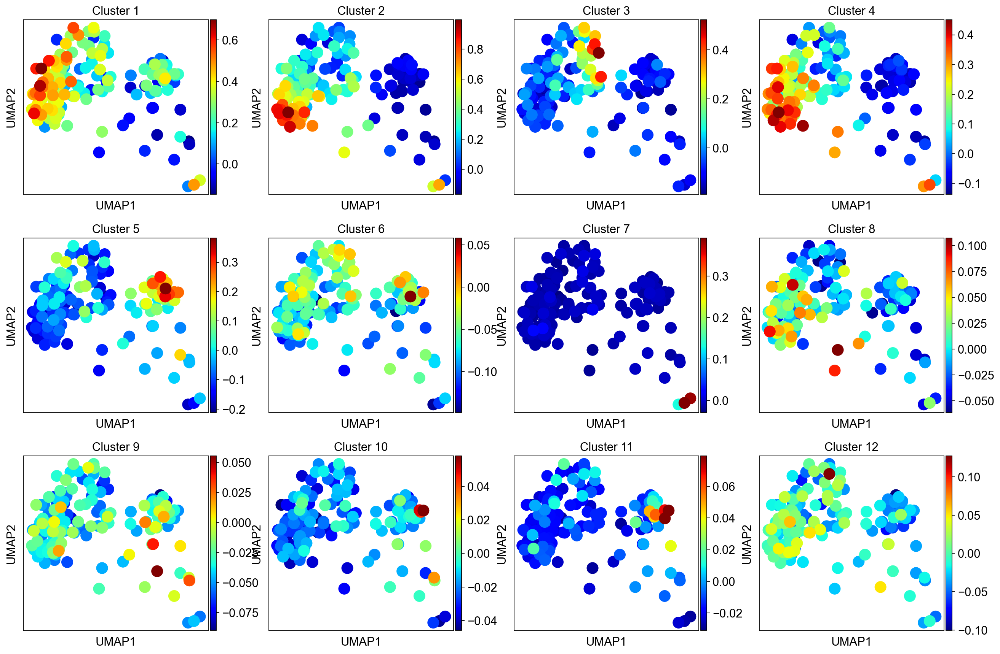

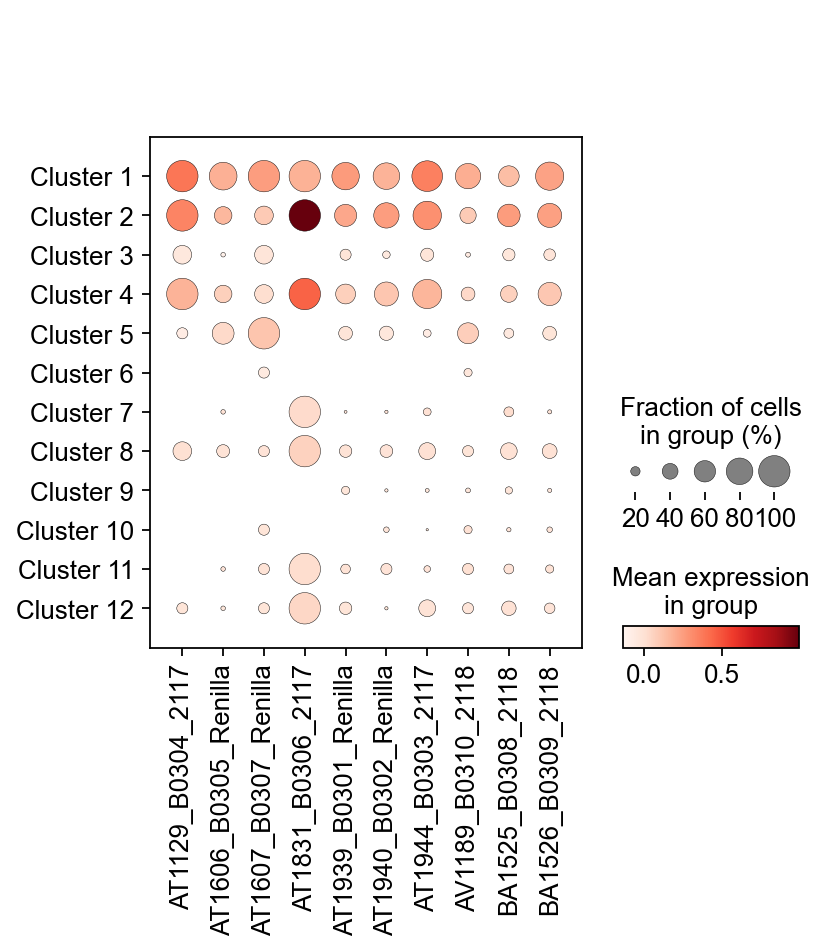

In [188]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(nadata2, numgenes=50)

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    391 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


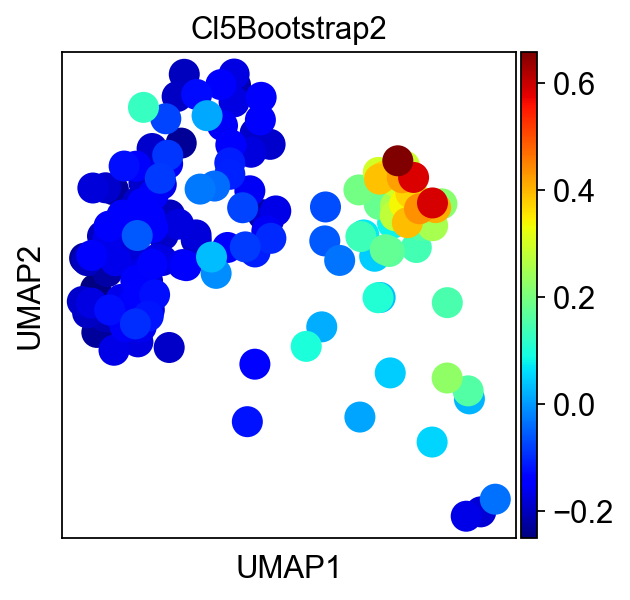

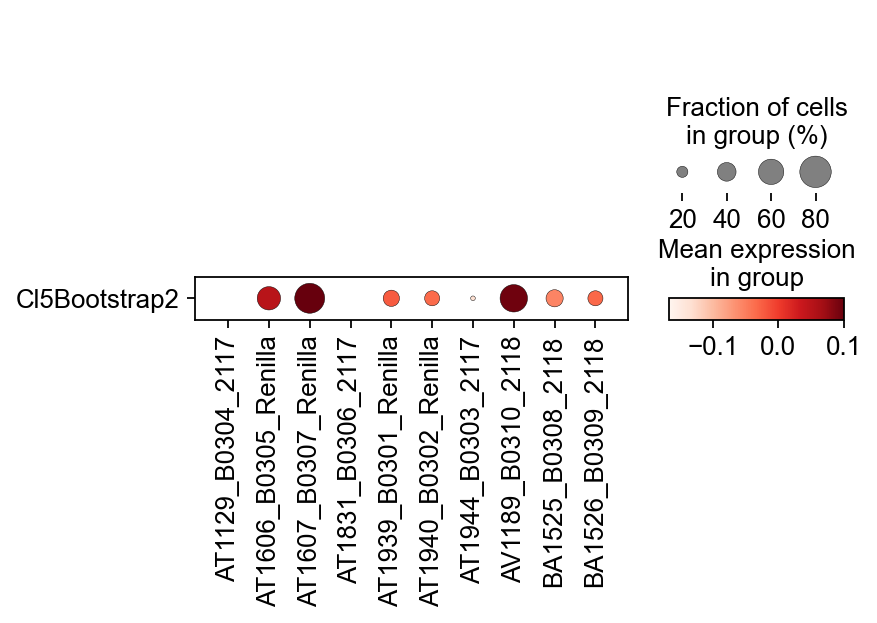

In [189]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(nadata2,numgenes=100)

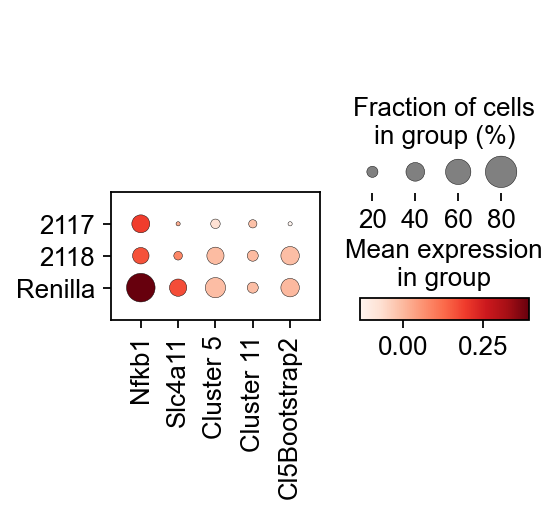

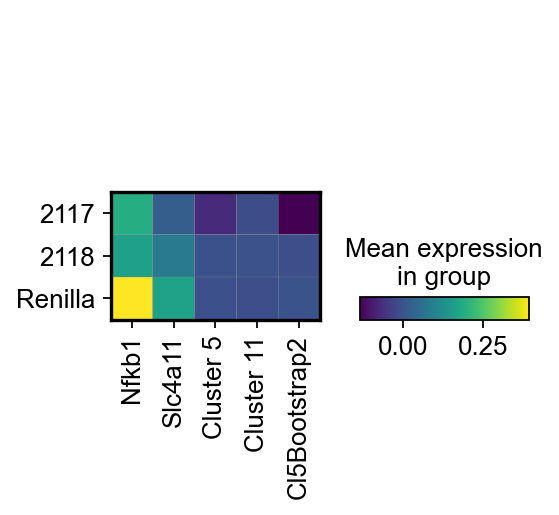

In [190]:
sc.pl.dotplot(nadata2, ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')
sc.pl.matrixplot(nadata2, ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')

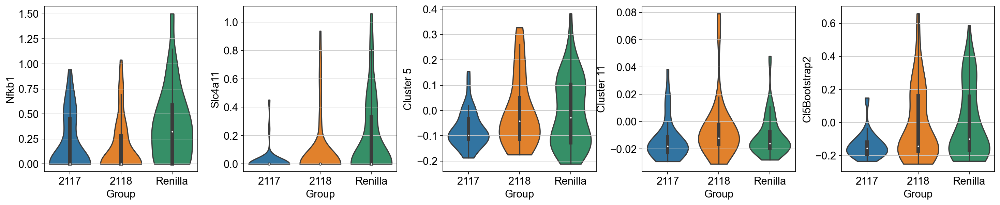

In [191]:
sc.pl.violin(nadata2, ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', inner='box',stripplot=False)

In [192]:
nadata2.obs.Group.value_counts()

Renilla    61
2118       56
2117       37
Name: Group, dtype: int64

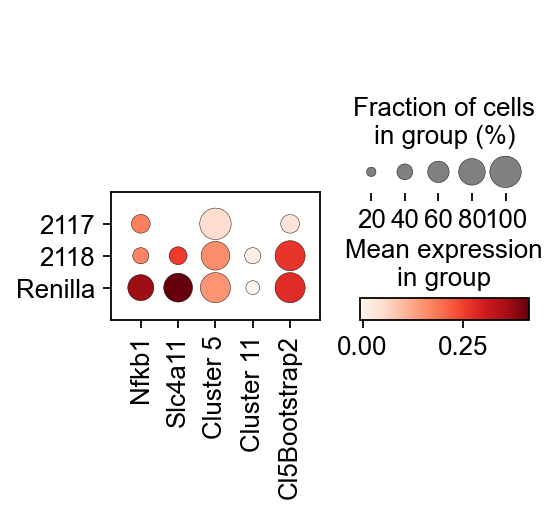

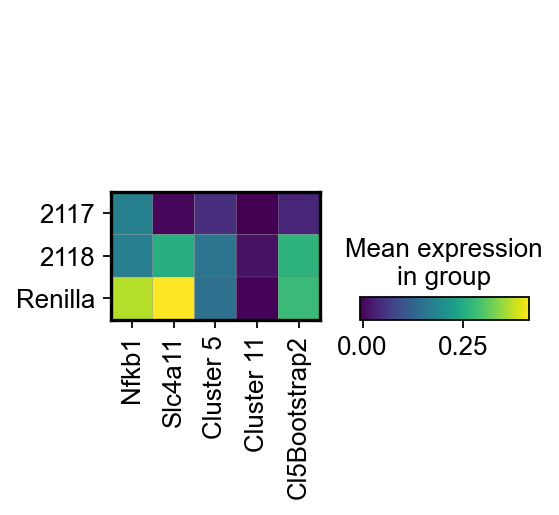

In [198]:
sc.pl.dotplot(nadata2[nadata2.obs.leiden.isin(['2']),:], ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')
sc.pl.matrixplot(nadata2[nadata2.obs.leiden.isin(['2']),:], ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')

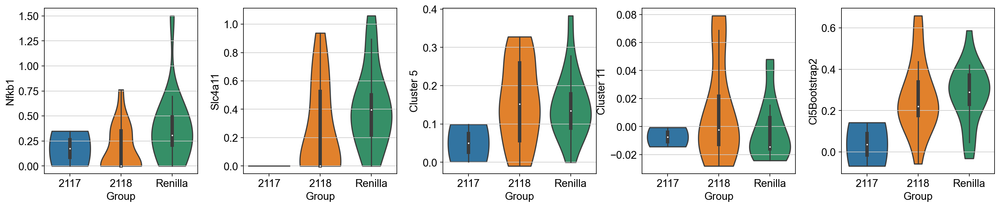

In [199]:
sc.pl.violin(nadata2[nadata2.obs.leiden.isin(['2']),:], ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', inner='box',stripplot=False)

In [201]:
nadata2[nadata2.obs.leiden.isin(['2']),:].obs.Group.value_counts()

Renilla    18
2118       17
2117        2
Name: Group, dtype: int64

## shRNA Directly Read Cells

In [202]:
adata2 = adata[adata.obs.shRNA.isin(['shRenilla','2117','2118']),:]

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    796 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    744 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    750 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    796 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    648 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    747 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    496 total control genes are used. (0

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:175: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[score_name] = pd.Series(
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future 

    finished: added
    'Cluster 9', score of gene set (adata.obs).
    498 total control genes are used. (0:00:00)
computing score 'Cluster 10'
    finished: added
    'Cluster 10', score of gene set (adata.obs).
    598 total control genes are used. (0:00:00)
computing score 'Cluster 11'
    finished: added
    'Cluster 11', score of gene set (adata.obs).
    597 total control genes are used. (0:00:00)
computing score 'Cluster 12'
    finished: added
    'Cluster 12', score of gene set (adata.obs).
    697 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and 

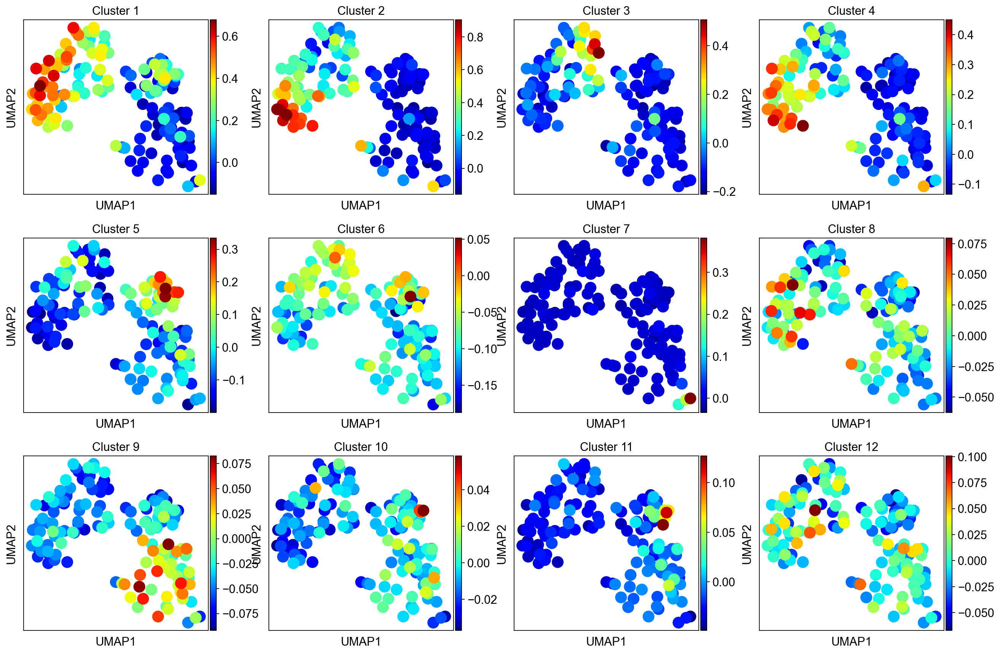

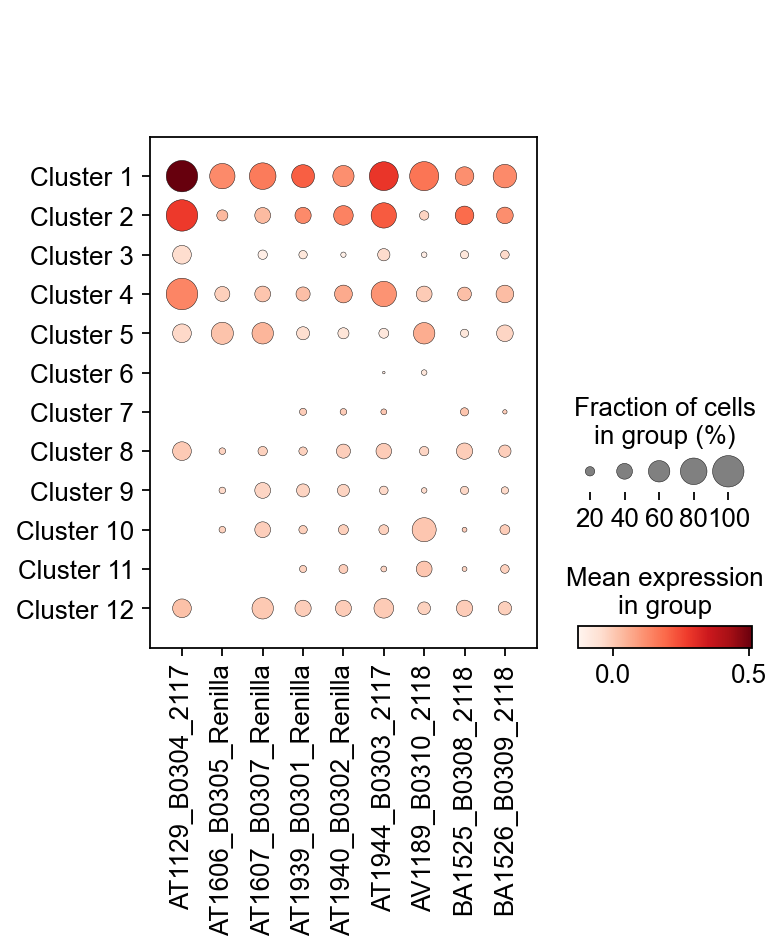

In [203]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata2, numgenes=50)

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    343 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


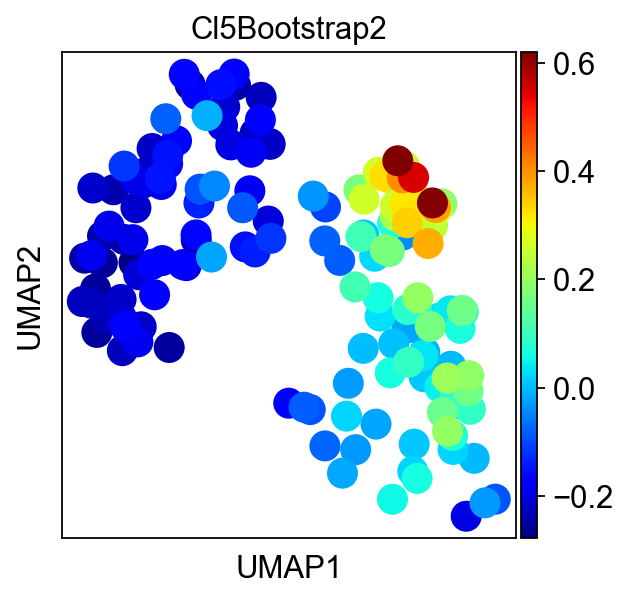

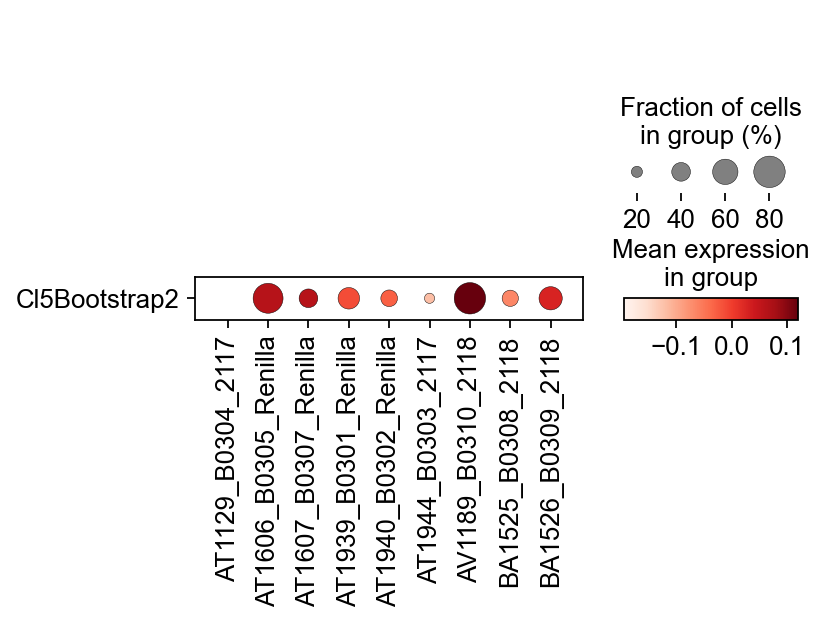

In [204]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(adata2,numgenes=100)

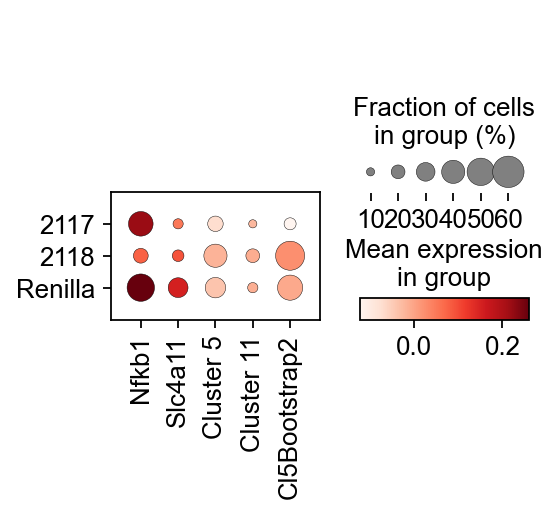

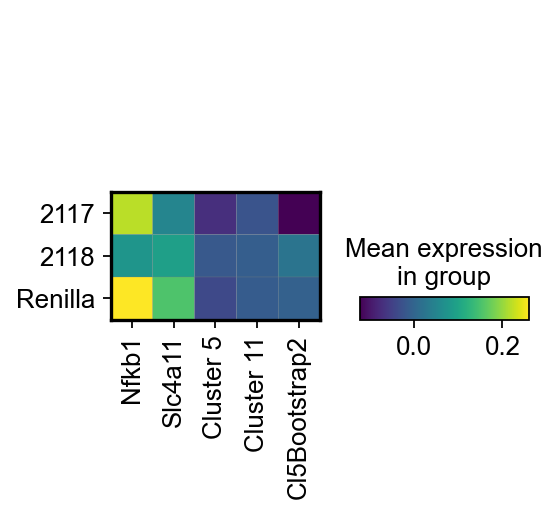

In [205]:
sc.pl.dotplot(adata2, ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')
sc.pl.matrixplot(adata2, ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')

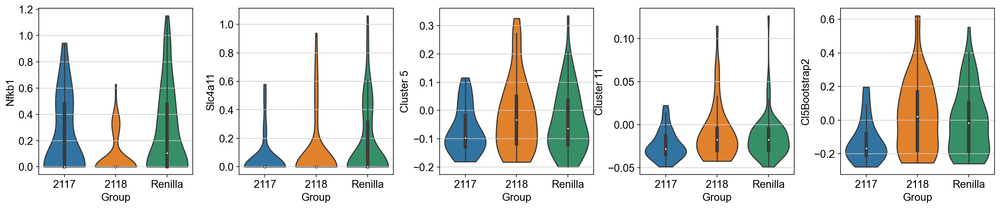

In [206]:
sc.pl.violin(adata2, ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', inner='box',stripplot=False)

In [207]:
adata2.obs.Group.value_counts()

Renilla    74
2118       50
2117       30
Name: Group, dtype: int64

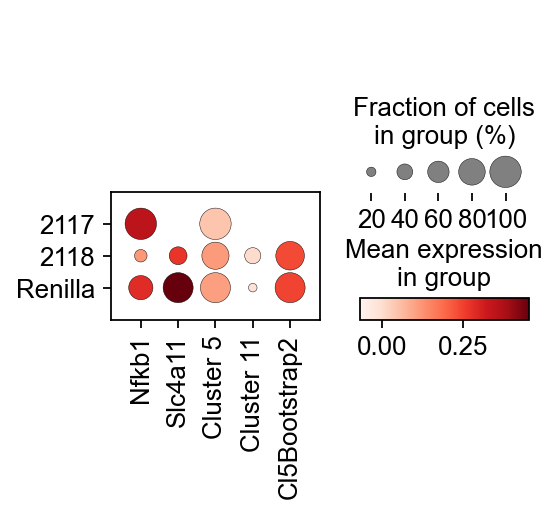

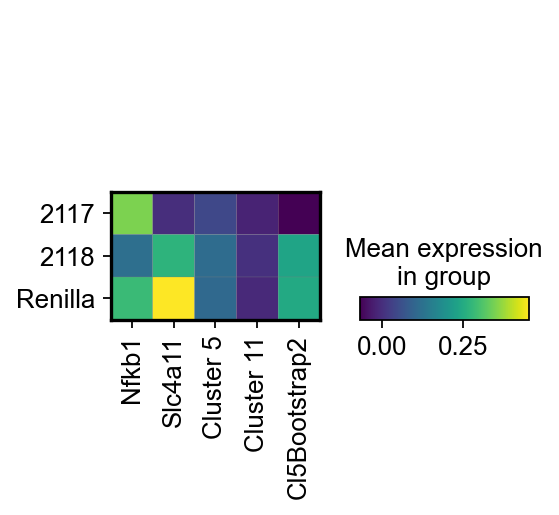

In [208]:
sc.pl.dotplot(adata2[adata2.obs.leiden.isin(['2']),:], ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')
sc.pl.matrixplot(adata2[adata2.obs.leiden.isin(['2']),:], ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')

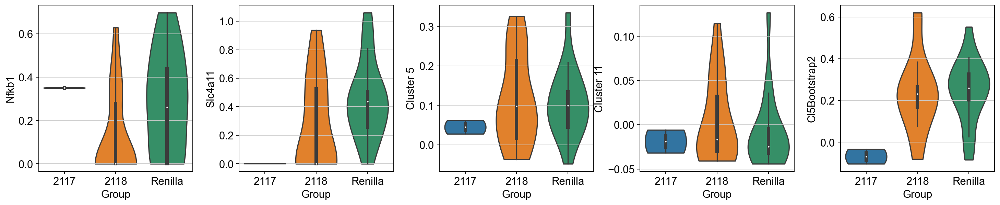

In [209]:
sc.pl.violin(adata2[adata2.obs.leiden.isin(['2']),:], ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', inner='box',stripplot=False)

In [210]:
adata2[adata2.obs.leiden.isin(['2']),:].obs.Group.value_counts()

2118       17
Renilla    17
2117        2
Name: Group, dtype: int64

## GFP Cells

In [211]:
#PtprcCells = adata[adata.X[:,adata.var.index.isin(['Ptprc'])] >= 0.5,:].obs.index
GFPCells = adata[adata.obs['GFP_count'] >=2, :].obs.index

In [212]:
adata3 = adata[GFPCells,:]
adata3

View of AnnData object with n_obs × n_vars = 107 × 4284
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'Renilla', '2117-Nfkb1', '2118-Nfkb1', 'GFP_count', 'Cre_count', 'shRNA', 'score', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'Cl5Bootstrap2', 'umap_density_Classification', 'umap_density_shRNA', 'leiden', 'Cluster 5 high', 'Group', 'umap_density_Group'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'Classification_colors', 'umap_density_Classification_params', 'umap_density_shRNA_params', 'leiden', 'leiden_colors', 'Cluster 5 high_colors', 'umap_density_Group_params'

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    748 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    749 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    800 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    745 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    697 total control genes are used. (0:00:00)
computing score 'Cluster 6'
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    796 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    finished: added
    'Cluster 7', score of gene set (adata.obs).
    399 total control genes are used. (0

/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:175: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[score_name] = pd.Series(
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future 

    finished: added
    'Cluster 11', score of gene set (adata.obs).
    500 total control genes are used. (0:00:00)
computing score 'Cluster 12'
    finished: added
    'Cluster 12', score of gene set (adata.obs).
    699 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


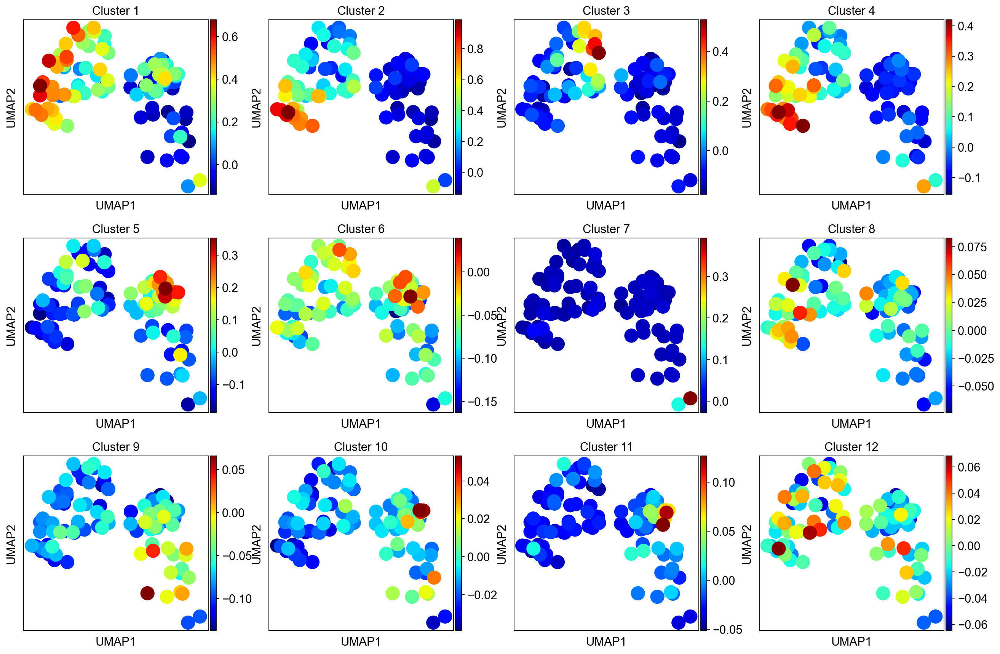

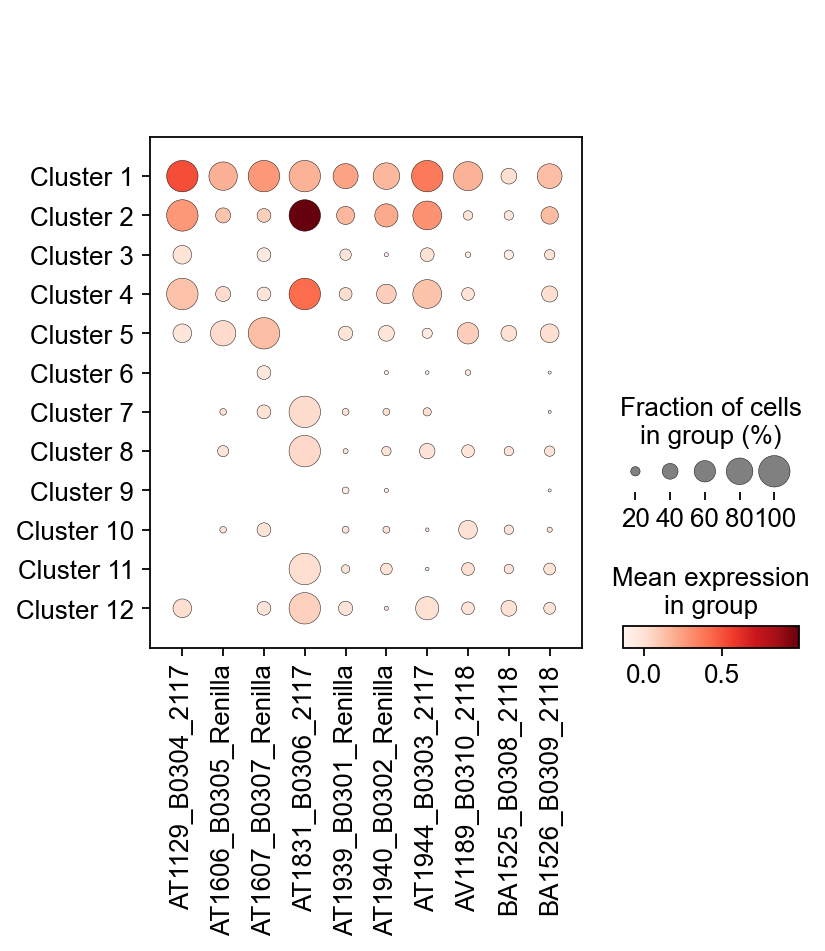

In [213]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata3, numgenes=50)

computing score 'Cl5Bootstrap2'
    finished: added
    'Cl5Bootstrap2', score of gene set (adata.obs).
    399 total control genes are used. (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


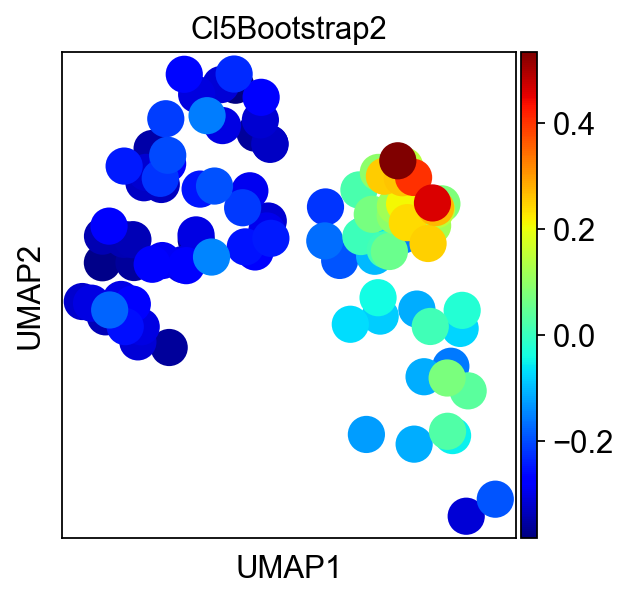

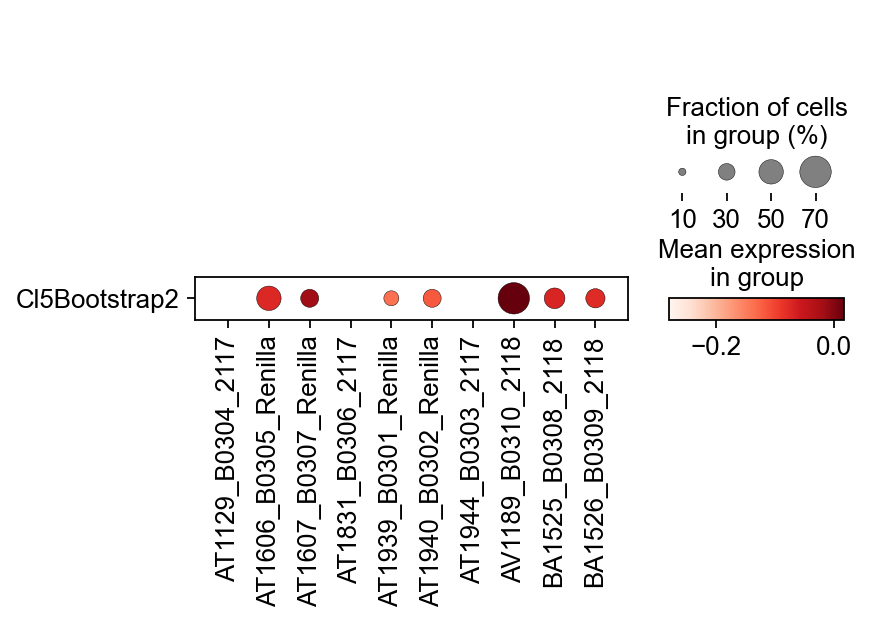

In [214]:
(clusters, clusterkeys, HPCS) = resetClusters('cl5bootstrap2')
scoreAndPlot(adata3,numgenes=100)

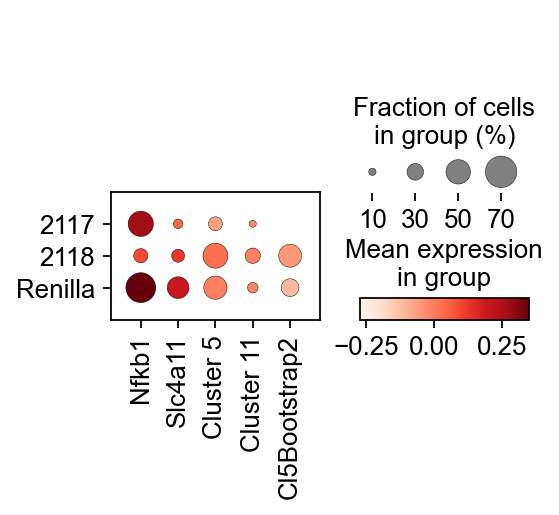

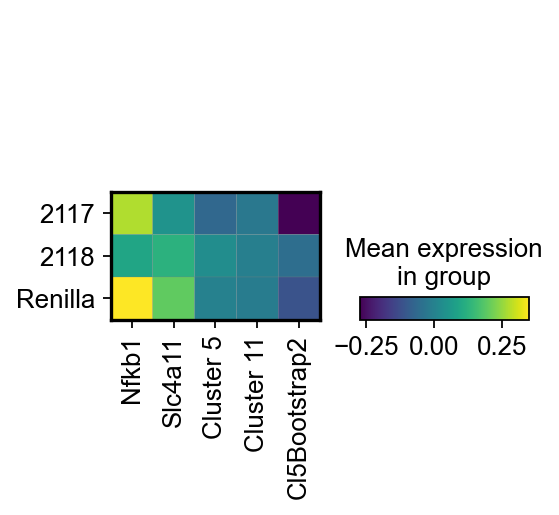

In [215]:
sc.pl.dotplot(adata3, ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')
sc.pl.matrixplot(adata3, ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')

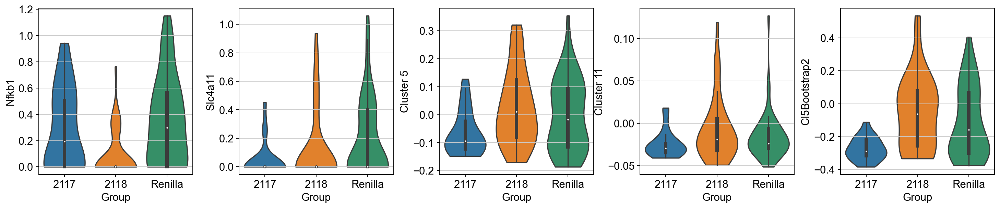

In [216]:
sc.pl.violin(adata3, ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', inner='box',stripplot=False)

In [217]:
adata3.obs.Group.value_counts()

Renilla    49
2118       37
2117       21
Name: Group, dtype: int64

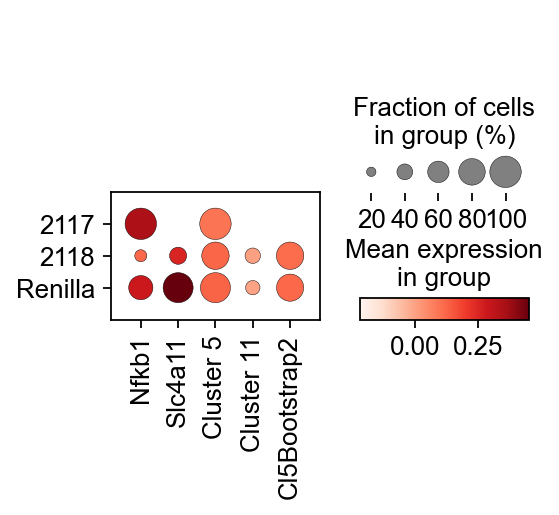

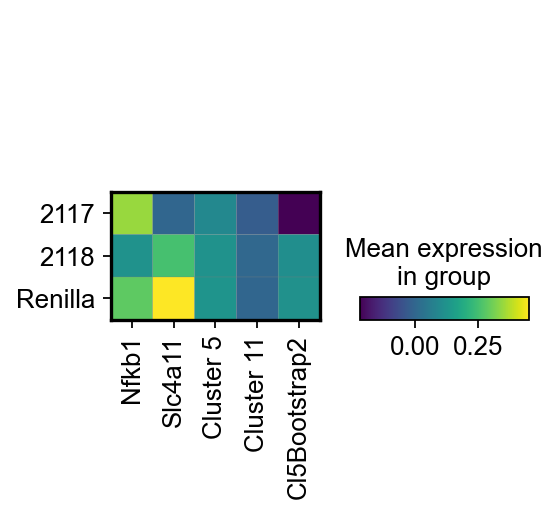

In [218]:
sc.pl.dotplot(adata3[adata3.obs.leiden.isin(['2']),:], ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')
sc.pl.matrixplot(adata3[adata3.obs.leiden.isin(['2']),:], ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group')

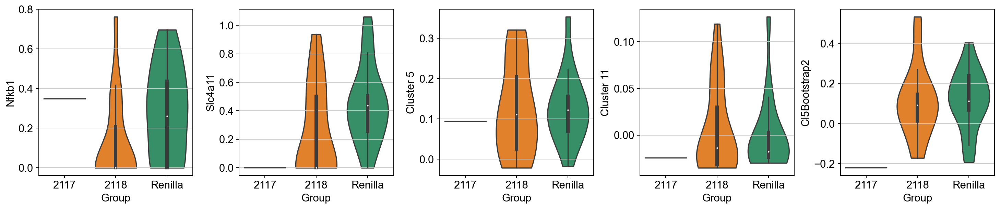

In [219]:
sc.pl.violin(adata3[adata3.obs.leiden.isin(['2']),:], ['Nfkb1','Slc4a11','Cluster 5','Cluster 11','Cl5Bootstrap2'], groupby='Group', inner='box',stripplot=False)

In [220]:
adata3[adata3.obs.leiden.isin(['2']),:].obs.Group.value_counts()

2118       18
Renilla    17
2117        1
Name: Group, dtype: int64

## Finding marker genes

Let us compute a ranking for the highly differential genes in each cluster. For this, by default, the `.raw` attribute of AnnData is used in case it has been initialized before. The simplest and fastest method to do so is the t-test.

In [221]:
# bug fix
adata.uns['log1p']['base'] = None

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


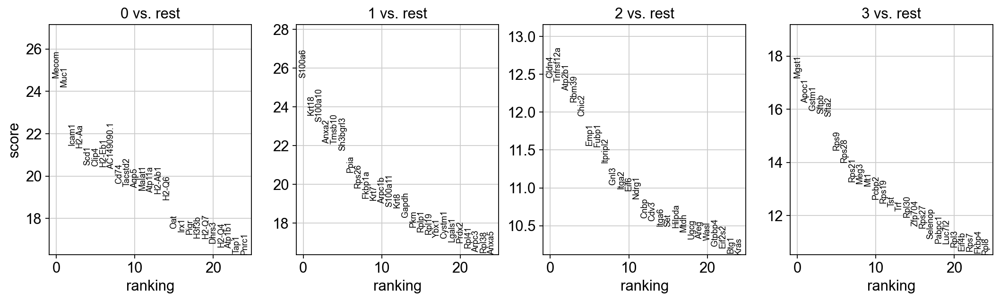

In [222]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [223]:
sc.settings.verbosity = 2  # reduce the verbosity

The result of a [Wilcoxon rank-sum (Mann-Whitney-U)](https://en.wikipedia.org/wiki/Mann%E2%80%93Whitney_U_test) test is very similar. We recommend using the latter in publications, see e.g., [Sonison & Robinson (2018)](https://doi.org/10.1038/nmeth.4612). You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.

ranking genes
    finished (0:00:01)


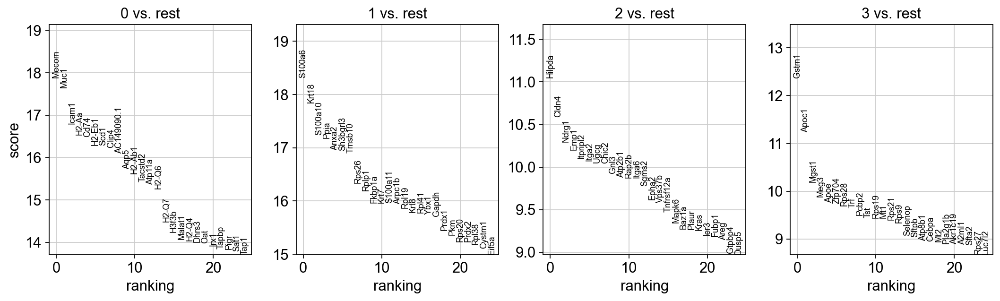

    using 'X_pca' with n_pcs = 150
Storing dendrogram info using `.uns['dendrogram_leiden']`


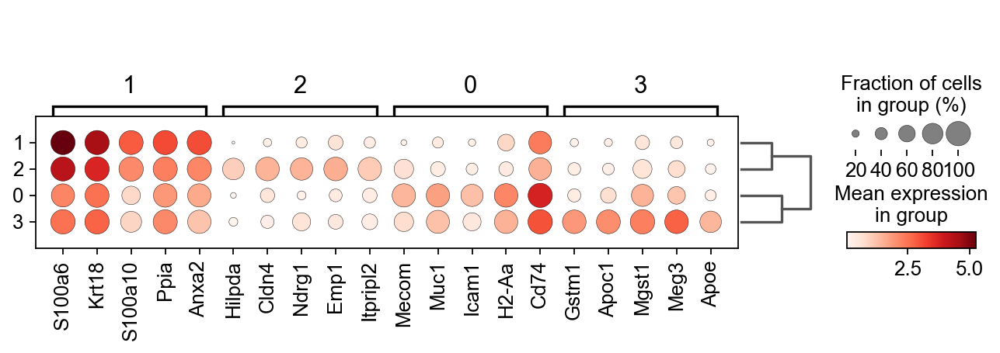

In [224]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby="leiden")


Save the result.

In [225]:
adata.write(results_file, compression='gzip')

As an alternative, let us rank genes using logistic regression. For instance, this has been suggested by [Natranos et al. (2018)](https://doi.org/10.1101/258566). The essential difference is that here, we use a multi-variate appraoch whereas conventional differential tests are uni-variate. [Clark et al. (2014)](https://doi.org/10.1186/1471-2105-15-79) has more details.

ranking genes
    finished (0:00:04)


/Users/chanj2/opt/miniconda3/envs/scanalysis202208/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


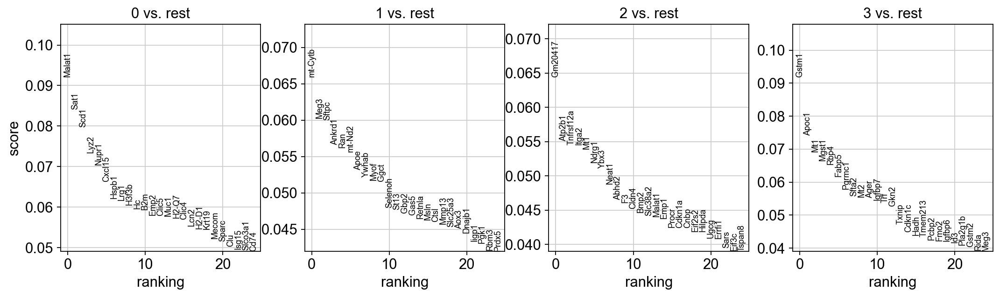

In [226]:
sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

Reload the object that has been save with the Wilcoxon Rank-Sum test result.

In [227]:
adata = sc.read(results_file)

#Export for SCENIC analysis
adata.write_h5ad("write/postSCT-tumor-leiden.h5ad",compression='gzip')
adata = sc.read("write/postSCT-tumor-leiden.h5ad")

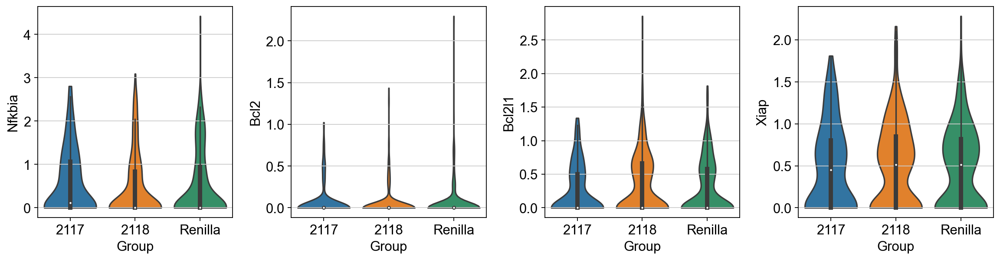

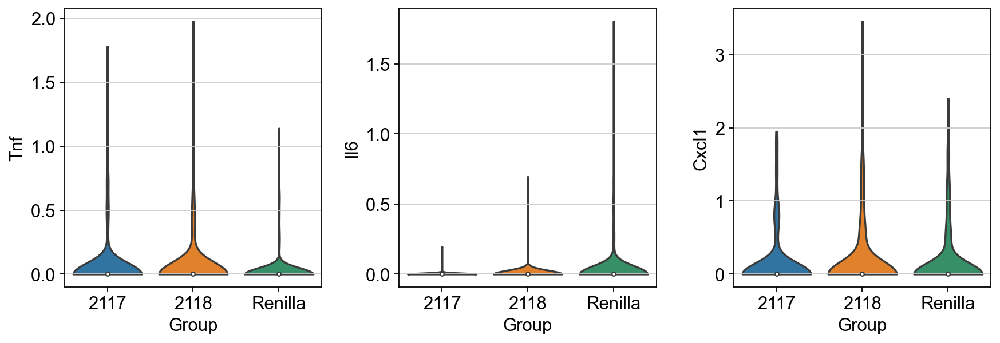

In [228]:
nfkbgenes = ['Nfkbia', 'Bcl2', 'Bcl2l1','Xiap', ]
inflammatory = ['Tnf', 'Il6', 'Cxcl1', 'Il6']

sc.pl.violin(adata, nfkbgenes, groupby='Group', inner='box',stripplot=False)
sc.pl.violin(adata, inflammatory, groupby='Group', inner='box',stripplot=False)

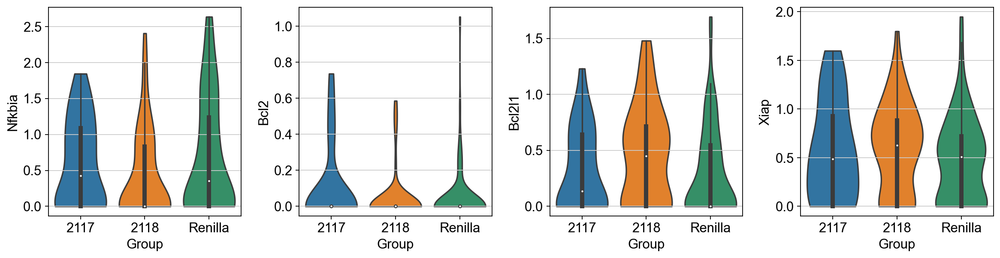

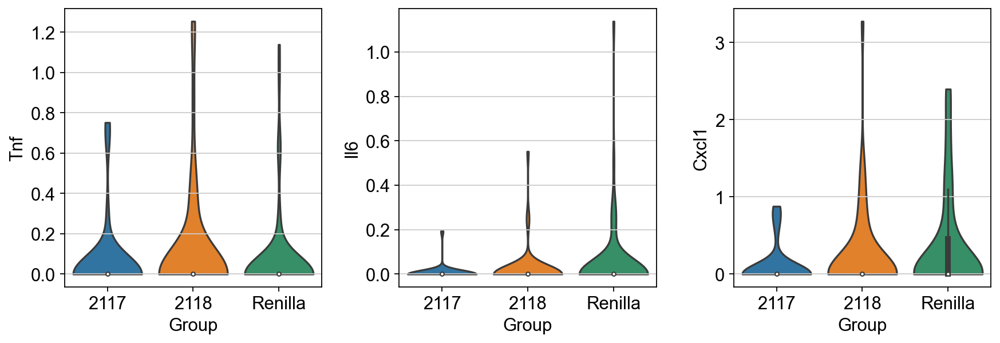

In [229]:
sc.pl.violin(adata2, nfkbgenes, groupby='Group', inner='box',stripplot=False)
sc.pl.violin(adata2, inflammatory, groupby='Group', inner='box',stripplot=False)